In [1]:
import logging
logging.getLogger('matplotlib.font_manager').setLevel(logging.ERROR)
import palantir
import scanpy as sc
import scvelo as scv
import cellrank as cr
import scvi
import phate
import plotly.express as px
import numpy as np
from dash import Dash, dcc, html, Input, Output
scvi.settings.seed = 1995

import pandas as pd

import os
import sys
os.environ['R_HOME'] = sys.exec_prefix+"/lib/R/"

# Plotting
import matplotlib
import matplotlib.pyplot as plt
import matplotlib as mpl

from copy import copy
reds = copy(mpl.cm.Reds)
reds.set_under("lightgray")

def matplotlib_to_plotly(cmap, pl_entries):
    h = 1.0/(pl_entries-1)
    pl_colorscale = []

    for k in range(pl_entries):
        C = list(map(np.uint8, np.array(cmap(k * h)[:3]) * 255))
        pl_colorscale.append([k*h, 'rgb'+str((C[0], C[1], C[2]))])

    return pl_colorscale

plotly_reds = matplotlib_to_plotly(reds, 255)
plotly_reds[0] = [0.0, 'rgb(211, 211, 211)']
sc.set_figure_params(dpi=50,figsize=[6,4])

# Inline plotting
%matplotlib inline

project_directory = '/Cranio_Lab/Louk_Seton/mesenchyme_project_2023'
os.chdir(os.path.expanduser("~")+project_directory)

Global seed set to 1995


In [2]:
###custom functions
import time
from anndata import AnnData

from typing import TYPE_CHECKING, Literal, get_args
_Method = Literal["logreg", "t-test", "wilcoxon", "t-test_overestim_var"]
def plot_deg_embedding(
    adata: AnnData,
    method: _Method,
    groupby: str = 'leiden',
    key_added: str | None = None,
    cluster_name: str = '0',
    n_genes: int = 100,
    basis: str = 'X_scvi_MDE',
) -> AnnData | None:
    avail_methods = set(get_args(_Method))
    if method not in avail_methods:
        raise ValueError(f"Method must be one of {avail_methods}.")
    
    if key_added is None:
        key_added = "rank_genes_groups_"+method
    
    sc.set_figure_params(dpi=50,figsize=[6,4]) #small figures otherwise your notebook will crash
    sc.tl.rank_genes_groups(adata, groupby = groupby, method=method, key_added = key_added)
    genes = adata.uns[key_added]['names'][cluster_name][:n_genes].tolist()
    sc.pl.embedding(adata,
                    basis=basis,
                    color=[groupby]+genes,
                    frameon=False,
                    groups=cluster_name,
                    ncols=4,
                    cmap = reds,
                    vmin=0.1,
                   )

from anndata import AnnData
def scvi_anndata_test(
    adata: AnnData,
    batch_key: str = 'batch',
    continuous_covariate_keys: list = ['S_score','G2M_score'],
    layer: str='original_counts',
    n_latent: int = 20,
    n_layers: int = 1,
    max_epochs: int = 500,
    n_neighbors: int = 15,
    resolution: int = 1,
    key_added: str | None = None,
    leiden_key: str = 'leiden_scvi',
) -> AnnData | None:
    if adata.is_view:  # we shouldn't need this here...
        adata._init_as_actual(adata.copy())
    
    if key_added is None:
        latent_key = "X_scvi"
        mde_key = "X_scvi_MDE"
    else:
        latent_key = key_added + "_scvi"
        mde_key = key_added + "_scvi_MDE"
    
    scvi.model.SCVI.setup_anndata(adata, #anndata object
                                  batch_key = batch_key, #categorical key for batch correction
                                  continuous_covariate_keys = continuous_covariate_keys,
                                                                #'total_counts',
                                                                #'pct_counts_mt',
                                                                #continuous key for cell cycle correction
                                  layer = layer) #layer with unmodified counts
    
    adata_model = scvi.model.SCVI(adata,
                                  n_latent = n_latent, #n_latent number of dimensions in latent space (think PCA but different)
                                  n_layers = n_layers, #n_layers number of layers in the neural network
                                 )
    
    print(adata_model.view_anndata_setup(adata))
    
    
    adata_model.train(
        max_epochs = max_epochs, #change how many runs it should train on
    )
    
    adata.obsm[latent_key] = adata_model.get_latent_representation()
    
    sc.pp.neighbors(adata,  #name of anndata object
                    n_neighbors = n_neighbors,
                    use_rep = latent_key,
                   )
    sc.tl.leiden(adata, #name of anndata object
                 resolution = resolution,
                 key_added = leiden_key
                )
    
    adata.obsm[mde_key] = scvi.model.utils.mde(adata.obsm[latent_key])  
    sc.pl.embedding(adata,
                    basis=mde_key,
                    color = [leiden_key,batch_key,'phase',],
                    ncols=3, cmap=reds, vmin=0.3)

    
    
from anndata import AnnData
def harmony_integrate_pipe(
    adata: AnnData, #input anndata object
    layer: str = 'original_counts', #layer with unmodified counts
    target_sum: int = 1e4, #target sum for normalization
    max_value: int = 10, #max value for scaling
    batch_key: str = 'batch', #batch key
    rep_key: str = 'X_pca_harmony', #adjusted harmony pca
    mde_key: str = 'X_harmony_MDE', #mde embedding key
    resolution: int = 0.5, #leiden resolution for quick plot
    leiden_key: str = 'leiden_harmony',
) -> AnnData | None:
    if adata.is_view:  # we shouldn't need this here...
        adata._init_as_actual(adata.copy())
    
    adata.X = adata.layers[layer].copy()
    try:
        del adata.uns['log1p']
    except:
        print('no log1p')
    
    sc.pp.normalize_total(adata, target_sum=target_sum)
    sc.pp.log1p(adata)
    sc.pp.scale(adata, max_value=max_value)
    sc.tl.pca(adata)
    sc.external.pp.harmony_integrate(adata,key = batch_key, adjusted_basis  = rep_key)
    sc.pp.neighbors(adata, use_rep = rep_key)
    adata.obsm[mde_key] = scvi.model.utils.mde(adata.obsm[rep_key])
    sc.tl.leiden(adata,resolution = resolution,key_added = leiden_key)
    sc.pl.embedding(adata,
                    basis=mde_key,
                    color = [leiden_key,batch_key,'phase',],
                    ncols=3, cmap=reds, vmin=0.3)

from anndata import AnnData
def harmony_regress_integrate_pipe(
    adata: AnnData, #input anndata object
    layer: str = 'original_counts', #layer with unmodified counts
    target_sum: int = 1e4, #target sum for normalization
    max_value: int = 10, #max value for scaling
    n_comps: int = 50, #comps of pca to calculate
    batch_key: str = 'batch', #batch key
    max_iter_harmony: int = 10,
    random_state: int = 999,
    rep_key: str = 'X_pca_harmony', #adjusted harmony pca
    mde_key: str = 'X_harmony_MDE', #mde embedding key
    resolution: int = 0.5, #leiden resolution for quick plot
    leiden_key: str = 'leiden_harmony',
    skip_preprocess: bool = False
) -> AnnData | None:
    if adata.is_view:  # we shouldn't need this here...
        adata._init_as_actual(adata.copy())
    
    if skip_preprocess is False:
        adata.X = adata.layers[layer].copy()
        try:
            del adata.uns['log1p']
        except:
            print('no log1p')
    
        sc.pp.normalize_total(adata, target_sum=target_sum)
        sc.pp.log1p(adata)
        sc.pp.scale(adata, max_value=max_value)
        if not 'phase' in adata.obs:
            print('cell cycle not scored, scoring now')
            score_cell_cycle_mouse(adata)
        print(str(time.time())+': Regressing cell cycle')
        sc.pp.regress_out(adata, ['S_score', 'G2M_score'])
    print(str(time.time())+': PCA')
    sc.tl.pca(adata,n_comps = n_comps)
    sc.external.pp.harmony_integrate(adata,key = batch_key, adjusted_basis  = rep_key, max_iter_harmony = max_iter_harmony, random_state = random_state)
    sc.pp.neighbors(adata, use_rep = rep_key)
    adata.obsm[mde_key] = scvi.model.utils.mde(adata.obsm[rep_key])
    sc.tl.leiden(adata,resolution = resolution,key_added = leiden_key)
    sc.pl.embedding(adata,
                    basis=mde_key,
                    color = [leiden_key,batch_key,'phase',],
                    ncols=3, cmap=reds, vmin=0.3)

def score_cell_cycle_mouse(
    adata: AnnData,
) -> AnnData | None:
    cell_cycle_genes = ['Mcm5','Pcna','Tyms','Fen1','Mcm2','Mcm4','Rrm1','Ung','Gins2','Mcm6',
                    'Cdca7','Dtl','Prim1','Uhrf1','Cenpu','Hells','Rfc2','Rpa2','Nasp',
                    'Rad51ap1','Gmnn','Wdr76','Slbp','Ccne2','Ubr7','Pold3','Msh2','Atad2',
                    'Rad51','Rrm2','Cdc45','Cdc6','Exo1','Tipin','Dscc1','Blm','Casp8ap2',
                    'Usp1','Clspn','Pola1','Chaf1b','Brip1','E2f8','Hmgb2','Cdk1','Nusap1',
                    'Ube2c','Birc5','Tpx2','Top2a','Ndc80','Cks2','Nuf2','Cks1b','Mki67',
                    'Tmpo','Cenpf','Tacc3','Pimreg','Smc4','Ccnb2','Ckap2l','Ckap2','Aurkb',
                    'Bub1','Kif11','Anp32e','Tubb4b','Gtse1','Kif20b','Hjurp','Cdca3',
                    'Jpt1','Cdc20','Ttk','Cdc25c','Kif2c','Rangap1','Ncapd2','Dlgap5',
                    'Cdca2','Cdca8','Ect2','Kif23','Hmmr','Aurka','Psrc1','Anln','Lbr',
                    'Ckap5','Cenpe','Ctcf','Nek2','G2e3','Gas2l3','Cbx5','Cenpa',
                   ]
    s_genes = cell_cycle_genes[:43]
    g2m_genes = cell_cycle_genes[43:]
    cell_cycle_genes = s_genes + g2m_genes
    cell_cycle_genes = [x for x in cell_cycle_genes if x in adata.var_names]
    len(cell_cycle_genes)
    sc.tl.score_genes_cell_cycle(adata, s_genes=s_genes, g2m_genes=g2m_genes)

def subset_by_cluster_and_gene( #shitty code to filter by an obs and var variable
    adata: AnnData,
    gene_name: str = 'Dlx5',
    layer: str = 'original_counts',
    expression_cutoff: int = 2,
    groupby: str = 'leiden',
    group: str = '0',
) -> AnnData | None:
    expression_index = adata[(adata[:,gene_name].layers[layer]>expression_cutoff),:].obs.index
    cluster_index = adata[(adata.obs[groupby]==group), : ].obs.index
    exclusion_index = cluster_index[cluster_index.isin(expression_index)]
    inclusion_index = adata.obs.index[~adata.obs.index.isin(exclusion_index)]
    adata = adata[inclusion_index,:].copy()
    return(adata)

def default_regress_cycle_to_mde(
    adata: AnnData, #input anndata object
    layer: str = 'original_counts', #layer with unmodified counts
    target_sum: int = 1e4, #target sum for normalization
    max_value: int = 10, #max value for scaling
    use_hvg_genes: bool = True, 
    n_top_genes: int = 3000, #number of top genes
    n_comps: int = 50, #comps of pca to calculate
    n_neighbors: int = 15,
    mde_key: str = 'X_MDE', #mde embedding key
    resolution: int = 0.5, #leiden resolution for quick plot
    leiden_key: str = 'leiden_default',
    skip_preprocess: bool = False
) -> AnnData | None:
    if adata.is_view:  # we shouldn't need this here...
        adata._init_as_actual(adata.copy())
    if skip_preprocess is False:
        adata.X = adata.layers[layer].copy()
        try:
            del adata.uns['log1p']
        except:
            print('no log1p')
    
        sc.pp.normalize_total(adata, target_sum=target_sum)
        sc.pp.log1p(adata)
        sc.pp.scale(adata, max_value=max_value)
        if not 'phase' in adata.obs:
            print('cell cycle not scored, scoring now')
            score_cell_cycle_mouse(adata)
        print(str(time.time())+': Regressing cell cycle')
        sc.pp.regress_out(adata, ['S_score', 'G2M_score'])
    print(str(time.time())+': Highly Variable Genes')
    if use_hvg_genes is True:
        sc.pp.highly_variable_genes(adata, layer = layer, n_top_genes = n_top_genes, flavor = 'seurat_v3')
        
    print(str(time.time())+': PCA')
    sc.tl.pca(adata, n_comps=n_comps,use_highly_variable=True)
    print(str(time.time())+': Neighbors')
    sc.pp.neighbors(adata, n_neighbors = n_neighbors)
    print(str(time.time())+': MDE and UMAP')
    sc.tl.umap(adata),
    adata.obsm[mde_key] = scvi.model.utils.mde(adata.obsm['X_pca'])
    print(str(time.time())+': Leiden clustering')
    sc.tl.leiden(adata,resolution = resolution,key_added = leiden_key)
    sc.pl.embedding(adata,
                    basis=mde_key,
                    color = [leiden_key,'phase',],
                    ncols=3, cmap=reds, vmin=0.3)
    sc.pl.embedding(adata,
                    basis='X_umap',
                    color = [leiden_key,'phase',],
                    ncols=3, cmap=reds, vmin=0.3)

In [2]:
# adata = sc.read('anndata_objects/dataset_cleaned.h5ad')
# adata.layers['original_counts'] = adata.X.copy()

In [4]:
#adata.write('anndata_objects/dataset_cleaned.h5ad')

In [3]:
# adata_E13 = adata[adata.obs['stage']=='13'].copy()
# adata_E13.X = adata_E13.layers['original_counts'].copy()
# try:
#     del adata_E13.uns['log1p']
# except:
#   print("no log1p")

no log1p


In [4]:
# sc.pp.normalize_total(adata_E13, target_sum=1e4)
# sc.pp.log1p(adata_E13)
# #sc.pp.scale(adata, max_value=10)
# #adata = batch_scale(adata)
# cell_cycle_genes = [x.strip() for x in open('regev_lab_cell_cycle_genes.txt')]
# s_genes = cell_cycle_genes[:43]
# g2m_genes = cell_cycle_genes[43:]
# cell_cycle_genes = s_genes + g2m_genes


# cell_cycle_genes = [x for x in cell_cycle_genes if x in adata_E13.var_names]
# len(cell_cycle_genes)
# sc.tl.score_genes_cell_cycle(adata_E13, s_genes=s_genes, g2m_genes=g2m_genes)

In [3]:
# scvi.model.SCVI.setup_anndata(adata_E13, #anndata object
#                               batch_key = 'batch', #categorical key for batch correction
#                               continuous_covariate_keys = ['S_score', 'G2M_score',
#                                                            #'total_counts',
#                                                            #'pct_counts_mt',
#                                                           ], #continuous key for cell cycle correction
#                               layer = 'original_counts') #layer with unmodified counts
# adata_E13_model = scvi.model.SCVI(adata_E13,
#                                   n_latent = 40, 
#                                   #n_layers = 2,
#                                  ) #n_latent number of dimensions in latent space (think PCA but different)
#                                                                 #n_layers number of layers in the neural network
# adata_E13_model.view_anndata_setup(adata_E13) #view model configuration
# adata_E13_model.train(
#     max_epochs = 500
# ) #change how many runs it should train on
# #latent space parameters, layers and epochs affect the final representation. They should be tuned to get a desired representation.
# #make them too high and things will overfit, too low and things will underfit
# adata_E13.obsm['X_scvi'] = adata_E13_model.get_latent_representation() #add latent space to anndata object 

# #calculate neighbors using scvi latent space instead of a pca
# sc.pp.neighbors(adata_E13,  #name of anndata object
#                 use_rep = 'X_scvi')
# #clustering
# #key added variable is the name of the column that is added
# #if empty it will overwrite the 'leiden' column
# sc.tl.leiden(adata_E13, #name of anndata object
#              resolution = 1)
# adata_E13.obsm['X_scvi_MDE'] = scvi.model.utils.mde(adata_E13.obsm['X_scvi'])

#adata_E13.write('anndata_objects/adata_E13_integrated.h5ad')
adata_E13 = sc.read('anndata_objects/adata_E13_integrated.h5ad')

/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


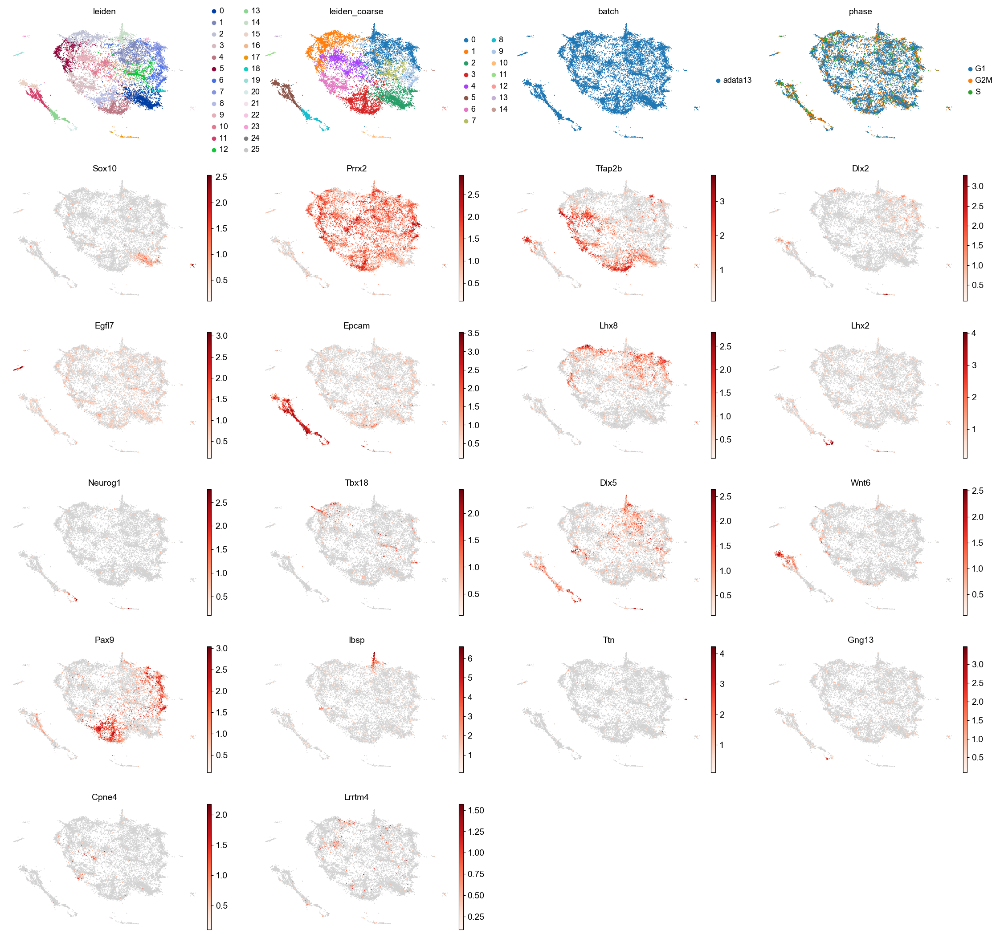

In [5]:
#keep cluster 0,1,2,3,4,6,7,11 for ectomesen, have to filter some more after
sc.set_figure_params(dpi=50,figsize=[6,4])
sc.tl.leiden(adata_E13, resolution = 0.4, key_added = 'leiden_coarse')
sc.pl.embedding(
    adata_E13,
    basis='X_scvi_MDE',
    color=['leiden','leiden_coarse','batch','phase','Sox10','Prrx2','Tfap2b','Dlx2',
           'Egfl7', #Endothelial
           'Epcam', #ectoderm
           'Lhx8', #brain stuff
           'Lhx2', #prospective telencephalon
           'Neurog1',
           'Tbx18', #mesoderm
           'Dlx5', 'Wnt6', #placode
           'Pax9', #this stuff is def not ectomesen
           'Ibsp',
           'Ttn', #muscle
           'Gng13',
           'Cpne4',
           'Lrrtm4',
          ],
    #groups=['3','5','7','9'],
    frameon=False,
    ncols=4,
    cmap = reds,
    vmin=0.1,
)

In [6]:
####Mesenchyme
adata_E13_mesen = adata_E13[adata_E13.obs['leiden_coarse'].isin(['0','1','2','3','4','6','7','9'])].copy()

1709479053.053874: Regressing cell cycle
1709479211.972779: Highly Variable Genes
1709479213.1041193: PCA
1709479213.5400648: Neighbors
1709479214.2066557: MDE and UMAP
1709479219.1268384: Leiden clustering


/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


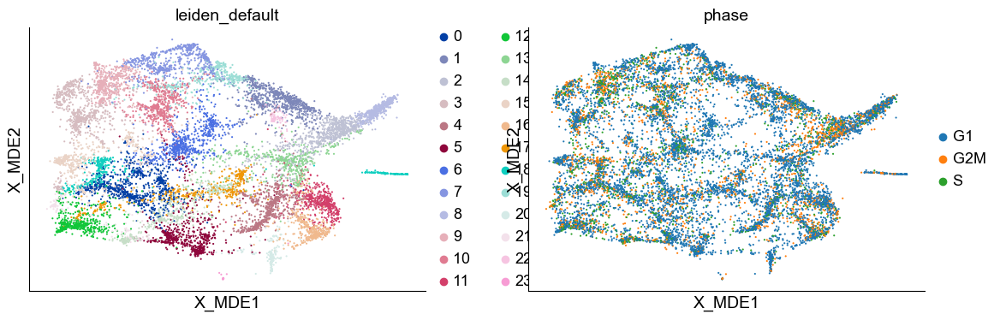

/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


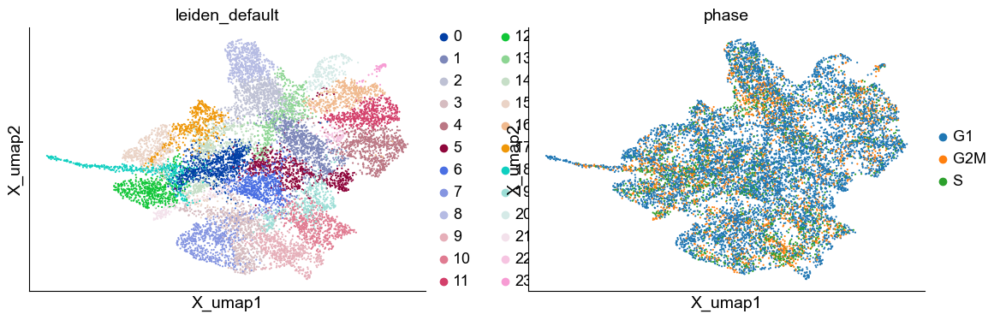

In [8]:
default_regress_cycle_to_mde(adata_E13_mesen, n_neighbors = 10,n_comps=40, skip_preprocess = True, resolution = 1,n_top_genes = 2000)

In [ ]:
# sc.tl.leiden(adata_E13_mesen, resolution = .4, key_added = 'leiden_mesen.4')
# sc.tl.leiden(adata_E13_mesen, resolution = .2, key_added = 'leiden_mesen.2')

sc.pl.embedding(
    adata_E13_mesen,
    size=15,
    basis='X_umap',
    color=['leiden_default','leiden_coarse','leiden_mesen.4','leiden_mesen.2','phase','Casz1','Cpne4','Pitx2','Runx3','Foxd2','Sim1','Sp5','Runx3','Sp7','En1','Ibsp','Msx1',
           'Barx1','Gata3','Foxd1','Alcam','En1',],
    #groups=['23','20'],
    #groups=['16','17',],

    frameon=False,
    ncols=4,
    cmap = reds,
    vmin=0.1,
    #vmax=10,
    #layer='original_counts',
)

#Palatal shelf; Combine Asb4+ and Meox/sim2+ clusters as one
    #Also has molar, Tfap2b Rgs5 

#Osteogenic Mesenchyme 
    #Pdzrn4, Ptn, Dlx5 Runx2 Meis2
        #Mystery, Pitx2, En1, Vim, Runx2

#Osteo
    #Ibsp

#Lip Mesenchyme
    #Lrriq/Pappa + Tbx15, combine clusters
    
#Whisker pad
    #Ebf3

#Medial nasal prominence derivatives
    #Dkk1 Vomer condensation, Flrt2
        #cartilage subcluster
    #Car2 primary palate Lrriq1
    #Tbx22, Between cartilage and oral ectoderm, posterior to primary palate
    #Sfrp4 Incisor
    
#Nasal Cavity Mesenchyme
    #Dorsal Nr2f2, Tfap2b, Aldh1a2
    #Ventral, Gsc Pax3 Irx1 Gata2 Tbx22
    
#Foxl2 Cluster
    #Aldh1a2
    #Tbx22
    
#Sim1 cluster
    #En1, Hmx1

#Nasal septum cartilage
    #Full on cartilage, Alpl, Wwp2, 

#Anterior nasal capsule cartilage
    #Wnt5a Msx1 Sema3e

##Remove Zic2 Meninges and tiny pericytes cluster



/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


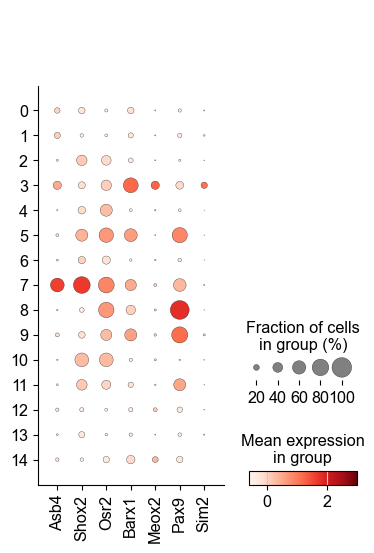

In [84]:
sc.pl.dotplot(adata_E13_mesen, var_names = ['Asb4','Shox2','Osr2','Barx1','Meox2','Pax9','Sim2',
                                                   ], groupby = 'leiden_mesen.4', vmax=3)

In [14]:
# adata_E13_mesen_filt = adata_E13_mesen[adata_E13_mesen.obs['leiden_mesen.4'].isin(['0','1','2','3','4','5','6','7','8','9','10','11','13',])].copy()
# adata_E13_mesen_filt.write('anndata_objects/adata_E13_mesen_filt.h5ad')

In [ ]:
#Palatal shelf; Combine Asb4+ and Meox/sim2+ clusters as one
    #Also has molar, Tfap2b Rgs5 

#Osteogenic Mesenchyme 
    #Pdzrn4, Ptn, Dlx5 Runx2 Meis2
        #Mystery, Pitx2, En1, Vim, Runx2

#Osteo
    #Ibsp

#Lip Mesenchyme
    #Lrriq/Pappa + Tbx15, combine clusters
    
#Whisker pad
    #Ebf3

#Medial nasal prominence derivatives
    #Dkk1 Vomer condensation, Flrt2
        #cartilage subcluster
    #Car2 primary palate Lrriq1
    #Tbx22, Between cartilage and oral ectoderm, posterior to primary palate
    #Sfrp4 Incisor
    
#Nasal Cavity Mesenchyme
    #Dorsal Nr2f2, Tfap2b, Aldh1a2
    #Ventral, Gsc Pax3 Irx1 Gata2 Tbx22
    
#Foxl2 Cluster
    #Aldh1a2
    #Tbx22
    
#Sim1 cluster
    #En1, Hmx1

#Nasal septum cartilage
    #Full on cartilage, Alpl, Wwp2, 

#Anterior nasal capsule cartilage
    #Wnt5a Msx1 Sema3e

##Remove Zic2 Meninges and tiny pericytes cluster

#sc.tl.leiden(adata_E13_mesen_filt, resolution = .5, key_added = 'leiden_mesen.5')
#sc.tl.leiden(adata_E13_mesen_filt, resolution = 2, key_added = 'leiden_mesen2')


sc.pl.embedding(
    adata_E13_mesen_filt,
    size=15,
    basis='X_umap',
    color=['leiden_default','leiden_coarse','leiden_mesen.4','leiden_mesen.2','leiden_mesen2','leiden_mesen.5','phase','Casz1','Cpne4','Pitx2','Runx3','Foxd2','Sim1','Sp5','Runx3','Sp7','En1','Ibsp','Msx1',
           'Barx1','Gata3','Foxd1','Alcam','En1','Tfap2b','Alx3','Ebf3','Tbx15','Pappa','Asb4'],
    #groups=['23','20'],
    #groups=['16','17',],

    frameon=False,
    ncols=4,
    cmap = reds,
    vmin=0.1,
    #vmax=10,
    #layer='original_counts',
)


/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


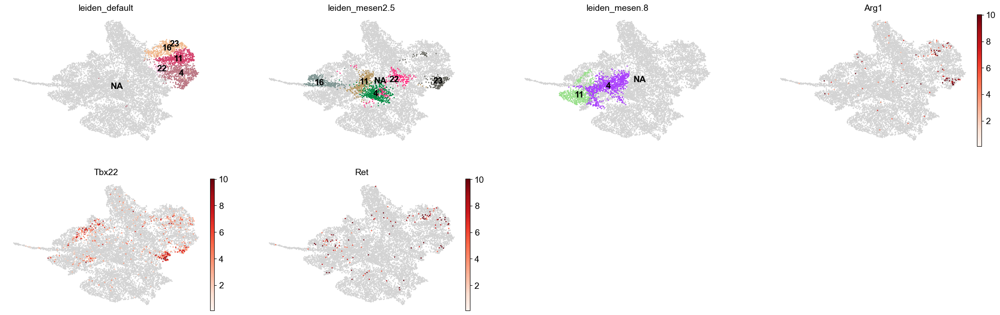

In [11]:
#sc.tl.leiden(adata_E13_mesen_filt, resolution = .55, key_added = 'leiden_mesen.8')

sc.pl.embedding(
    adata_E13_mesen_filt,
    size=15,
    basis='X_umap',
    color=['leiden_default','leiden_mesen2.5','leiden_mesen.8','Arg1','Tbx22','Ret',],
    #groups=['23','20'],
    #groups=['4','11','16','22','23',],
    legend_loc = 'on data',
    frameon=False,
    ncols=4,
    cmap = reds,
    vmin=0.1,
    #vmax=10,
    #layer='original_counts',
)

In [39]:
adata_E13_mesen_filt.obs['E13_mesen_annotation_coarse'] = 'test' #create new column
# adata_E12_mesen_no_filt.obs['E11_mesen_annotation_fine'] = adata_E12_mesen_no_filt.obs['E11_mesen_annotation_fine'].cat.add_categories(['Dorsal MxP',
#                                                                                                                                      ])#add category names

adata_E13_mesen_filt.obs.loc[adata_E13_mesen_filt[adata_E13_mesen_filt.obs['leiden_default'] == '0'].obs.index,'E13_mesen_annotation_coarse'] = 'Osteogenic'
adata_E13_mesen_filt.obs.loc[adata_E13_mesen_filt[adata_E13_mesen_filt.obs['leiden_default'] == '1'].obs.index,'E13_mesen_annotation_coarse'] = 'Nasal Capsule'
adata_E13_mesen_filt.obs.loc[adata_E13_mesen_filt[adata_E13_mesen_filt.obs['leiden_default'] == '2'].obs.index,'E13_mesen_annotation_coarse'] = 'Nasal Septum'
adata_E13_mesen_filt.obs.loc[adata_E13_mesen_filt[adata_E13_mesen_filt.obs['leiden_default'] == '3'].obs.index,'E13_mesen_annotation_coarse'] = 'Lip'
adata_E13_mesen_filt.obs.loc[adata_E13_mesen_filt[adata_E13_mesen_filt.obs['leiden_default'] == '4'].obs.index,'E13_mesen_annotation_coarse'] = 'Nasal Cavity'
adata_E13_mesen_filt.obs.loc[adata_E13_mesen_filt[adata_E13_mesen_filt.obs['leiden_default'] == '5'].obs.index,'E13_mesen_annotation_coarse'] = 'Foxl2+' #probably eye
adata_E13_mesen_filt.obs.loc[adata_E13_mesen_filt[adata_E13_mesen_filt.obs['leiden_default'] == '6'].obs.index,'E13_mesen_annotation_coarse'] = 'Osteogenic'
adata_E13_mesen_filt.obs.loc[adata_E13_mesen_filt[adata_E13_mesen_filt.obs['leiden_default'] == '7'].obs.index,'E13_mesen_annotation_coarse'] = 'Lip'
adata_E13_mesen_filt.obs.loc[adata_E13_mesen_filt[adata_E13_mesen_filt.obs['leiden_default'] == '8'].obs.index,'E13_mesen_annotation_coarse'] = 'Nasal Septum'
adata_E13_mesen_filt.obs.loc[adata_E13_mesen_filt[adata_E13_mesen_filt.obs['leiden_default'] == '9'].obs.index,'E13_mesen_annotation_coarse'] = 'Whisker Pad'
adata_E13_mesen_filt.obs.loc[adata_E13_mesen_filt[adata_E13_mesen_filt.obs['leiden_default'] == '10'].obs.index,'E13_mesen_annotation_coarse'] = 'Sim1 +'
adata_E13_mesen_filt.obs.loc[adata_E13_mesen_filt[adata_E13_mesen_filt.obs['leiden_default'] == '11'].obs.index,'E13_mesen_annotation_coarse'] = 'Nasal Cavity'
adata_E13_mesen_filt.obs.loc[adata_E13_mesen_filt[adata_E13_mesen_filt.obs['leiden_default'] == '12'].obs.index,'E13_mesen_annotation_coarse'] = 'Palate'
adata_E13_mesen_filt.obs.loc[adata_E13_mesen_filt[adata_E13_mesen_filt.obs['leiden_default'] == '13'].obs.index,'E13_mesen_annotation_coarse'] = 'Nasal Septum'
adata_E13_mesen_filt.obs.loc[adata_E13_mesen_filt[adata_E13_mesen_filt.obs['leiden_default'] == '14'].obs.index,'E13_mesen_annotation_coarse'] = 'Palate'
adata_E13_mesen_filt.obs.loc[adata_E13_mesen_filt[adata_E13_mesen_filt.obs['leiden_default'] == '15'].obs.index,'E13_mesen_annotation_coarse'] = 'Posteroventral MnP'
adata_E13_mesen_filt.obs.loc[adata_E13_mesen_filt[adata_E13_mesen_filt.obs['leiden_default'] == '16'].obs.index,'E13_mesen_annotation_coarse'] = 'Nasal Cavity'
adata_E13_mesen_filt.obs.loc[adata_E13_mesen_filt[adata_E13_mesen_filt.obs['leiden_default'] == '17'].obs.index,'E13_mesen_annotation_coarse'] = 'Posteroventral MnP'
adata_E13_mesen_filt.obs.loc[adata_E13_mesen_filt[adata_E13_mesen_filt.obs['leiden_default'] == '18'].obs.index,'E13_mesen_annotation_coarse'] = 'Osteoblasts'
adata_E13_mesen_filt.obs.loc[adata_E13_mesen_filt[adata_E13_mesen_filt.obs['leiden_default'] == '19'].obs.index,'E13_mesen_annotation_coarse'] = 'Nostril Clusters'
adata_E13_mesen_filt.obs.loc[adata_E13_mesen_filt[adata_E13_mesen_filt.obs['leiden_default'] == '21'].obs.index,'E13_mesen_annotation_coarse'] = 'Palate'
adata_E13_mesen_filt.obs.loc[adata_E13_mesen_filt[adata_E13_mesen_filt.obs['leiden_default'] == '22'].obs.index,'E13_mesen_annotation_coarse'] = 'Nasal Cavity'
adata_E13_mesen_filt.obs.loc[adata_E13_mesen_filt[adata_E13_mesen_filt.obs['leiden_default'] == '23'].obs.index,'E13_mesen_annotation_coarse'] = 'Nasal Cavity'

adata_E13_mesen_filt.obs['E13_mesen_annotation_coarse'] = adata_E13_mesen_filt.obs['E13_mesen_annotation_coarse'].astype('category')




In [41]:
adata_E13_mesen_filt.obs['integration_label'] = 'FnP'
adata_E13_mesen_filt.obs.loc[adata_E13_mesen_filt[adata_E13_mesen_filt.obs['E13_mesen_annotation_coarse'] == 'Whisker Pad'].obs.index,'integration_label'] = 'Whisker Pad'
adata_E13_mesen_filt.obs.loc[adata_E13_mesen_filt[adata_E13_mesen_filt.obs['E13_mesen_annotation_coarse'] == 'Osteogenic'].obs.index,'integration_label'] = 'Osteogenic'
adata_E13_mesen_filt.obs.loc[adata_E13_mesen_filt[adata_E13_mesen_filt.obs['E13_mesen_annotation_coarse'] == 'Lip'].obs.index,'integration_label'] = 'Lip'
adata_E13_mesen_filt.obs.loc[adata_E13_mesen_filt[adata_E13_mesen_filt.obs['E13_mesen_annotation_coarse'] == 'Palate'].obs.index,'integration_label'] = 'MxP'
adata_E13_mesen_filt.obs.loc[adata_E13_mesen_filt[adata_E13_mesen_filt.obs['E13_mesen_annotation_coarse'] == 'Osteoblasts'].obs.index,'integration_label'] = 'Osteoblasts'

adata_E13_mesen_filt.obs['integration_label'] = adata_E13_mesen_filt.obs['integration_label'].astype('category')

/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


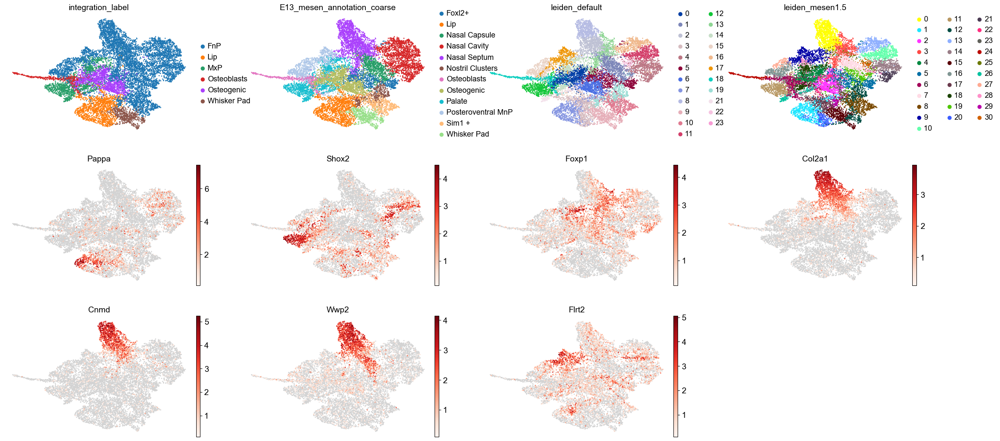

In [20]:
sc.pl.embedding(
    adata_E13_mesen_filt,
    size=15,
    basis='X_umap',
    color=['integration_label','E13_mesen_annotation_coarse','leiden_default','leiden_mesen1.5','Pappa','Shox2','Foxp1','Col2a1','Cnmd','Wwp2','Flrt2'],
    #groups=['9'],
    #groups=['16','17',],
    #legend_loc = 'on data',
    frameon=False,
    ncols=4,
    cmap = reds,
    vmin=0.1,
    #vmax=10,
    #layer='original_counts',
)

In [3]:
#adata_E13_mesen_filt.write('anndata_objects/adata_E13_mesen_annotated.h5ad')
adata_E13_mesen_filt = sc.read('anndata_objects/adata_E13_mesen_annotated.h5ad')

In [4]:
adata_E13_mesen_filt.X = adata_E13_mesen_filt.layers['original_counts'].copy()
sc.pp.normalize_total(adata_E13_mesen_filt, target_sum=1e4)
sc.pp.log1p(adata_E13_mesen_filt)

In [156]:
sc.tl.leiden(adata_E13_mesen_filt, resolution = 2, key_added = 'leiden_fine')#1.5
sc.tl.leiden(adata_E13_mesen_filt, resolution = 1.8, key_added = 'leiden_fine2')
sc.tl.leiden(adata_E13_mesen_filt, resolution = 2, key_added = 'leiden_fine3')
sc.tl.leiden(adata_E13_mesen_filt, resolution = 3, key_added = 'leiden_fine4')
sc.tl.leiden(adata_E13_mesen_filt, resolution = .5, key_added = 'leiden_coarse')
sc.tl.leiden(adata_E13_mesen_filt, resolution = .6, key_added = 'leiden_coarse2')

In [ ]:
genes = ['Nr2f2','Tfap2b','Aldh1a2','Gsc','Gata2','Pax7','Lef1','Dlx5',]
sc.pl.rank_genes_groups_dotplot(adata_E13_mesen_filt,var_names = genes,groupby='leiden_fine',dendrogram=True,
             values_to_plot="logfoldchanges", cmap='bwr',
    vmin=-4,
    vmax=4,)

/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


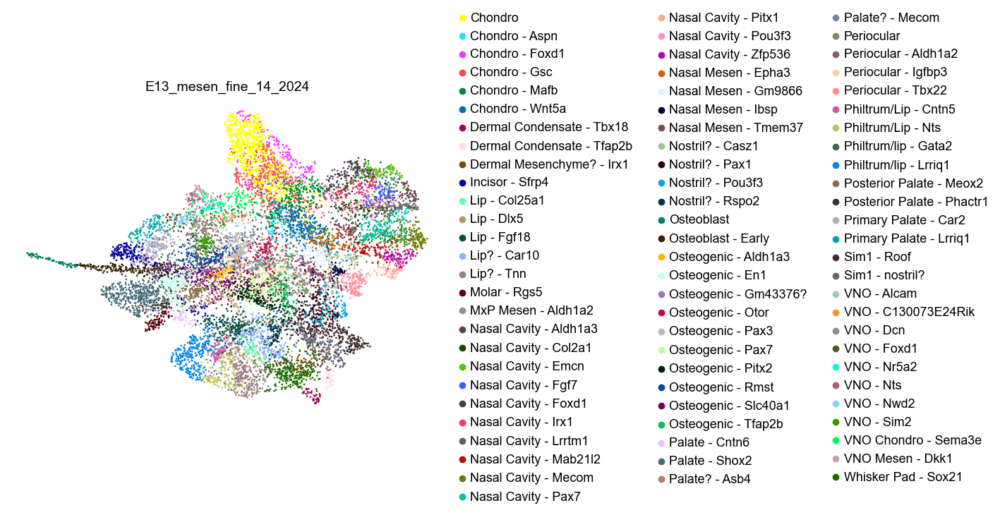

In [568]:
#annotating at 1.7, seems to capture all small populations!
adata_E13_mesen_filt.obs['E13_mesen_fine_14_2024'] = 'test'

adata_E13_mesen_filt.obs.loc[adata_E13_mesen_filt[adata_E13_mesen_filt.obs['leiden_fine'] == ''].obs.index,'E13_mesen_fine_14_2024'] = ''
adata_E13_mesen_filt.obs.loc[adata_E13_mesen_filt[adata_E13_mesen_filt.obs['leiden_fine'] == ''].obs.index,'E13_mesen_fine_14_2024'] = ''
adata_E13_mesen_filt.obs.loc[adata_E13_mesen_filt[adata_E13_mesen_filt.obs['leiden_fine'] == ''].obs.index,'E13_mesen_fine_14_2024'] = ''
adata_E13_mesen_filt.obs.loc[adata_E13_mesen_filt[adata_E13_mesen_filt.obs['leiden_fine'] == ''].obs.index,'E13_mesen_fine_14_2024'] = ''

adata_E13_mesen_filt.obs.loc[adata_E13_mesen_filt[adata_E13_mesen_filt.obs['leiden_fine2'] == '33'].obs.index,'E13_mesen_fine_14_2024'] = 'Molar - Rgs5' #Rgs5, Dlx1/2, Lhx8, Barx1, Frzb, Asb4, Fxyd7, Tfap2b
adata_E13_mesen_filt.obs.loc[adata_E13_mesen_filt[adata_E13_mesen_filt.obs['leiden_fine2'] == '24'].obs.index,'E13_mesen_fine_14_2024'] = 'Incisor - Sfrp4' #Sfrp4, Lrriq1, Alpl, Sp7, Scara5, Tgfb1, Car2, Podnl1
adata_E13_mesen_filt.obs.loc[adata_E13_mesen_filt[adata_E13_mesen_filt.obs['leiden_fine2'] == '6'].obs.index,'E13_mesen_fine_14_2024'] = 'Palate - Shox2' #Shox2, Asb4, Lhx8/6, Niban1, Ptch1, Frzb
# adata_E13_mesen_filt.obs.loc[adata_E13_mesen_filt[adata_E13_mesen_filt.obs['leiden_fine2'] == '12'].obs.index,'E13_mesen_fine_14_2024'] = 'Nasal Cavity - Emcn' #Emcn, Nr2f2, Aldh1a2, Tfap2b, Nupr1, Tmem37, Pax9, Gata2,
# adata_E13_mesen_filt.obs.loc[adata_E13_mesen_filt[adata_E13_mesen_filt.obs['leiden_fine2'] == '27'].obs.index,'E13_mesen_fine_14_2024'] = 'Nasal Cavity - Lgr5' #Lgr5, Gsc, Foxl2, Prss12, Pitx1; Tmem37-
# adata_E13_mesen_filt.obs.loc[adata_E13_mesen_filt[adata_E13_mesen_filt.obs['leiden_fine2'] == '8'].obs.index,'E13_mesen_fine_14_2024'] = 'Nasal Cavity - Nrg1' #Nrg1, Nr2f2, Mecom, Gata2, Pax9, Gsc, Tmem37
# adata_E13_mesen_filt.obs.loc[adata_E13_mesen_filt[adata_E13_mesen_filt.obs['leiden_fine2'] == '5'].obs.index,'E13_mesen_fine_14_2024'] = 'Nasal Cavity - Gsc' #Gsc, Nr2f2, Tfap2b; Can probably be split further, I already noticed Nxph4 is not in its own cluster
# adata_E13_mesen_filt.obs.loc[adata_E13_mesen_filt[adata_E13_mesen_filt.obs['leiden_fine2'] == ''].obs.index,'E13_mesen_fine_14_2024'] = '' #
adata_E13_mesen_filt.obs.loc[adata_E13_mesen_filt[adata_E13_mesen_filt.obs['leiden_fine2'] == ''].obs.index,'E13_mesen_fine_14_2024'] = '' #

adata_E13_mesen_filt.obs.loc[adata_E13_mesen_filt[adata_E13_mesen_filt.obs['leiden_fine3'] == '25'].obs.index,'E13_mesen_fine_14_2024'] = 'Primary Palate - Car2' #Car2, Foxd1, Foxf1, Frzb, Pax9
adata_E13_mesen_filt.obs.loc[adata_E13_mesen_filt[adata_E13_mesen_filt.obs['leiden_fine3'] == '36'].obs.index,'E13_mesen_fine_14_2024'] = 'Primary Palate - Lrriq1' #Lrriq1, Foxd1, Lrfn5, Aspn, Reln
#adata_E13_mesen_filt.obs.loc[adata_E13_mesen_filt[adata_E13_mesen_filt.obs['leiden_fine3'] == '18'].obs.index,'E13_mesen_fine_14_2024'] = 'Philtrum/lip - Tfap2b' #Lrriq1, Cdh13, Tfap2b, Pappa, Foxd1
adata_E13_mesen_filt.obs.loc[adata_E13_mesen_filt[adata_E13_mesen_filt.obs['leiden_fine3'] == '14'].obs.index,'E13_mesen_fine_14_2024'] = 'Philtrum/lip - Nts' #Nts, Lrriq1, Pappa, Foxd1
adata_E13_mesen_filt.obs.loc[adata_E13_mesen_filt[adata_E13_mesen_filt.obs['leiden_fine3'] == '26'].obs.index,'E13_mesen_fine_14_2024'] = 'Lip? - Tnn' #Tnn, Tbx15, Mab21l2, Cxcl14, Lrnn1, Hey2
adata_E13_mesen_filt.obs.loc[adata_E13_mesen_filt[adata_E13_mesen_filt.obs['leiden_fine3'] == '13'].obs.index,'E13_mesen_fine_14_2024'] = 'Whisker Pad - Tbx15'#Sox21, Lef1, Tbx15
adata_E13_mesen_filt.obs.loc[adata_E13_mesen_filt[adata_E13_mesen_filt.obs['leiden_fine3'] == '39'].obs.index,'E13_mesen_fine_14_2024'] = 'Dermal Condensate - Sox18'
adata_E13_mesen_filt.obs.loc[adata_E13_mesen_filt[adata_E13_mesen_filt.obs['leiden_fine3'] == '16'].obs.index,'E13_mesen_fine_14_2024'] = 'Whisker Pad - Tfap2b' #Sox21, Tfap2b, Hey2. ;13 lacks tfap2b
adata_E13_mesen_filt.obs.loc[adata_E13_mesen_filt[adata_E13_mesen_filt.obs['leiden_fine3'] == ''].obs.index,'E13_mesen_fine_14_2024'] = ''
adata_E13_mesen_filt.obs.loc[adata_E13_mesen_filt[adata_E13_mesen_filt.obs['leiden_fine3'] == ''].obs.index,'E13_mesen_fine_14_2024'] = ''
adata_E13_mesen_filt.obs.loc[adata_E13_mesen_filt[adata_E13_mesen_filt.obs['leiden_fine3'] == ''].obs.index,'E13_mesen_fine_14_2024'] = ''
adata_E13_mesen_filt.obs.loc[adata_E13_mesen_filt[adata_E13_mesen_filt.obs['leiden_fine3'] == ''].obs.index,'E13_mesen_fine_14_2024'] = ''
adata_E13_mesen_filt.obs.loc[adata_E13_mesen_filt[adata_E13_mesen_filt.obs['leiden_fine3'] == ''].obs.index,'E13_mesen_fine_14_2024'] = ''


#Dermal/lip

adata_E13_mesen_filt.obs.loc[adata_E13_dermal[adata_E13_dermal.obs['leiden_fine'] == '0'].obs.index,'E13_mesen_fine_14_2024'] = 'Philtrum/lip - Lrriq1' #Lrriq1, Pappa, Foxd1
adata_E13_mesen_filt.obs.loc[adata_E13_dermal[adata_E13_dermal.obs['leiden_fine'] == '9'].obs.index,'E13_mesen_fine_14_2024'] = 'Philtrum/lip - Gata2' #Gata2, Msx2, Lrriq1_low
adata_E13_mesen_filt.obs.loc[adata_E13_dermal[adata_E13_dermal.obs['leiden_fine'] == '6'].obs.index,'E13_mesen_fine_14_2024'] = 'Philtrum/Lip - Nts' #Nts
adata_E13_mesen_filt.obs.loc[adata_E13_dermal[adata_E13_dermal.obs['leiden_fine'] == '8'].obs.index,'E13_mesen_fine_14_2024'] = 'Philtrum/Lip - Cntn5' #Cntnt5, Pappa
adata_E13_mesen_filt.obs.loc[adata_E13_dermal[adata_E13_dermal.obs['leiden_fine'] == '1'].obs.index,'E13_mesen_fine_14_2024'] = 'Sim1 - Roof' #Hmx1, Sim1, Pcdh9, En1
adata_E13_mesen_filt.obs.loc[adata_E13_dermal[adata_E13_dermal.obs['leiden_fine'] == '4'].obs.index,'E13_mesen_fine_14_2024'] = 'Sim1 - nostril?' #Sim1, Hmx1_low
adata_E13_mesen_filt.obs.loc[adata_E13_dermal[adata_E13_dermal.obs['leiden_fine'] == '10'].obs.index,'E13_mesen_fine_14_2024'] = 'Nostril? - Rspo2' #Rspo2, Pax7
adata_E13_mesen_filt.obs.loc[adata_E13_dermal[adata_E13_dermal.obs['leiden_fine'] == '2'].obs.index,'E13_mesen_fine_14_2024'] = 'Whisker Pad - Sox21'#Sox21
adata_E13_mesen_filt.obs.loc[adata_E13_dermal[adata_E13_dermal.obs['leiden_fine'] == '3'].obs.index,'E13_mesen_fine_14_2024'] = 'Lip? - Tnn' #Tnn, Lhx8, Tbx15
adata_E13_mesen_filt.obs.loc[adata_E13_dermal[adata_E13_dermal.obs['leiden_fine'] == '12'].obs.index,'E13_mesen_fine_14_2024'] = 'Dermal Condensate - Tfap2b'#Sox18, Tfap2b, Pla2g7, Fzd10, Cpxm2, Prss35
adata_E13_mesen_filt.obs.loc[adata_E13_dermal[adata_E13_dermal.obs['leiden_fine'] == '14'].obs.index,'E13_mesen_fine_14_2024'] = 'Dermal Condensate - Tbx18' #Sox18, Tbx18,
adata_E13_mesen_filt.obs.loc[adata_E13_dermal[adata_E13_dermal.obs['leiden_fine'] == '11'].obs.index,'E13_mesen_fine_14_2024'] = 'Dermal Mesenchyme? - Irx1' #Irx1, Nrxn3
adata_E13_mesen_filt.obs.loc[adata_E13_dermal[adata_E13_dermal.obs['leiden_fine'] == '5'].obs.index,'E13_mesen_fine_14_2024'] = 'Lip? - Car10' #Car10, Dlk1, En1
adata_E13_mesen_filt.obs.loc[adata_E13_dermal[adata_E13_dermal.obs['leiden_fine'] == '7'].obs.index,'E13_mesen_fine_14_2024'] = 'Lip - Fgf18' #fgf18, Fxyd7, En1 ; 5,7,15 and 13 are quite similar, with some select differences.
adata_E13_mesen_filt.obs.loc[adata_E13_dermal[adata_E13_dermal.obs['leiden_fine'] == '15'].obs.index,'E13_mesen_fine_14_2024'] = 'Lip - Dlx5'
adata_E13_mesen_filt.obs.loc[adata_E13_dermal[adata_E13_dermal.obs['leiden_fine'] == '13'].obs.index,'E13_mesen_fine_14_2024'] = 'Lip - Col25a1' #Gfra1, Col25a1

#VNO stuff
adata_E13_mesen_filt.obs.loc[adata_E13_vomer[adata_E13_vomer.obs['leiden_fine'] == '3'].obs.index,'E13_mesen_fine_14_2024'] = 'VNO Chondro - Sema3e' #Sox9, Sema3e, Wwp2, Cnmd
adata_E13_mesen_filt.obs.loc[adata_E13_vomer[adata_E13_vomer.obs['leiden_fine'] == '7'].obs.index,'E13_mesen_fine_14_2024'] = 'VNO Mesen - Dkk1' #Dkk1, Lgr5,
adata_E13_mesen_filt.obs.loc[adata_E13_vomer[adata_E13_vomer.obs['leiden_fine'] == '2'].obs.index,'E13_mesen_fine_14_2024'] = 'VNO - Dcn' #Pex5l, Dcn, Shox2
adata_E13_mesen_filt.obs.loc[adata_E13_vomer[adata_E13_vomer.obs['leiden_fine'] == '8'].obs.index,'E13_mesen_fine_14_2024'] = 'VNO - Nts' #Nts, Dkk1, Lgr5
adata_E13_mesen_filt.obs.loc[adata_E13_vomer[adata_E13_vomer.obs['leiden_fine'] == '4'].obs.index,'E13_mesen_fine_14_2024'] = 'VNO - Nr5a2' #Nr5a2, Cldn11
adata_E13_mesen_filt.obs.loc[adata_E13_vomer[adata_E13_vomer.obs['leiden_fine'] == '6'].obs.index,'E13_mesen_fine_14_2024'] = 'VNO - Nwd2' #
adata_E13_mesen_filt.obs.loc[adata_E13_vomer[adata_E13_vomer.obs['leiden_fine'] == '9'].obs.index,'E13_mesen_fine_14_2024'] = 'VNO - C130073E24Rik' #C130073E24Rik, Shox2, Slitrk3, Foxd1, Foxp2, Foxp1, Foxf2 Rprm, Ezr #Rprm is implicated in cell cycle, but according to cell cycle inference this cluster is no different from cluster 0. There must be something special about these cells
adata_E13_mesen_filt.obs.loc[adata_E13_vomer[adata_E13_vomer.obs['leiden_fine'] == '0'].obs.index,'E13_mesen_fine_14_2024'] = 'VNO - Foxd1' #Foxd1, 'Foxp1' Igf1 #Lacks a bunch of key markers in cluster 9, but is otherwise very similar
adata_E13_mesen_filt.obs.loc[adata_E13_vomer[adata_E13_vomer.obs['leiden_fine'] == '1'].obs.index,'E13_mesen_fine_14_2024'] = 'VNO - Sim2' #Sim2 and some Meox2. Initially thought posterior palate, but I'm pretty convinced it's not. gp3 shows some sim2 below VNO, but no meox2. It's Flrt2+ but Pax9-, It's strange. I don't think this is posterior palate. Its interesting for sure. Col1a1 high but that's not very telling. Has Alpl, Col12a1, Runx2, Dlk1, Pcp4 very strong at tip of umap. Pcp4 has one very interesting looking insitu on gp3. I think this is bone related 
adata_E13_mesen_filt.obs.loc[adata_E13_vomer[adata_E13_vomer.obs['leiden_fine'] == '5'].obs.index,'E13_mesen_fine_14_2024'] = 'VNO - Alcam' #Alcam, Runx2, Foxp1, Col12a1. Strange cluster as well. Similar to both 1 and 0. Lacks some of their marker genes.
adata_E13_mesen_filt.obs.loc[adata_E13_vomer[adata_E13_vomer.obs['leiden_fine'] == '10'].obs.index,'E13_mesen_fine_14_2024'] = 'VNO Chondro - Sema3e' #Pretty much same as 3, but in a less differentiated state? Less chondro markers present. Only a couple of cells, so I will just combine them
adata_E13_mesen_filt.obs.loc[adata_E13_vomer[adata_E13_vomer.obs['leiden_fine'] == ''].obs.index,'E13_mesen_fine_14_2024'] = '' #
adata_E13_mesen_filt.obs.loc[adata_E13_vomer[adata_E13_vomer.obs['leiden_fine'] == ''].obs.index,'E13_mesen_fine_14_2024'] = '' #


#chondro and nostril
adata_E13_mesen_filt.obs.loc[adata_E13_chondro[adata_E13_chondro.obs['leiden_fine'] == '12'].obs.index,'E13_mesen_fine_14_2024'] = 'Nasal Mesen - Tmem37' #Tmem37, Olfm1, Probably should join one of the nasal cavity clusters. I think it's just in between. I guess the nasal cavity is recruited for the nasal capsule condensation
adata_E13_mesen_filt.obs.loc[adata_E13_chondro[adata_E13_chondro.obs['leiden_fine'] == '7'].obs.index,'E13_mesen_fine_14_2024'] = 'Nostril? - Casz1' #Casz1, Tfap2b
adata_E13_mesen_filt.obs.loc[adata_E13_chondro[adata_E13_chondro.obs['leiden_fine'] == '5'].obs.index,'E13_mesen_fine_14_2024'] = 'Nostril? - Pax1' #Pax1, Osr1
adata_E13_mesen_filt.obs.loc[adata_E13_chondro[adata_E13_chondro.obs['leiden_fine'] == '0'].obs.index,'E13_mesen_fine_14_2024'] = 'Chondro - Wnt5a' #Wnt5a, Pou3f3, Wwp2, Similar to cluster 12, but lacking tmem37 and olfm1
adata_E13_mesen_filt.obs.loc[adata_E13_chondro[adata_E13_chondro.obs['leiden_fine'] == '10'].obs.index,'E13_mesen_fine_14_2024'] = 'Nasal Mesen - Gm9866' #Gm9866, Igfbp7, Satb2, Wwp2
adata_E13_mesen_filt.obs.loc[adata_E13_chondro[adata_E13_chondro.obs['leiden_fine'] == '15'].obs.index,'E13_mesen_fine_14_2024'] = 'Nasal Mesen - Ibsp' #Ibsp, Bmp3, Wif1, Dlx5, Alpl
adata_E13_mesen_filt.obs.loc[adata_E13_chondro[adata_E13_chondro.obs['leiden_fine'] == '11'].obs.index,'E13_mesen_fine_14_2024'] = 'Nasal Mesen - Epha3' #Epha3, Tceal6, Pax7, Arpp21
adata_E13_mesen_filt.obs.loc[adata_E13_chondro[adata_E13_chondro.obs['leiden_fine'] == '14'].obs.index,'E13_mesen_fine_14_2024'] = 'Chondro - Aspn' #Aspn, Pappa2, this cluster feels like a mix between cluster 0 and 1, some area where they overlap
adata_E13_mesen_filt.obs.loc[adata_E13_chondro[adata_E13_chondro.obs['leiden_fine'] == '1'].obs.index,'E13_mesen_fine_14_2024'] = 'Chondro - Mafb' #Mafb, Maf, Similar to cluster 14, with the maf expression
adata_E13_mesen_filt.obs.loc[adata_E13_chondro[adata_E13_chondro.obs['leiden_fine'] == '9'].obs.index,'E13_mesen_fine_14_2024'] = 'Chondro - Foxd1' #
adata_E13_mesen_filt.obs.loc[adata_E13_chondro[adata_E13_chondro.obs['leiden_fine'] == '3'].obs.index,'E13_mesen_fine_14_2024'] = 'Chondro' #
adata_E13_mesen_filt.obs.loc[adata_E13_chondro[adata_E13_chondro.obs['leiden_fine'] == '6'].obs.index,'E13_mesen_fine_14_2024'] = 'Chondro' #
adata_E13_mesen_filt.obs.loc[adata_E13_chondro[adata_E13_chondro.obs['leiden_fine'] == '8'].obs.index,'E13_mesen_fine_14_2024'] = 'Chondro - Gsc' #
adata_E13_mesen_filt.obs.loc[adata_E13_chondro[adata_E13_chondro.obs['leiden_fine'] == '4'].obs.index,'E13_mesen_fine_14_2024'] = 'Chondro - Gsc' #
adata_E13_mesen_filt.obs.loc[adata_E13_chondro[adata_E13_chondro.obs['leiden_fine'] == '2'].obs.index,'E13_mesen_fine_14_2024'] = 'Chondro' #
adata_E13_mesen_filt.obs.loc[adata_E13_chondro[adata_E13_chondro.obs['leiden_fine'] == '13'].obs.index,'E13_mesen_fine_14_2024'] = 'Chondro' #
adata_E13_mesen_filt.obs.loc[adata_E13_chondro[adata_E13_chondro.obs['leiden_fine'] == ''].obs.index,'E13_mesen_fine_14_2024'] = '' #


adata_E13_mesen_filt.obs.loc[adata_E13_chondro[adata_E13_chondro.obs['leiden_fine2'] == '16'].obs.index,'E13_mesen_fine_14_2024'] = 'Nostril? - Casz1' #Casz1, Tfap2b
adata_E13_mesen_filt.obs.loc[adata_E13_chondro[adata_E13_chondro.obs['leiden_fine2'] == '2'].obs.index,'E13_mesen_fine_14_2024'] = 'Nostril? - Pax1' #Pax1, AI646519(lncrna next to pax1) Osr1 (tfap2b-)
adata_E13_mesen_filt.obs.loc[adata_E13_chondro[adata_E13_chondro.obs['leiden_fine2'] == '14'].obs.index,'E13_mesen_fine_14_2024'] = 'Nostril? - Pou3f3' #Pou3f3, Tfap2b, Hey2

#osteogenic
adata_E13_mesen_filt.obs.loc[adata_E13_osteogenic[adata_E13_osteogenic.obs['leiden_fine'] == '8'].obs.index,'E13_mesen_fine_14_2024'] = 'Periocular - Tbx22' #Foxl2, Tbx22, Cdh6
adata_E13_mesen_filt.obs.loc[adata_E13_osteogenic[adata_E13_osteogenic.obs['leiden_fine'] == '9'].obs.index,'E13_mesen_fine_14_2024'] = 'Posterior Palate - Meox2' #Meox2, Foxf2, Barx1
adata_E13_mesen_filt.obs.loc[adata_E13_osteogenic[adata_E13_osteogenic.obs['leiden_fine'] == '14'].obs.index,'E13_mesen_fine_14_2024'] = 'Periocular' #No real unique stuff, but lacks Tbx22 and Cdh6
adata_E13_mesen_filt.obs.loc[adata_E13_osteogenic[adata_E13_osteogenic.obs['leiden_fine'] == '17'].obs.index,'E13_mesen_fine_14_2024'] = 'Periocular - Igfbp3' #
adata_E13_mesen_filt.obs.loc[adata_E13_osteogenic[adata_E13_osteogenic.obs['leiden_fine'] == '6'].obs.index,'E13_mesen_fine_14_2024'] = 'Periocular - Aldh1a2' #Aldh1a2, Foxl2
adata_E13_mesen_filt.obs.loc[adata_E13_osteogenic[adata_E13_osteogenic.obs['leiden_fine'] == '13'].obs.index,'E13_mesen_fine_14_2024'] = 'MxP Mesen - Aldh1a2' #Aldh1a2, Barx1, Meis2, Fas (no foxl2)
adata_E13_mesen_filt.obs.loc[adata_E13_osteogenic[adata_E13_osteogenic.obs['leiden_fine'] == '16'].obs.index,'E13_mesen_fine_14_2024'] = 'Palate? - Asb4' #Asb4, Barx1, Sim2,Dlx1/2, probably needs to be together with the rest of the palate?
adata_E13_mesen_filt.obs.loc[adata_E13_osteogenic[adata_E13_osteogenic.obs['leiden_fine'] == '18'].obs.index,'E13_mesen_fine_14_2024'] = 'Palate? - Mecom' #Mecom, Barx1, Sim2, (no asb4) I think this and 16 are part of the posterior palate, they have sim2, but lack meox2
adata_E13_mesen_filt.obs.loc[adata_E13_osteogenic[adata_E13_osteogenic.obs['leiden_fine'] == '2'].obs.index,'E13_mesen_fine_14_2024'] = 'Osteoblast - Early' #Lacks some of the more differentiated genes. Low in Ibsp
adata_E13_mesen_filt.obs.loc[adata_E13_osteogenic[adata_E13_osteogenic.obs['leiden_fine'] == '15'].obs.index,'E13_mesen_fine_14_2024'] = 'Osteoblast' #Ibsp_high, Col24a1, Col11a2, Col22a1
adata_E13_mesen_filt.obs.loc[adata_E13_osteogenic[adata_E13_osteogenic.obs['leiden_fine'] == '10'].obs.index,'E13_mesen_fine_14_2024'] = 'Osteogenic - Otor' #Runx2, Otor, While otor is something ear related, there is some otor expression above the nose on genepaint, that is bone related it seems
adata_E13_mesen_filt.obs.loc[adata_E13_osteogenic[adata_E13_osteogenic.obs['leiden_fine'] == '1'].obs.index,'E13_mesen_fine_14_2024'] = 'Osteogenic - Pax7' #Pax7, Wnt16, Runx2, Alpl
adata_E13_mesen_filt.obs.loc[adata_E13_osteogenic[adata_E13_osteogenic.obs['leiden_fine'] == '11'].obs.index,'E13_mesen_fine_14_2024'] = 'Osteogenic - Tfap2b' #Tfap2b, Pou3f3, Cpne4, Runx2, Alpl
adata_E13_mesen_filt.obs.loc[adata_E13_osteogenic[adata_E13_osteogenic.obs['leiden_fine'] == '3'].obs.index,'E13_mesen_fine_14_2024'] = 'Osteogenic - Pitx2' #Pitx2, En1, Runx2, Alpl
adata_E13_mesen_filt.obs.loc[adata_E13_osteogenic[adata_E13_osteogenic.obs['leiden_fine'] == '19'].obs.index,'E13_mesen_fine_14_2024'] = 'Osteogenic - Pitx2' #same but cell cycle
adata_E13_mesen_filt.obs.loc[adata_E13_osteogenic[adata_E13_osteogenic.obs['leiden_fine'] == '5'].obs.index,'E13_mesen_fine_14_2024'] = 'Osteogenic - Pax3' #
adata_E13_mesen_filt.obs.loc[adata_E13_osteogenic[adata_E13_osteogenic.obs['leiden_fine'] == '12'].obs.index,'E13_mesen_fine_14_2024'] = 'Osteogenic - Gm43376?' #Was conbined with the aldh1a3 cluster, couldn't find a god marker, maybe it doesn't have any
adata_E13_mesen_filt.obs.loc[adata_E13_osteogenic[adata_E13_osteogenic.obs['leiden_fine'] == '4'].obs.index,'E13_mesen_fine_14_2024'] = 'Osteogenic - Rmst' #Similar to the leftover bit of 12. But that part of 12 lacks some important factors like Alx1. Strange
adata_E13_mesen_filt.obs.loc[adata_E13_osteogenic[adata_E13_osteogenic.obs['leiden_fine'] == '7'].obs.index,'E13_mesen_fine_14_2024'] = 'Osteogenic - Slc40a1' #Slc40a1
adata_E13_mesen_filt.obs.loc[adata_E13_osteogenic[adata_E13_osteogenic.obs['leiden_fine'] == '20'].obs.index,'E13_mesen_fine_14_2024'] = 'Osteogenic - Slc40a1' #
adata_E13_mesen_filt.obs.loc[adata_E13_osteogenic[adata_E13_osteogenic.obs['leiden_fine'] == '0'].obs.index,'E13_mesen_fine_14_2024'] = 'Osteogenic - En1' #En1, Frzb, Lhx8, Cntn4, Lhx6, 
adata_E13_mesen_filt.obs.loc[adata_E13_osteogenic[adata_E13_osteogenic.obs['leiden_fine'] == ''].obs.index,'E13_mesen_fine_14_2024'] = '' #


adata_E13_mesen_filt.obs.loc[adata_E13_osteogenic[adata_E13_osteogenic.obs['leiden_fine2'] == '17'].obs.index,'E13_mesen_fine_14_2024'] = 'Osteogenic - Aldh1a3' #
adata_E13_mesen_filt.obs.loc[adata_E13_osteogenic[adata_E13_osteogenic.obs['leiden_fine2'] == ''].obs.index,'E13_mesen_fine_14_2024'] = '' #

#nasal cavity
adata_E13_mesen_filt.obs.loc[adata_E13_nasal_cavity[adata_E13_nasal_cavity.obs['leiden_fine'] == '12'].obs.index,'E13_mesen_fine_14_2024'] = 'Nasal Cavity - Pitx1' #Pitx1 Marchf11, Mab21l2, Osr1, Lgr5
adata_E13_mesen_filt.obs.loc[adata_E13_nasal_cavity[adata_E13_nasal_cavity.obs['leiden_fine'] == '7'].obs.index,'E13_mesen_fine_14_2024'] = 'Nasal Cavity - Zfp536' #Zfp536, Osr1, , Foxl2, Wnt16, Arg1, Lgr5
adata_E13_mesen_filt.obs.loc[adata_E13_nasal_cavity[adata_E13_nasal_cavity.obs['leiden_fine'] == '0'].obs.index,'E13_mesen_fine_14_2024'] = 'Nasal Cavity - Mecom' #Mecom, Dio3, Apela, 
adata_E13_mesen_filt.obs.loc[adata_E13_nasal_cavity[adata_E13_nasal_cavity.obs['leiden_fine'] == '14'].obs.index,'E13_mesen_fine_14_2024'] = 'Nasal Cavity - Mecom' #
adata_E13_mesen_filt.obs.loc[adata_E13_nasal_cavity[adata_E13_nasal_cavity.obs['leiden_fine'] == '8'].obs.index,'E13_mesen_fine_14_2024'] = 'Nasal Cavity - Col2a1' #Maybe needs to be merged with a chondro cluster?
adata_E13_mesen_filt.obs.loc[adata_E13_nasal_cavity[adata_E13_nasal_cavity.obs['leiden_fine'] == '5'].obs.index,'E13_mesen_fine_14_2024'] = 'Nasal Cavity - Irx1' #Irx1
adata_E13_mesen_filt.obs.loc[adata_E13_nasal_cavity[adata_E13_nasal_cavity.obs['leiden_fine'] == '3'].obs.index,'E13_mesen_fine_14_2024'] = 'Nasal Cavity - Foxd1' #Foxd1 Emcn Calca
adata_E13_mesen_filt.obs.loc[adata_E13_nasal_cavity[adata_E13_nasal_cavity.obs['leiden_fine'] == '2'].obs.index,'E13_mesen_fine_14_2024'] = 'Nasal Cavity - Emcn' #Emcn
adata_E13_mesen_filt.obs.loc[adata_E13_nasal_cavity[adata_E13_nasal_cavity.obs['leiden_fine'] == '10'].obs.index,'E13_mesen_fine_14_2024'] = 'Nasal Cavity - Pou3f3' #Pou3f3
adata_E13_mesen_filt.obs.loc[adata_E13_nasal_cavity[adata_E13_nasal_cavity.obs['leiden_fine'] == '4'].obs.index,'E13_mesen_fine_14_2024'] = 'Nasal Cavity - Lrrtm1' #Lrrtm1
adata_E13_mesen_filt.obs.loc[adata_E13_nasal_cavity[adata_E13_nasal_cavity.obs['leiden_fine'] == '13'].obs.index,'E13_mesen_fine_14_2024'] = 'Nasal Cavity - Aldh1a3' #Aldh1a3, Nxph4
adata_E13_mesen_filt.obs.loc[adata_E13_nasal_cavity[adata_E13_nasal_cavity.obs['leiden_fine'] == '9'].obs.index,'E13_mesen_fine_14_2024'] = 'Nasal Cavity - Mab21l2' #Mab21l2, Gata3, Satb2
adata_E13_mesen_filt.obs.loc[adata_E13_nasal_cavity[adata_E13_nasal_cavity.obs['leiden_fine'] == '11'].obs.index,'E13_mesen_fine_14_2024'] = 'Nasal Cavity - Fgf7' #Fgf7, Iigp1
adata_E13_mesen_filt.obs.loc[adata_E13_nasal_cavity[adata_E13_nasal_cavity.obs['leiden_fine'] == '1'].obs.index,'E13_mesen_fine_14_2024'] = 'Nasal Cavity - Pax7' #
adata_E13_mesen_filt.obs.loc[adata_E13_nasal_cavity[adata_E13_nasal_cavity.obs['leiden_fine'] == '6'].obs.index,'E13_mesen_fine_14_2024'] = 'Nasal Cavity - Pax7' #
adata_E13_mesen_filt.obs.loc[adata_E13_nasal_cavity[adata_E13_nasal_cavity.obs['leiden_fine'] == ''].obs.index,'E13_mesen_fine_14_2024'] = '' #
adata_E13_mesen_filt.obs.loc[adata_E13_nasal_cavity[adata_E13_nasal_cavity.obs['leiden_fine'] == ''].obs.index,'E13_mesen_fine_14_2024'] = '' #

adata_E13_mesen_filt.obs.loc[adata_E13_nasal_cavity[adata_E13_nasal_cavity.obs['leiden_fine3'] == '5'].obs.index,'E13_mesen_fine_14_2024'] = 'Nasal Cavity - Mecom' #


#some palate additions
adata_E13_mesen_filt.obs.loc[adata_E13_palate[adata_E13_palate.obs['leiden_fine'] == '0'].obs.index,'E13_mesen_fine_14_2024'] = 'Palate - Shox2' #
adata_E13_mesen_filt.obs.loc[adata_E13_palate[adata_E13_palate.obs['leiden_fine'] == '1'].obs.index,'E13_mesen_fine_14_2024'] = 'Palate - Shox2' #
adata_E13_mesen_filt.obs.loc[adata_E13_palate[adata_E13_palate.obs['leiden_fine'] == '2'].obs.index,'E13_mesen_fine_14_2024'] = 'Molar - Rgs5' #
adata_E13_mesen_filt.obs.loc[adata_E13_palate[adata_E13_palate.obs['leiden_fine'] == '4'].obs.index,'E13_mesen_fine_14_2024'] = 'Palate - Cntn6' #
adata_E13_mesen_filt.obs.loc[adata_E13_palate[adata_E13_palate.obs['leiden_fine'] == '3'].obs.index,'E13_mesen_fine_14_2024'] = 'Posterior Palate - Meox2' #

adata_E13_mesen_filt.obs.loc[adata_E13_palate[adata_E13_palate.obs['leiden_fine2'] == '7'].obs.index,'E13_mesen_fine_14_2024'] = 'Posterior Palate - Phactr1' #

adata_E13_mesen_filt_annotated = adata_E13_mesen_filt[adata_E13_mesen_filt.obs['E13_mesen_fine_14_2024']!='test'].copy()

sc.set_figure_params(dpi=50,figsize=[8,6])

sc.pl.embedding(
    adata_E13_mesen_filt_annotated,
    size=15,
    basis='X_umap',
    color=['E13_mesen_fine_14_2024',],
    #groups=['test'],
   # groups=['14','18'],
    #legend_loc = 'on data',
    frameon=False,
    ncols=3,
    cmap = reds,
    vmin=0.1,
    #vmax=10,
    #layer='original_counts',
)

/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


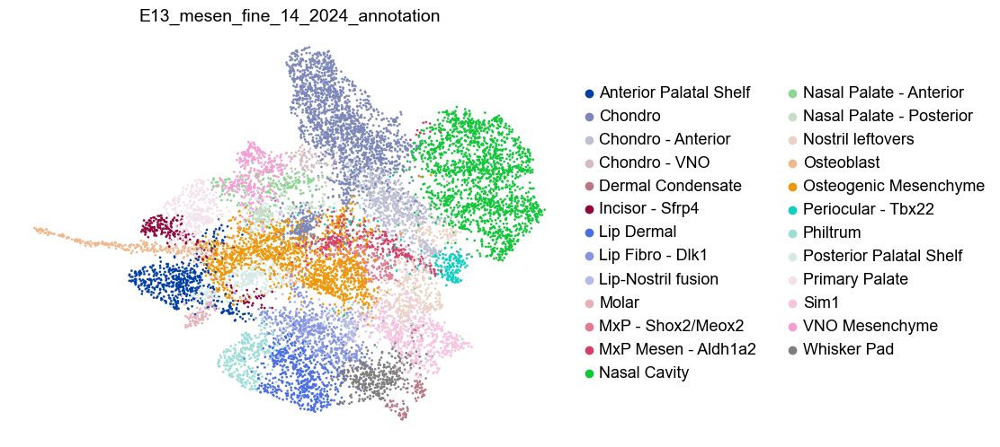

In [178]:
#annotating at 1.7, seems to capture all small populations!
adata_E13_mesen_filt_annotated.obs['E13_mesen_fine_14_2024_annotation'] = 'test'

#Merge anterior nasal with chondro anterior
#merge nasal mesen tmem with nasal cavity
#Merge Ibsp nasal with anterior chondro
#merge nasal cavity
#merge sim1, Both are roof!
#Incisor on its own
#Merge two primary palate
#osteoblast merged
#Merge osteogenic, except pax3 > merge with chondro
#merge dermal condensate
#Whisker pad +irx1



#lip stuff
#Dlk1 new cluster in lip
#nts+Tnn dermal lip
#philtrim lrriq1 +

#two aldh1a2 clusters together as mxp mesen - aldh1a2
#combine wrongly named periocular Igfbp3 and periocular. Don't know for sure what it is. Dlk1, Shox2, Meox2, Sim2

#figure something out for irx1+ lef1+ dermal mesen







adata_E13_mesen_filt_annotated.obs.loc[adata_E13_mesen_filt_annotated[adata_E13_mesen_filt_annotated.obs['E13_mesen_fine_14_2024'] == 'Chondro'].obs.index,'E13_mesen_fine_14_2024_annotation'] = 'Chondro'
adata_E13_mesen_filt_annotated.obs.loc[adata_E13_mesen_filt_annotated[adata_E13_mesen_filt_annotated.obs['E13_mesen_fine_14_2024'] == 'Chondro - Foxd1'].obs.index,'E13_mesen_fine_14_2024_annotation'] = 'Chondro'
adata_E13_mesen_filt_annotated.obs.loc[adata_E13_mesen_filt_annotated[adata_E13_mesen_filt_annotated.obs['E13_mesen_fine_14_2024'] == 'Chondro - Gsc'].obs.index,'E13_mesen_fine_14_2024_annotation'] = 'Chondro'
adata_E13_mesen_filt_annotated.obs.loc[adata_E13_mesen_filt_annotated[adata_E13_mesen_filt_annotated.obs['E13_mesen_fine_14_2024'] == 'Chondro - Mafb'].obs.index,'E13_mesen_fine_14_2024_annotation'] = 'Chondro'
adata_E13_mesen_filt_annotated.obs.loc[adata_E13_mesen_filt_annotated[adata_E13_mesen_filt_annotated.obs['E13_mesen_fine_14_2024'] == 'Chondro - Aspn'].obs.index,'E13_mesen_fine_14_2024_annotation'] = 'Chondro'
adata_E13_mesen_filt_annotated.obs.loc[adata_E13_mesen_filt_annotated[adata_E13_mesen_filt_annotated.obs['E13_mesen_fine_14_2024'] == 'Chondro - Wnt5a'].obs.index,'E13_mesen_fine_14_2024_annotation'] = 'Chondro - Anterior'
adata_E13_mesen_filt_annotated.obs.loc[adata_E13_mesen_filt_annotated[adata_E13_mesen_filt_annotated.obs['E13_mesen_fine_14_2024'] == 'VNO - Dcn'].obs.index,'E13_mesen_fine_14_2024_annotation'] = 'VNO Mesenchyme'
adata_E13_mesen_filt_annotated.obs.loc[adata_E13_mesen_filt_annotated[adata_E13_mesen_filt_annotated.obs['E13_mesen_fine_14_2024'] == 'VNO - Nts'].obs.index,'E13_mesen_fine_14_2024_annotation'] = 'VNO Mesenchyme'
adata_E13_mesen_filt_annotated.obs.loc[adata_E13_mesen_filt_annotated[adata_E13_mesen_filt_annotated.obs['E13_mesen_fine_14_2024'] == 'VNO - Nr5a2'].obs.index,'E13_mesen_fine_14_2024_annotation'] = 'VNO Mesenchyme'
adata_E13_mesen_filt_annotated.obs.loc[adata_E13_mesen_filt_annotated[adata_E13_mesen_filt_annotated.obs['E13_mesen_fine_14_2024'] == 'VNO - Nwd2'].obs.index,'E13_mesen_fine_14_2024_annotation'] = 'VNO Mesenchyme'
adata_E13_mesen_filt_annotated.obs.loc[adata_E13_mesen_filt_annotated[adata_E13_mesen_filt_annotated.obs['E13_mesen_fine_14_2024'] == 'VNO Mesen - Dkk1'].obs.index,'E13_mesen_fine_14_2024_annotation'] = 'VNO Mesenchyme'
adata_E13_mesen_filt_annotated.obs.loc[adata_E13_mesen_filt_annotated[adata_E13_mesen_filt_annotated.obs['E13_mesen_fine_14_2024'] == 'VNO - Sim2'].obs.index,'E13_mesen_fine_14_2024_annotation'] = 'Nasal Palate - Posterior'
adata_E13_mesen_filt_annotated.obs.loc[adata_E13_mesen_filt_annotated[adata_E13_mesen_filt_annotated.obs['E13_mesen_fine_14_2024'] == 'Palate? - Mecom'].obs.index,'E13_mesen_fine_14_2024_annotation'] = 'Nasal Palate - Posterior'
adata_E13_mesen_filt_annotated.obs.loc[adata_E13_mesen_filt_annotated[adata_E13_mesen_filt_annotated.obs['E13_mesen_fine_14_2024'] == 'VNO - Foxd1'].obs.index,'E13_mesen_fine_14_2024_annotation'] = 'Nasal Palate - Anterior'
adata_E13_mesen_filt_annotated.obs.loc[adata_E13_mesen_filt_annotated[adata_E13_mesen_filt_annotated.obs['E13_mesen_fine_14_2024'] == 'VNO - Alcam'].obs.index,'E13_mesen_fine_14_2024_annotation'] = 'Nasal Palate - Anterior'
adata_E13_mesen_filt_annotated.obs.loc[adata_E13_mesen_filt_annotated[adata_E13_mesen_filt_annotated.obs['E13_mesen_fine_14_2024'] == 'VNO - C130073E24Rik'].obs.index,'E13_mesen_fine_14_2024_annotation'] = 'Nasal Palate - Anterior'
adata_E13_mesen_filt_annotated.obs.loc[adata_E13_mesen_filt_annotated[adata_E13_mesen_filt_annotated.obs['E13_mesen_fine_14_2024'] == 'VNO Chondro - Sema3e'].obs.index,'E13_mesen_fine_14_2024_annotation'] = 'Chondro - VNO'
adata_E13_mesen_filt_annotated.obs.loc[adata_E13_mesen_filt_annotated[adata_E13_mesen_filt_annotated.obs['E13_mesen_fine_14_2024'] == 'Palate - Shox2'].obs.index,'E13_mesen_fine_14_2024_annotation'] = 'Anterior Palatal Shelf'
adata_E13_mesen_filt_annotated.obs.loc[adata_E13_mesen_filt_annotated[adata_E13_mesen_filt_annotated.obs['E13_mesen_fine_14_2024'] == 'Palate - Cntn6'].obs.index,'E13_mesen_fine_14_2024_annotation'] = 'Anterior Palatal Shelf'
adata_E13_mesen_filt_annotated.obs.loc[adata_E13_mesen_filt_annotated[adata_E13_mesen_filt_annotated.obs['E13_mesen_fine_14_2024'] == 'Posterior Palate - Phactr1'].obs.index,'E13_mesen_fine_14_2024_annotation'] = 'Posterior Palatal Shelf'
adata_E13_mesen_filt_annotated.obs.loc[adata_E13_mesen_filt_annotated[adata_E13_mesen_filt_annotated.obs['E13_mesen_fine_14_2024'] == 'Posterior Palate - Meox2'].obs.index,'E13_mesen_fine_14_2024_annotation'] = 'Posterior Palatal Shelf'
adata_E13_mesen_filt_annotated.obs.loc[adata_E13_mesen_filt_annotated[adata_E13_mesen_filt_annotated.obs['E13_mesen_fine_14_2024'] == 'Palate? - Asb4'].obs.index,'E13_mesen_fine_14_2024_annotation'] = 'Posterior Palatal Shelf'
adata_E13_mesen_filt_annotated.obs.loc[adata_E13_mesen_filt_annotated[adata_E13_mesen_filt_annotated.obs['E13_mesen_fine_14_2024'] == 'Molar - Rgs5'].obs.index,'E13_mesen_fine_14_2024_annotation'] = 'Molar'
adata_E13_mesen_filt_annotated.obs.loc[adata_E13_mesen_filt_annotated[adata_E13_mesen_filt_annotated.obs['E13_mesen_fine_14_2024'] == 'Nostril? - Casz1'].obs.index,'E13_mesen_fine_14_2024_annotation'] = 'Nostril leftovers'
adata_E13_mesen_filt_annotated.obs.loc[adata_E13_mesen_filt_annotated[adata_E13_mesen_filt_annotated.obs['E13_mesen_fine_14_2024'] == 'Nostril? - Pax1'].obs.index,'E13_mesen_fine_14_2024_annotation'] = 'Nostril leftovers'
adata_E13_mesen_filt_annotated.obs.loc[adata_E13_mesen_filt_annotated[adata_E13_mesen_filt_annotated.obs['E13_mesen_fine_14_2024'] == 'Nostril? - Pou3f3'].obs.index,'E13_mesen_fine_14_2024_annotation'] = 'Nostril leftovers'
adata_E13_mesen_filt_annotated.obs.loc[adata_E13_mesen_filt_annotated[adata_E13_mesen_filt_annotated.obs['E13_mesen_fine_14_2024'] == 'Nostril? - Rspo2'].obs.index,'E13_mesen_fine_14_2024_annotation'] = 'Lip-Nostril fusion'
adata_E13_mesen_filt_annotated.obs.loc[adata_E13_mesen_filt_annotated[adata_E13_mesen_filt_annotated.obs['E13_mesen_fine_14_2024'] == 'Philtrum/lip - Gata2'].obs.index,'E13_mesen_fine_14_2024_annotation'] = 'Lip-Nostril fusion'
adata_E13_mesen_filt_annotated.obs.loc[adata_E13_mesen_filt_annotated[adata_E13_mesen_filt_annotated.obs['E13_mesen_fine_14_2024'] == 'Philtrum/lip - Lrriq1'].obs.index,'E13_mesen_fine_14_2024_annotation'] = 'Philtrum'
adata_E13_mesen_filt_annotated.obs.loc[adata_E13_mesen_filt_annotated[adata_E13_mesen_filt_annotated.obs['E13_mesen_fine_14_2024'] == 'Nasal Mesen - Gm9866'].obs.index,'E13_mesen_fine_14_2024_annotation'] = 'Chondro - Anterior'
adata_E13_mesen_filt_annotated.obs.loc[adata_E13_mesen_filt_annotated[adata_E13_mesen_filt_annotated.obs['E13_mesen_fine_14_2024'] == 'Nasal Mesen - Ibsp'].obs.index,'E13_mesen_fine_14_2024_annotation'] = 'Chondro - Anterior'
adata_E13_mesen_filt_annotated.obs.loc[adata_E13_mesen_filt_annotated[adata_E13_mesen_filt_annotated.obs['E13_mesen_fine_14_2024'] == 'Nasal Mesen - Epha3'].obs.index,'E13_mesen_fine_14_2024_annotation'] = 'Chondro - Anterior'
adata_E13_mesen_filt_annotated.obs.loc[adata_E13_mesen_filt_annotated[adata_E13_mesen_filt_annotated.obs['E13_mesen_fine_14_2024'] == 'Nasal Mesen - Tmem37'].obs.index,'E13_mesen_fine_14_2024_annotation'] = 'Nasal Cavity'
adata_E13_mesen_filt_annotated.obs.loc[adata_E13_mesen_filt_annotated[adata_E13_mesen_filt_annotated.obs['E13_mesen_fine_14_2024'] == 'Nasal Cavity - Pitx1'].obs.index,'E13_mesen_fine_14_2024_annotation'] = 'Nasal Cavity'
adata_E13_mesen_filt_annotated.obs.loc[adata_E13_mesen_filt_annotated[adata_E13_mesen_filt_annotated.obs['E13_mesen_fine_14_2024'] == 'Nasal Cavity - Zfp536'].obs.index,'E13_mesen_fine_14_2024_annotation'] = 'Nasal Cavity'
adata_E13_mesen_filt_annotated.obs.loc[adata_E13_mesen_filt_annotated[adata_E13_mesen_filt_annotated.obs['E13_mesen_fine_14_2024'] == 'Nasal Cavity - Mecom'].obs.index,'E13_mesen_fine_14_2024_annotation'] = 'Nasal Cavity'
adata_E13_mesen_filt_annotated.obs.loc[adata_E13_mesen_filt_annotated[adata_E13_mesen_filt_annotated.obs['E13_mesen_fine_14_2024'] == 'Nasal Cavity - Col2a1'].obs.index,'E13_mesen_fine_14_2024_annotation'] = 'Nasal Cavity'
adata_E13_mesen_filt_annotated.obs.loc[adata_E13_mesen_filt_annotated[adata_E13_mesen_filt_annotated.obs['E13_mesen_fine_14_2024'] == 'Nasal Cavity - Irx1'].obs.index,'E13_mesen_fine_14_2024_annotation'] = 'Nasal Cavity'
adata_E13_mesen_filt_annotated.obs.loc[adata_E13_mesen_filt_annotated[adata_E13_mesen_filt_annotated.obs['E13_mesen_fine_14_2024'] == 'Nasal Cavity - Foxd1'].obs.index,'E13_mesen_fine_14_2024_annotation'] = 'Nasal Cavity'
adata_E13_mesen_filt_annotated.obs.loc[adata_E13_mesen_filt_annotated[adata_E13_mesen_filt_annotated.obs['E13_mesen_fine_14_2024'] == 'Nasal Cavity - Emcn'].obs.index,'E13_mesen_fine_14_2024_annotation'] = 'Nasal Cavity'
adata_E13_mesen_filt_annotated.obs.loc[adata_E13_mesen_filt_annotated[adata_E13_mesen_filt_annotated.obs['E13_mesen_fine_14_2024'] == 'Nasal Cavity - Pou3f3'].obs.index,'E13_mesen_fine_14_2024_annotation'] = 'Nasal Cavity'
adata_E13_mesen_filt_annotated.obs.loc[adata_E13_mesen_filt_annotated[adata_E13_mesen_filt_annotated.obs['E13_mesen_fine_14_2024'] == 'Nasal Cavity - Lrrtm1'].obs.index,'E13_mesen_fine_14_2024_annotation'] = 'Nasal Cavity'
adata_E13_mesen_filt_annotated.obs.loc[adata_E13_mesen_filt_annotated[adata_E13_mesen_filt_annotated.obs['E13_mesen_fine_14_2024'] == 'Nasal Cavity - Aldh1a3'].obs.index,'E13_mesen_fine_14_2024_annotation'] = 'Nasal Cavity'
adata_E13_mesen_filt_annotated.obs.loc[adata_E13_mesen_filt_annotated[adata_E13_mesen_filt_annotated.obs['E13_mesen_fine_14_2024'] == 'Nasal Cavity - Mab21l2'].obs.index,'E13_mesen_fine_14_2024_annotation'] = 'Nasal Cavity'
adata_E13_mesen_filt_annotated.obs.loc[adata_E13_mesen_filt_annotated[adata_E13_mesen_filt_annotated.obs['E13_mesen_fine_14_2024'] == 'Nasal Cavity - Fgf7'].obs.index,'E13_mesen_fine_14_2024_annotation'] = 'Nasal Cavity'
adata_E13_mesen_filt_annotated.obs.loc[adata_E13_mesen_filt_annotated[adata_E13_mesen_filt_annotated.obs['E13_mesen_fine_14_2024'] == 'Nasal Cavity - Pax7'].obs.index,'E13_mesen_fine_14_2024_annotation'] = 'Nasal Cavity'
adata_E13_mesen_filt_annotated.obs.loc[adata_E13_mesen_filt_annotated[adata_E13_mesen_filt_annotated.obs['E13_mesen_fine_14_2024'] == 'Sim1 - Roof'].obs.index,'E13_mesen_fine_14_2024_annotation'] = 'Sim1'
adata_E13_mesen_filt_annotated.obs.loc[adata_E13_mesen_filt_annotated[adata_E13_mesen_filt_annotated.obs['E13_mesen_fine_14_2024'] == 'Sim1 - nostril?'].obs.index,'E13_mesen_fine_14_2024_annotation'] = 'Sim1'
adata_E13_mesen_filt_annotated.obs.loc[adata_E13_mesen_filt_annotated[adata_E13_mesen_filt_annotated.obs['E13_mesen_fine_14_2024'] == 'Primary Palate - Car2'].obs.index,'E13_mesen_fine_14_2024_annotation'] = 'Primary Palate'
adata_E13_mesen_filt_annotated.obs.loc[adata_E13_mesen_filt_annotated[adata_E13_mesen_filt_annotated.obs['E13_mesen_fine_14_2024'] == 'Primary Palate - Lrriq1'].obs.index,'E13_mesen_fine_14_2024_annotation'] = 'Primary Palate'
adata_E13_mesen_filt_annotated.obs.loc[adata_E13_mesen_filt_annotated[adata_E13_mesen_filt_annotated.obs['E13_mesen_fine_14_2024'] == 'Osteogenic - Pax3'].obs.index,'E13_mesen_fine_14_2024_annotation'] = 'Chondro'
adata_E13_mesen_filt_annotated.obs.loc[adata_E13_mesen_filt_annotated[adata_E13_mesen_filt_annotated.obs['E13_mesen_fine_14_2024'] == 'Osteoblast'].obs.index,'E13_mesen_fine_14_2024_annotation'] = 'Osteoblast'
adata_E13_mesen_filt_annotated.obs.loc[adata_E13_mesen_filt_annotated[adata_E13_mesen_filt_annotated.obs['E13_mesen_fine_14_2024'] == 'Osteoblast - Early'].obs.index,'E13_mesen_fine_14_2024_annotation'] = 'Osteoblast'
adata_E13_mesen_filt_annotated.obs.loc[adata_E13_mesen_filt_annotated[adata_E13_mesen_filt_annotated.obs['E13_mesen_fine_14_2024'] == 'Osteogenic - Otor'].obs.index,'E13_mesen_fine_14_2024_annotation'] = 'Osteogenic Mesenchyme'
adata_E13_mesen_filt_annotated.obs.loc[adata_E13_mesen_filt_annotated[adata_E13_mesen_filt_annotated.obs['E13_mesen_fine_14_2024'] == 'Osteogenic - Pax7'].obs.index,'E13_mesen_fine_14_2024_annotation'] = 'Osteogenic Mesenchyme'
adata_E13_mesen_filt_annotated.obs.loc[adata_E13_mesen_filt_annotated[adata_E13_mesen_filt_annotated.obs['E13_mesen_fine_14_2024'] == 'Osteogenic - Tfap2b'].obs.index,'E13_mesen_fine_14_2024_annotation'] = 'Osteogenic Mesenchyme'
adata_E13_mesen_filt_annotated.obs.loc[adata_E13_mesen_filt_annotated[adata_E13_mesen_filt_annotated.obs['E13_mesen_fine_14_2024'] == 'Osteogenic - Pitx2'].obs.index,'E13_mesen_fine_14_2024_annotation'] = 'Osteogenic Mesenchyme'
adata_E13_mesen_filt_annotated.obs.loc[adata_E13_mesen_filt_annotated[adata_E13_mesen_filt_annotated.obs['E13_mesen_fine_14_2024'] == 'Osteogenic - Gm43376?'].obs.index,'E13_mesen_fine_14_2024_annotation'] = 'Osteogenic Mesenchyme'
adata_E13_mesen_filt_annotated.obs.loc[adata_E13_mesen_filt_annotated[adata_E13_mesen_filt_annotated.obs['E13_mesen_fine_14_2024'] == 'Osteogenic - Rmst'].obs.index,'E13_mesen_fine_14_2024_annotation'] = 'Osteogenic Mesenchyme'
adata_E13_mesen_filt_annotated.obs.loc[adata_E13_mesen_filt_annotated[adata_E13_mesen_filt_annotated.obs['E13_mesen_fine_14_2024'] == 'Osteogenic - Slc40a1'].obs.index,'E13_mesen_fine_14_2024_annotation'] = 'Osteogenic Mesenchyme'
adata_E13_mesen_filt_annotated.obs.loc[adata_E13_mesen_filt_annotated[adata_E13_mesen_filt_annotated.obs['E13_mesen_fine_14_2024'] == 'Osteogenic - En1'].obs.index,'E13_mesen_fine_14_2024_annotation'] = 'Osteogenic Mesenchyme'
adata_E13_mesen_filt_annotated.obs.loc[adata_E13_mesen_filt_annotated[adata_E13_mesen_filt_annotated.obs['E13_mesen_fine_14_2024'] == 'Osteogenic - Aldh1a3'].obs.index,'E13_mesen_fine_14_2024_annotation'] = 'Osteogenic Mesenchyme'
adata_E13_mesen_filt_annotated.obs.loc[adata_E13_mesen_filt_annotated[adata_E13_mesen_filt_annotated.obs['E13_mesen_fine_14_2024'] == 'Whisker Pad - Sox21'].obs.index,'E13_mesen_fine_14_2024_annotation'] = 'Whisker Pad'
adata_E13_mesen_filt_annotated.obs.loc[adata_E13_mesen_filt_annotated[adata_E13_mesen_filt_annotated.obs['E13_mesen_fine_14_2024'] == 'Dermal Mesenchyme? - Irx1'].obs.index,'E13_mesen_fine_14_2024_annotation'] = 'Whisker Pad'
adata_E13_mesen_filt_annotated.obs.loc[adata_E13_mesen_filt_annotated[adata_E13_mesen_filt_annotated.obs['E13_mesen_fine_14_2024'] == 'Dermal Condensate - Tbx18'].obs.index,'E13_mesen_fine_14_2024_annotation'] = 'Dermal Condensate'
adata_E13_mesen_filt_annotated.obs.loc[adata_E13_mesen_filt_annotated[adata_E13_mesen_filt_annotated.obs['E13_mesen_fine_14_2024'] == 'Dermal Condensate - Tfap2b'].obs.index,'E13_mesen_fine_14_2024_annotation'] = 'Dermal Condensate'
adata_E13_mesen_filt_annotated.obs.loc[adata_E13_mesen_filt_annotated[adata_E13_mesen_filt_annotated.obs['E13_mesen_fine_14_2024'] == 'Lip - Dlx5'].obs.index,'E13_mesen_fine_14_2024_annotation'] = 'Lip Fibro - Dlk1'
adata_E13_mesen_filt_annotated.obs.loc[adata_E13_mesen_filt_annotated[adata_E13_mesen_filt_annotated.obs['E13_mesen_fine_14_2024'] == 'Lip - Fgf18'].obs.index,'E13_mesen_fine_14_2024_annotation'] = 'Lip Fibro - Dlk1'
adata_E13_mesen_filt_annotated.obs.loc[adata_E13_mesen_filt_annotated[adata_E13_mesen_filt_annotated.obs['E13_mesen_fine_14_2024'] == 'Lip - Col25a1'].obs.index,'E13_mesen_fine_14_2024_annotation'] = 'Lip Fibro - Dlk1'
adata_E13_mesen_filt_annotated.obs.loc[adata_E13_mesen_filt_annotated[adata_E13_mesen_filt_annotated.obs['E13_mesen_fine_14_2024'] == 'Lip? - Car10'].obs.index,'E13_mesen_fine_14_2024_annotation'] = 'Lip Fibro - Dlk1'
adata_E13_mesen_filt_annotated.obs.loc[adata_E13_mesen_filt_annotated[adata_E13_mesen_filt_annotated.obs['E13_mesen_fine_14_2024'] == 'Lip? - Tnn'].obs.index,'E13_mesen_fine_14_2024_annotation'] = 'Lip Dermal'
adata_E13_mesen_filt_annotated.obs.loc[adata_E13_mesen_filt_annotated[adata_E13_mesen_filt_annotated.obs['E13_mesen_fine_14_2024'] == 'Philtrum/Lip - Nts'].obs.index,'E13_mesen_fine_14_2024_annotation'] = 'Lip Dermal'
adata_E13_mesen_filt_annotated.obs.loc[adata_E13_mesen_filt_annotated[adata_E13_mesen_filt_annotated.obs['E13_mesen_fine_14_2024'] == 'Periocular - Aldh1a2'].obs.index,'E13_mesen_fine_14_2024_annotation'] = 'MxP Mesen - Aldh1a2'
adata_E13_mesen_filt_annotated.obs.loc[adata_E13_mesen_filt_annotated[adata_E13_mesen_filt_annotated.obs['E13_mesen_fine_14_2024'] == 'MxP Mesen - Aldh1a2'].obs.index,'E13_mesen_fine_14_2024_annotation'] = 'MxP Mesen - Aldh1a2'
adata_E13_mesen_filt_annotated.obs.loc[adata_E13_mesen_filt_annotated[adata_E13_mesen_filt_annotated.obs['E13_mesen_fine_14_2024'] == 'Periocular'].obs.index,'E13_mesen_fine_14_2024_annotation'] = 'MxP - Shox2/Meox2'
adata_E13_mesen_filt_annotated.obs.loc[adata_E13_mesen_filt_annotated[adata_E13_mesen_filt_annotated.obs['E13_mesen_fine_14_2024'] == 'Periocular - Igfbp3'].obs.index,'E13_mesen_fine_14_2024_annotation'] = 'MxP - Shox2/Meox2'
adata_E13_mesen_filt_annotated.obs.loc[adata_E13_mesen_filt_annotated[adata_E13_mesen_filt_annotated.obs['E13_mesen_fine_14_2024'] == 'Periocular - Tbx22'].obs.index,'E13_mesen_fine_14_2024_annotation'] = 'Periocular - Tbx22'
adata_E13_mesen_filt_annotated.obs.loc[adata_E13_mesen_filt_annotated[adata_E13_mesen_filt_annotated.obs['E13_mesen_fine_14_2024'] == 'Incisor - Sfrp4'].obs.index,'E13_mesen_fine_14_2024_annotation'] = 'Incisor - Sfrp4'


adata_E13_mesen_filt_annotated.obs.loc[adata_E13_mesen_filt_annotated[adata_E13_mesen_filt_annotated.obs['E13_mesen_fine_14_2024'] == 'Philtrum/Lip - Cntn5'].obs.index,'E13_mesen_fine_14_2024_annotation'] = 'Lip Dermal'
adata_E13_mesen_filt_annotated.obs.loc[adata_E13_mesen_filt_annotated[adata_E13_mesen_filt_annotated.obs['E13_mesen_fine_14_2024'] == ''].obs.index,'E13_mesen_fine_14_2024_annotation'] = ''

sc.set_figure_params(dpi=50,figsize=[8,6])

sc.pl.embedding(
    adata_E13_mesen_filt_annotated,
    size=15,
    basis='X_umap',
    color=['E13_mesen_fine_14_2024_annotation',],
    #groups=['test'],
   # groups=['14','18'],
    #legend_loc = 'on data',
    frameon=False,
    ncols=3,
    cmap = reds,
    vmin=0.1,
    #vmax=10,
    #layer='original_counts',
)

/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


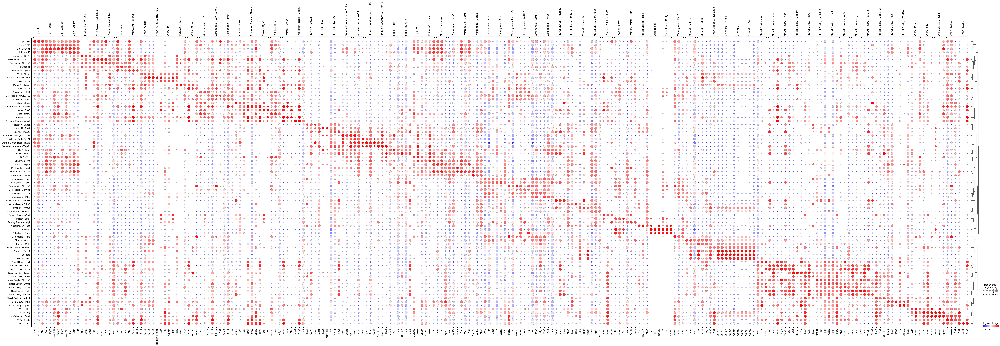

In [18]:

from pathlib import Path
sc._settings.ScanpyConfig.figdir=Path('./figures/new_figures_23_5_2024') #set figdir
sc.tl.rank_genes_groups(adata_E13_mesen_filt_annotated,groupby = 'E13_mesen_fine_14_2024',
                        method = 't-test_overestim_var',
                        #method = 'wilcoxon',
                       )

sc.tl.dendrogram(adata_E13_mesen_filt_annotated, groupby = 'E13_mesen_fine_14_2024',)
sc.pl.rank_genes_groups_dotplot(adata_E13_mesen_filt_annotated,
                                n_genes=3,
                                values_to_plot="logfoldchanges", cmap='bwr',
    vmin=-4,
    vmax=4,
    min_logfoldchange=2,
                                #dendrogram = False,
                                #mean_only_expressed=True,
                               #dot_max = 0.5, 
                                #save = 'E13_mesen_finest_automatic.pdf'
                               )

/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


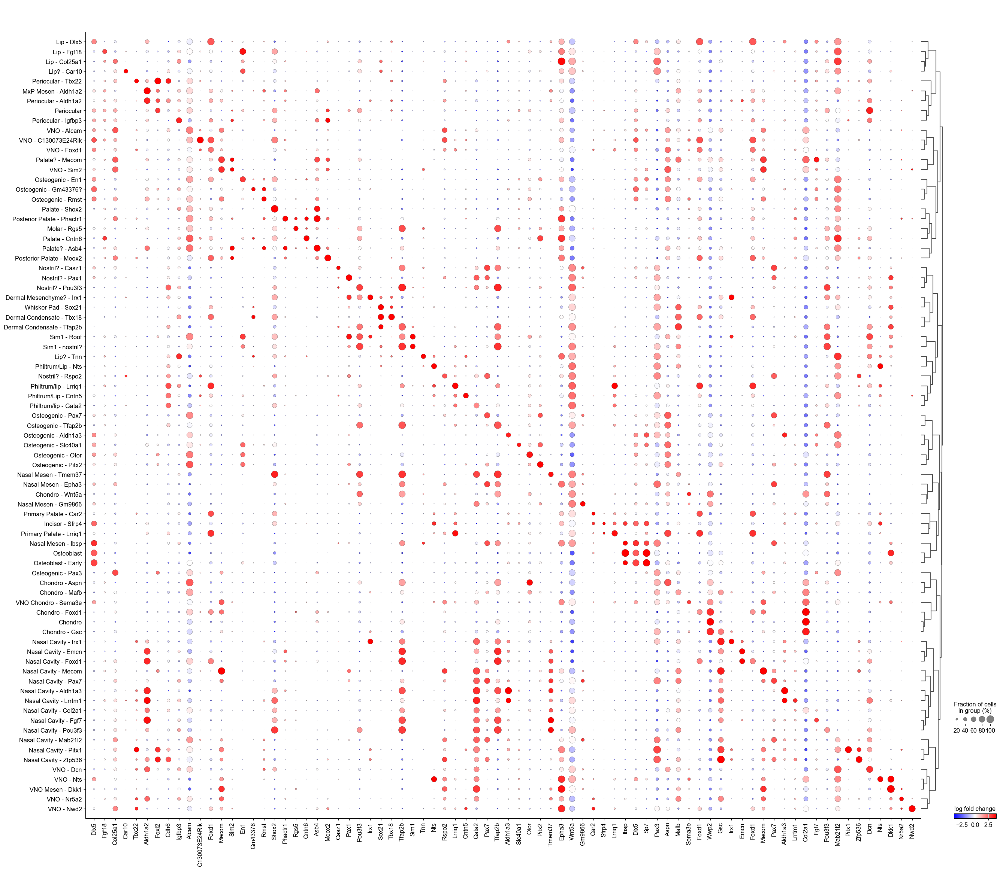

In [576]:
from pathlib import Path
sc._settings.ScanpyConfig.figdir=Path('./figures/new_figures_23_5_2024') #set figdir
genes = ['Dlx5','Fgf18','Col25a1','Car10','Tbx22','Aldh1a2','Foxl2','Cdh6','Igfbp3','Alcam','C130073E24Rik','Foxd1','Mecom','Sim2','En1','Gm43376','Rmst',
         'Shox2','Phactr1','Rgs5','Cntn6','Asb4','Meox2','Casz1','Pax1','Pou3f3','Irx1','Sox21','Tbx18','Tfap2b','Sim1','Tnn','Nts','Rspo2','Lrriq1','Cntn5',
         'Gata2','Pax7','Tfap2b','Aldh1a3','Slc40a1','Otor','Pitx2','Tmem37','Epha3','Wnt5a','Gm9866','Car2','Sfrp4','Lrriq1','Ibsp','Dlx5','Sp7',
         'Pax3','Aspn','Mafb','Sema3e','Foxd1','Wwp2','Gsc','Irx1','Emcn','Foxd1','Mecom','Pax7','Aldh1a3','Lrrtm1','Col2a1','Fgf7','Pou3f3','Mab21l2',
         'Pitx1','Zfp536','Dcn','Nts','Dkk1','Nr5a2','Nwd2']
sc.pl.rank_genes_groups_dotplot(adata_E13_mesen_filt_annotated,var_names = genes,groupby='E13_mesen_fine_14_2024',
             values_to_plot="logfoldchanges", cmap='bwr',
    vmin=-4,
    vmax=4,
                                #dendrogram = False,
                               save = 'E13_mesen_finest_manual.pdf')

1717407823.0429342: Regressing cell cycle
1717407852.656: Highly Variable Genes
1717407852.9666474: PCA
1717407853.0154316: Neighbors
1717407856.8385139: MDE and UMAP
1717407860.176912: Leiden clustering


/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


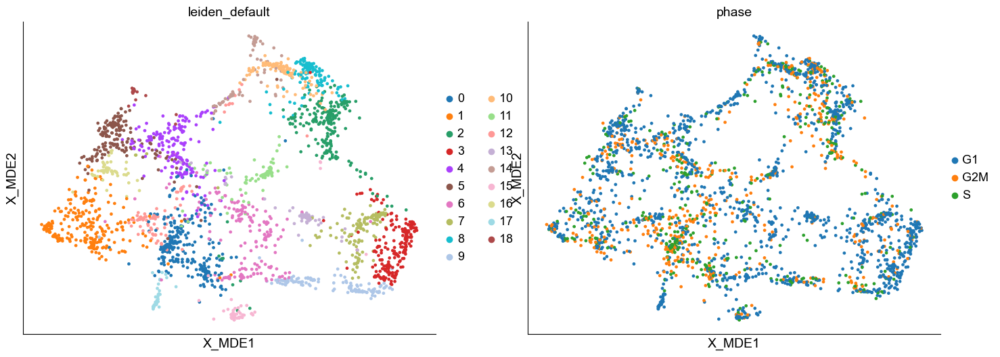

/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


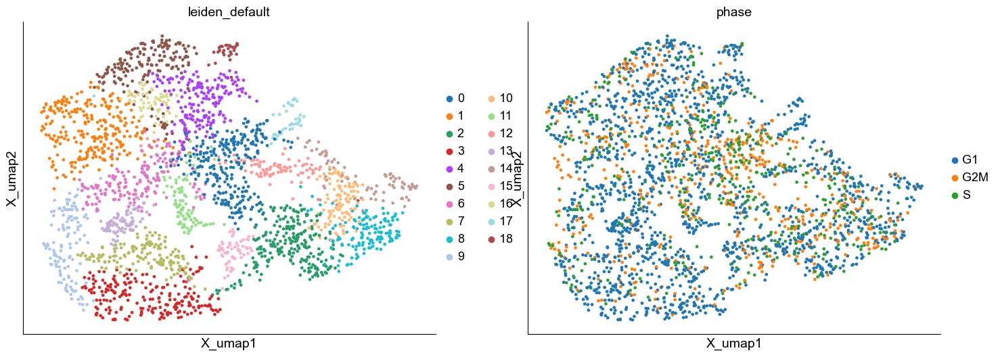

In [99]:
#time to subset stuff
adata_E13_dermal = adata_E13_mesen_filt[adata_E13_mesen_filt.obs['leiden_coarse'].isin(['2', '8', '11'])].copy()
default_regress_cycle_to_mde(adata_E13_dermal, n_neighbors = 10,n_comps=40, skip_preprocess = True, resolution = 1,n_top_genes = 1500)

In [100]:
# adata_E13_dermal.X = adata_E13_dermal.layers['original_counts'].copy()
# sc.pp.normalize_total(adata_E13_dermal, target_sum=1e4)
# sc.pp.log1p(adata_E13_dermal)

In [101]:
sc.tl.leiden(adata_E13_dermal, #name of anndata object
              resolution = .8, key_added = 'leiden_fine') #.8
sc.tl.leiden(adata_E13_dermal, #name of anndata object
              resolution = 1.6, key_added = 'leiden_fine2')

In [151]:
adata_E13_dermal.obs['E13_mesen_fine_14_2024'] = 'test'

adata_E13_dermal.obs.loc[adata_E13_dermal[adata_E13_dermal.obs['leiden_fine'] == '0'].obs.index,'E13_mesen_fine_14_2024'] = 'Philtrum/lip - Lrriq1' #Lrriq1, Pappa, Foxd1
adata_E13_dermal.obs.loc[adata_E13_dermal[adata_E13_dermal.obs['leiden_fine'] == '9'].obs.index,'E13_mesen_fine_14_2024'] = 'Philtrum/lip - Gata2' #Gata2, Msx2, Lrriq1_low
adata_E13_dermal.obs.loc[adata_E13_dermal[adata_E13_dermal.obs['leiden_fine'] == '6'].obs.index,'E13_mesen_fine_14_2024'] = 'Philtrum/Lip - Nts' #Nts
adata_E13_dermal.obs.loc[adata_E13_dermal[adata_E13_dermal.obs['leiden_fine'] == '8'].obs.index,'E13_mesen_fine_14_2024'] = 'Philtrum/Lip - Cntn5' #Cntnt5, Pappa
adata_E13_dermal.obs.loc[adata_E13_dermal[adata_E13_dermal.obs['leiden_fine'] == '1'].obs.index,'E13_mesen_fine_14_2024'] = 'Sim1 - Roof' #Hmx1, Sim1, Pcdh9, En1
adata_E13_dermal.obs.loc[adata_E13_dermal[adata_E13_dermal.obs['leiden_fine'] == '4'].obs.index,'E13_mesen_fine_14_2024'] = 'Sim1 - nostril?' #Sim1, Hmx1_low
adata_E13_dermal.obs.loc[adata_E13_dermal[adata_E13_dermal.obs['leiden_fine'] == '10'].obs.index,'E13_mesen_fine_14_2024'] = 'Nostril? - Rspo2' #Rspo2, Pax7
adata_E13_dermal.obs.loc[adata_E13_dermal[adata_E13_dermal.obs['leiden_fine'] == '2'].obs.index,'E13_mesen_fine_14_2024'] = 'Whisker Pad - Sox21'#Sox21
adata_E13_dermal.obs.loc[adata_E13_dermal[adata_E13_dermal.obs['leiden_fine'] == '3'].obs.index,'E13_mesen_fine_14_2024'] = 'Lip? - Tnn' #Tnn, Lhx8, Tbx15
adata_E13_dermal.obs.loc[adata_E13_dermal[adata_E13_dermal.obs['leiden_fine'] == '12'].obs.index,'E13_mesen_fine_14_2024'] = 'Dermal Condensate - Tfap2b'#Sox18, Tfap2b, Pla2g7, Fzd10, Cpxm2, Prss35
adata_E13_dermal.obs.loc[adata_E13_dermal[adata_E13_dermal.obs['leiden_fine'] == '14'].obs.index,'E13_mesen_fine_14_2024'] = 'Dermal Condensate - Tbx18' #Sox18, Tbx18,
adata_E13_dermal.obs.loc[adata_E13_dermal[adata_E13_dermal.obs['leiden_fine'] == '11'].obs.index,'E13_mesen_fine_14_2024'] = 'Dermal Mesenchyme? - Irx1' #Irx1, Nrxn3
adata_E13_dermal.obs.loc[adata_E13_dermal[adata_E13_dermal.obs['leiden_fine'] == '5'].obs.index,'E13_mesen_fine_14_2024'] = 'Lip? - Car10' #Car10, Dlk1, En1
adata_E13_dermal.obs.loc[adata_E13_dermal[adata_E13_dermal.obs['leiden_fine'] == '7'].obs.index,'E13_mesen_fine_14_2024'] = 'Lip - Fgf18' #fgf18, Fxyd7, En1 ; 5,7,15 and 13 are quite similar, with some select differences.
adata_E13_dermal.obs.loc[adata_E13_dermal[adata_E13_dermal.obs['leiden_fine'] == '15'].obs.index,'E13_mesen_fine_14_2024'] = 'Lip - Dlx5'
adata_E13_dermal.obs.loc[adata_E13_dermal[adata_E13_dermal.obs['leiden_fine'] == '13'].obs.index,'E13_mesen_fine_14_2024'] = 'Lip - Col25a1' #Gfra1, Col25a1
adata_E13_dermal.obs.loc[adata_E13_dermal[adata_E13_dermal.obs['leiden_fine'] == ''].obs.index,'E13_mesen_fine_14_2024'] = ''
adata_E13_dermal.obs.loc[adata_E13_dermal[adata_E13_dermal.obs['leiden_fine'] == ''].obs.index,'E13_mesen_fine_14_2024'] = ''
adata_E13_dermal.obs.loc[adata_E13_dermal[adata_E13_dermal.obs['leiden_fine'] == ''].obs.index,'E13_mesen_fine_14_2024'] = ''

/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


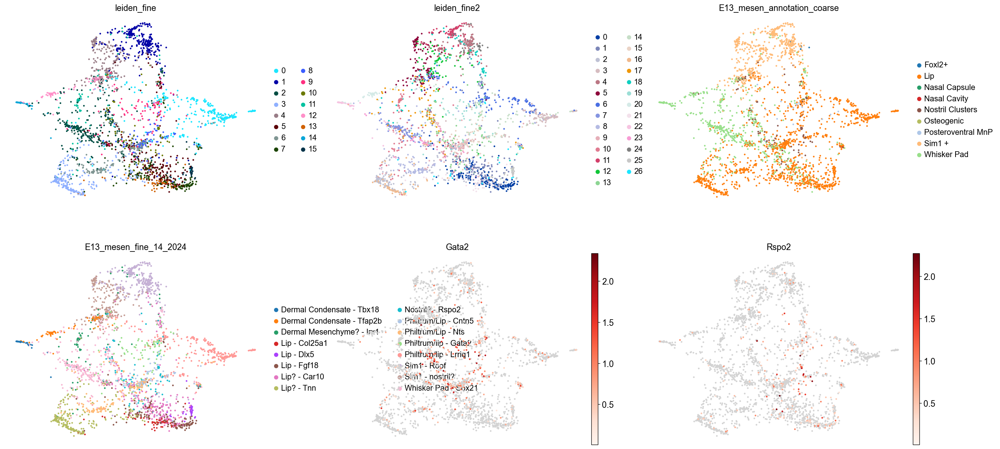

In [57]:
sc.set_figure_params(dpi=60,figsize=[8,6])

sc.pl.embedding(
    adata_E13_dermal,
    basis='X_MDE',
    color=['leiden_fine','leiden_fine2','E13_mesen_annotation_coarse','E13_mesen_fine_14_2024','Gata2','Rspo2'],
    #groups=['2'],
    frameon=False,
    ncols=3,
    size = 30,
    cmap = reds,
    vmin=0.01,
)


In [30]:
#adata_E13_dermal.write('anndata_objects/adata_E13_dermal.h5ad')
adata_E13_dermal = sc.read('anndata_objects/adata_E13_dermal.h5ad')

1717420488.0215125: Regressing cell cycle
1717420504.2119222: Highly Variable Genes
1717420504.2850413: PCA
1717420504.294998: Neighbors
1717420504.3151624: MDE and UMAP
1717420506.0092702: Leiden clustering


/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


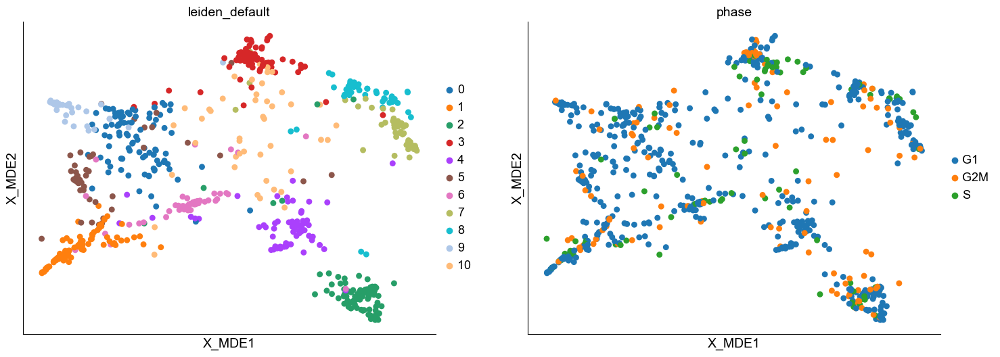

/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


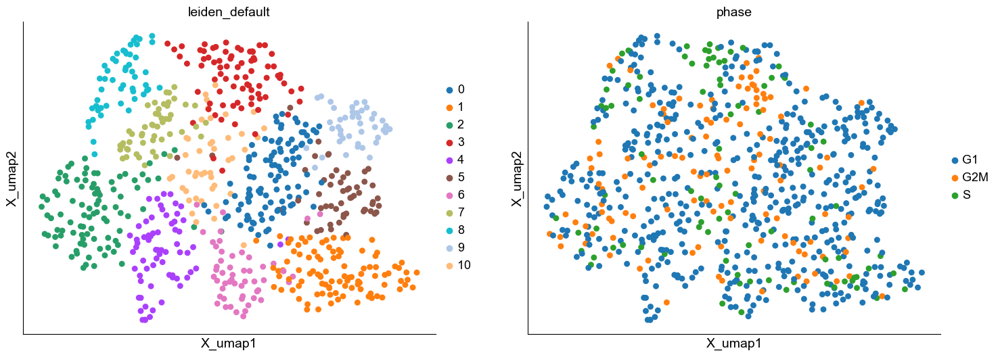

In [161]:
#vomer stuff
#time to subset stuff
adata_E13_vomer = adata_E13_mesen_filt[adata_E13_mesen_filt.obs['leiden_coarse'].isin(['9'])].copy()
default_regress_cycle_to_mde(adata_E13_vomer, n_neighbors = 10,n_comps=20, skip_preprocess = False, resolution = 1,n_top_genes = 100)

In [162]:
adata_E13_vomer.X = adata_E13_vomer.layers['original_counts'].copy()
sc.pp.normalize_total(adata_E13_vomer, target_sum=1e4)
sc.pp.log1p(adata_E13_vomer)

In [182]:
sc.tl.leiden(adata_E13_vomer, #name of anndata object
              resolution = 1, key_added = 'leiden_fine') #.5
sc.tl.leiden(adata_E13_vomer, #name of anndata object
              resolution = 1, key_added = 'leiden_fine2')

/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


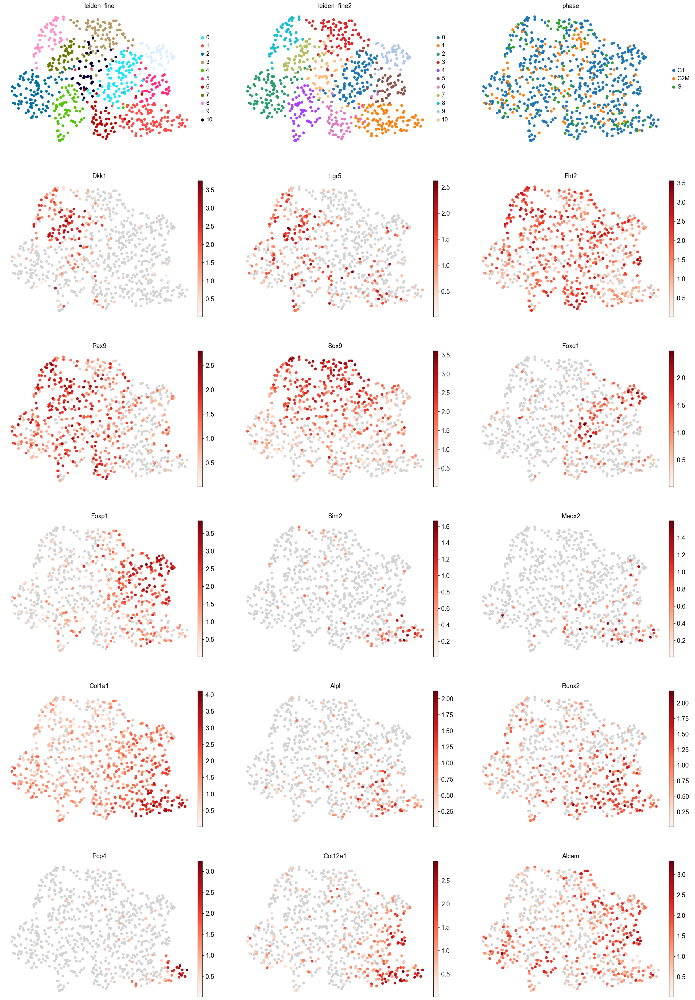

In [234]:
sc.set_figure_params(dpi=60,figsize=[8,6])

sc.pl.embedding(
    adata_E13_vomer,
    basis='X_umap',
    color=['leiden_fine','leiden_fine2','phase','Dkk1','Lgr5','Flrt2','Pax9','Sox9','Foxd1','Foxp1','Sim2','Meox2','Col1a1',
           'Alpl','Runx2','Pcp4','Col12a1','Alcam',],
    #groups=['2'],
    frameon=False,
    ncols=3,
    size = 150,
    cmap = reds,
    vmin=0.01,
)


/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


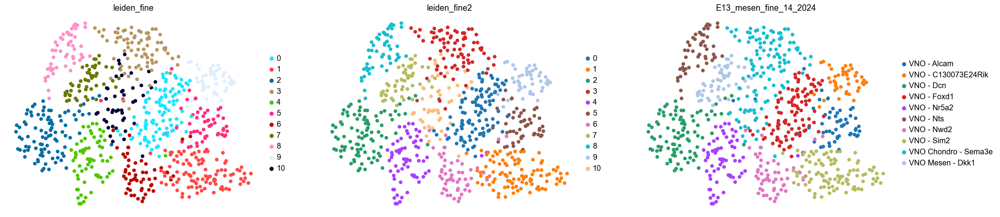

In [239]:
adata_E13_vomer.obs['E13_mesen_fine_14_2024'] = 'test'

adata_E13_vomer.obs.loc[adata_E13_vomer[adata_E13_vomer.obs['leiden_fine'] == '3'].obs.index,'E13_mesen_fine_14_2024'] = 'VNO Chondro - Sema3e' #Sox9, Sema3e, Wwp2, Cnmd
adata_E13_vomer.obs.loc[adata_E13_vomer[adata_E13_vomer.obs['leiden_fine'] == '7'].obs.index,'E13_mesen_fine_14_2024'] = 'VNO Mesen - Dkk1' #Dkk1, Lgr5,
adata_E13_vomer.obs.loc[adata_E13_vomer[adata_E13_vomer.obs['leiden_fine'] == '2'].obs.index,'E13_mesen_fine_14_2024'] = 'VNO - Dcn' #Pex5l, Dcn, Shox2
adata_E13_vomer.obs.loc[adata_E13_vomer[adata_E13_vomer.obs['leiden_fine'] == '8'].obs.index,'E13_mesen_fine_14_2024'] = 'VNO - Nts' #Nts, Dkk1, Lgr5
adata_E13_vomer.obs.loc[adata_E13_vomer[adata_E13_vomer.obs['leiden_fine'] == '4'].obs.index,'E13_mesen_fine_14_2024'] = 'VNO - Nr5a2' #Nr5a2, Cldn11
adata_E13_vomer.obs.loc[adata_E13_vomer[adata_E13_vomer.obs['leiden_fine'] == '6'].obs.index,'E13_mesen_fine_14_2024'] = 'VNO - Nwd2' #
adata_E13_vomer.obs.loc[adata_E13_vomer[adata_E13_vomer.obs['leiden_fine'] == '9'].obs.index,'E13_mesen_fine_14_2024'] = 'VNO - C130073E24Rik' #C130073E24Rik, Shox2, Slitrk3, Foxd1, Foxp2, Foxp1, Foxf2 Rprm, Ezr #Rprm is implicated in cell cycle, but according to cell cycle inference this cluster is no different from cluster 0. There must be something special about these cells
adata_E13_vomer.obs.loc[adata_E13_vomer[adata_E13_vomer.obs['leiden_fine'] == '0'].obs.index,'E13_mesen_fine_14_2024'] = 'VNO - Foxd1' #Foxd1, 'Foxp1' Igf1 #Lacks a bunch of key markers in cluster 9, but is otherwise very similar
adata_E13_vomer.obs.loc[adata_E13_vomer[adata_E13_vomer.obs['leiden_fine'] == '1'].obs.index,'E13_mesen_fine_14_2024'] = 'VNO - Sim2' #Sim2 and some Meox2. Initially thought posterior palate, but I'm pretty convinced it's not. gp3 shows some sim2 below VNO, but no meox2. It's Flrt2+ but Pax9-, It's strange. I don't think this is posterior palate. Its interesting for sure. Col1a1 high but that's not very telling. Has Alpl, Col12a1, Runx2, Dlk1, Pcp4 very strong at tip of umap. Pcp4 has one very interesting looking insitu on gp3. I think this is bone related 
adata_E13_vomer.obs.loc[adata_E13_vomer[adata_E13_vomer.obs['leiden_fine'] == '5'].obs.index,'E13_mesen_fine_14_2024'] = 'VNO - Alcam' #Alcam, Runx2, Foxp1, Col12a1. Strange cluster as well. Similar to both 1 and 0. Lacks some of their marker genes.
adata_E13_vomer.obs.loc[adata_E13_vomer[adata_E13_vomer.obs['leiden_fine'] == '10'].obs.index,'E13_mesen_fine_14_2024'] = 'VNO Chondro - Sema3e' #Pretty much same as 3, but in a less differentiated state? Less chondro markers present. Only a couple of cells, so I will just combine them
adata_E13_vomer.obs.loc[adata_E13_vomer[adata_E13_vomer.obs['leiden_fine'] == ''].obs.index,'E13_mesen_fine_14_2024'] = '' #
adata_E13_vomer.obs.loc[adata_E13_vomer[adata_E13_vomer.obs['leiden_fine'] == ''].obs.index,'E13_mesen_fine_14_2024'] = '' #

sc.set_figure_params(dpi=60,figsize=[8,6])

sc.pl.embedding(
    adata_E13_vomer,
    basis='X_umap',
    color=['leiden_fine','leiden_fine2','E13_mesen_fine_14_2024',],
    #groups=['2'],
    frameon=False,
    ncols=3,
    size = 150,
    cmap = reds,
    vmin=0.01,
)

In [7]:
#adata_E13_vomer.write('anndata_objects/adata_E13_vomer.h5ad')
adata_E13_vomer=sc.read('anndata_objects/adata_E13_vomer.h5ad')

1718035935.7972121: Regressing cell cycle
1718035967.696872: Highly Variable Genes
1718035967.9499238: PCA
1718035967.986926: Neighbors
1718035968.1300383: MDE and UMAP
1718035971.1138332: Leiden clustering


/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


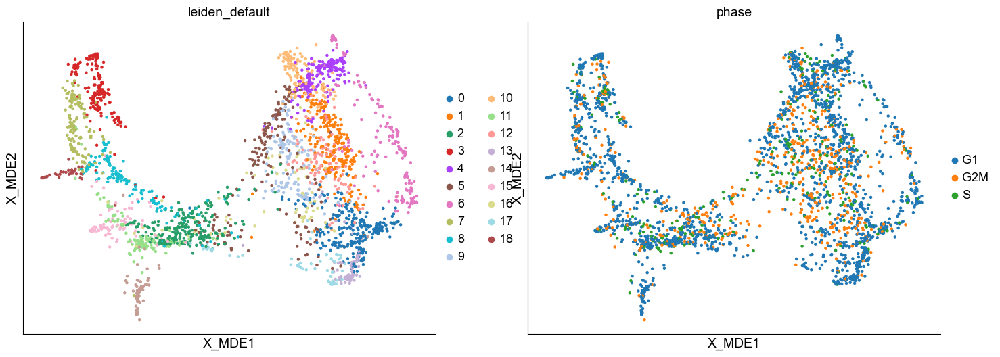

/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


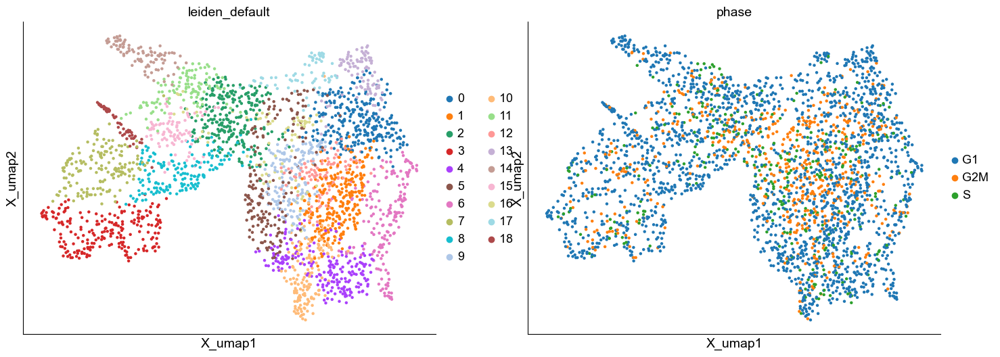

In [244]:
#chondro stuff
#time to subset stuff
adata_E13_chondro = adata_E13_mesen_filt[adata_E13_mesen_filt.obs['leiden_coarse'].isin(['0','1'])].copy()
default_regress_cycle_to_mde(adata_E13_chondro, n_neighbors = 10,n_comps=20, skip_preprocess = False, resolution = 1,n_top_genes = 1000)

In [254]:
adata_E13_chondro.X = adata_E13_chondro.layers['original_counts'].copy()
sc.pp.normalize_total(adata_E13_chondro, target_sum=1e4)
sc.pp.log1p(adata_E13_chondro)

In [293]:
sc.tl.leiden(adata_E13_chondro, #name of anndata object
              resolution = .8, key_added = 'leiden_fine') #.8
sc.tl.leiden(adata_E13_chondro, #name of anndata object
              resolution = 1.4, key_added = 'leiden_fine2')

/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


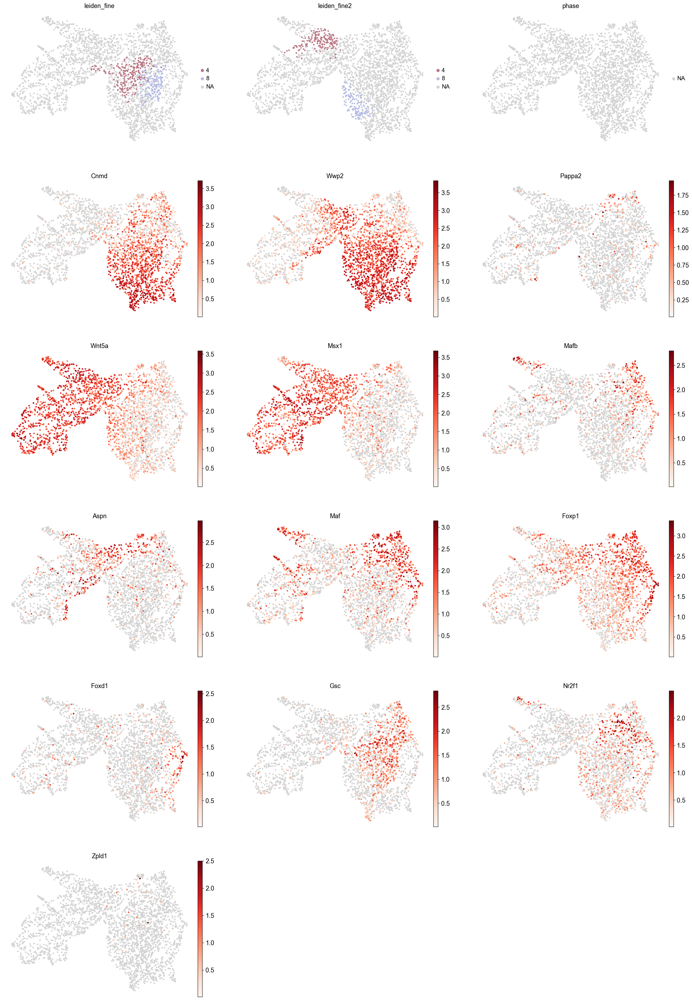

In [317]:
sc.set_figure_params(dpi=60,figsize=[8,6])

sc.pl.embedding(
    adata_E13_chondro,
    basis='X_umap',
    color=['leiden_fine','leiden_fine2','phase','Cnmd','Wwp2','Pappa2','Wnt5a','Msx1','Mafb','Aspn','Maf','Foxp1','Foxd1','Gsc',
           'Nr2f1','Zpld1'],
    groups=['4','8'],
    frameon=False,
    ncols=3,
    size = 50,
    cmap = reds,
    vmin=0.01,
)


/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


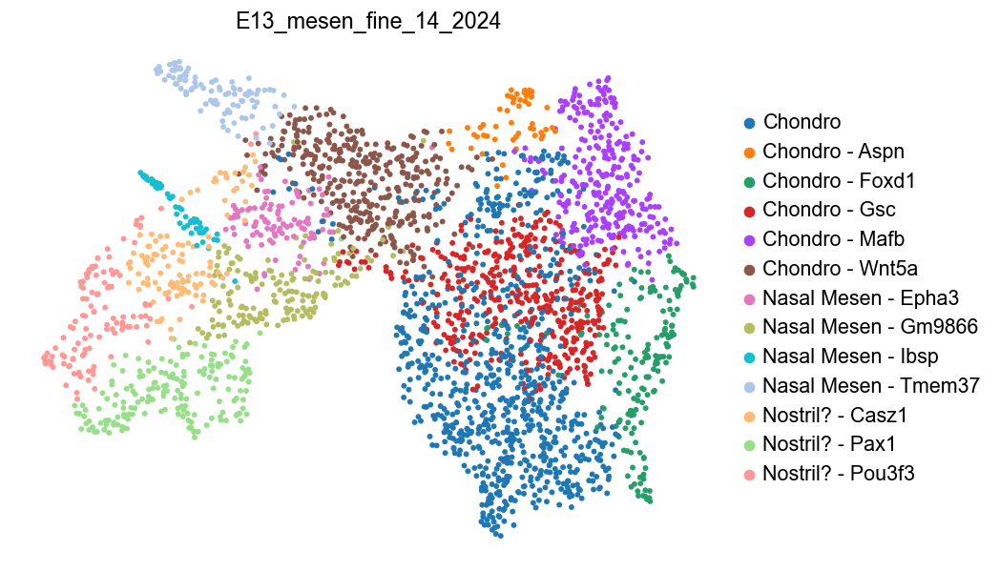

In [318]:
adata_E13_chondro.obs['E13_mesen_fine_14_2024'] = 'test'

adata_E13_chondro.obs.loc[adata_E13_chondro[adata_E13_chondro.obs['leiden_fine'] == '12'].obs.index,'E13_mesen_fine_14_2024'] = 'Nasal Mesen - Tmem37' #Tmem37, Olfm1, Probably should join one of the nasal cavity clusters. I think it's just in between. I guess the nasal cavity is recruited for the nasal capsule condensation
adata_E13_chondro.obs.loc[adata_E13_chondro[adata_E13_chondro.obs['leiden_fine'] == '7'].obs.index,'E13_mesen_fine_14_2024'] = 'Nostril? - Casz1' #Casz1, Tfap2b
adata_E13_chondro.obs.loc[adata_E13_chondro[adata_E13_chondro.obs['leiden_fine'] == '5'].obs.index,'E13_mesen_fine_14_2024'] = 'Nostril? - Pax1' #Pax1, Osr1
adata_E13_chondro.obs.loc[adata_E13_chondro[adata_E13_chondro.obs['leiden_fine'] == '0'].obs.index,'E13_mesen_fine_14_2024'] = 'Chondro - Wnt5a' #Wnt5a, Pou3f3, Wwp2, Similar to cluster 12, but lacking tmem37 and olfm1
adata_E13_chondro.obs.loc[adata_E13_chondro[adata_E13_chondro.obs['leiden_fine'] == '10'].obs.index,'E13_mesen_fine_14_2024'] = 'Nasal Mesen - Gm9866' #Gm9866, Igfbp7, Satb2, Wwp2
adata_E13_chondro.obs.loc[adata_E13_chondro[adata_E13_chondro.obs['leiden_fine'] == '15'].obs.index,'E13_mesen_fine_14_2024'] = 'Nasal Mesen - Ibsp' #Ibsp, Bmp3, Wif1, Dlx5, Alpl
adata_E13_chondro.obs.loc[adata_E13_chondro[adata_E13_chondro.obs['leiden_fine'] == '11'].obs.index,'E13_mesen_fine_14_2024'] = 'Nasal Mesen - Epha3' #Epha3, Tceal6, Pax7, Arpp21
adata_E13_chondro.obs.loc[adata_E13_chondro[adata_E13_chondro.obs['leiden_fine'] == '14'].obs.index,'E13_mesen_fine_14_2024'] = 'Chondro - Aspn' #Aspn, Pappa2, this cluster feels like a mix between cluster 0 and 1, some area where they overlap
adata_E13_chondro.obs.loc[adata_E13_chondro[adata_E13_chondro.obs['leiden_fine'] == '1'].obs.index,'E13_mesen_fine_14_2024'] = 'Chondro - Mafb' #Mafb, Maf, Similar to cluster 14, with the maf expression
adata_E13_chondro.obs.loc[adata_E13_chondro[adata_E13_chondro.obs['leiden_fine'] == '9'].obs.index,'E13_mesen_fine_14_2024'] = 'Chondro - Foxd1' #
adata_E13_chondro.obs.loc[adata_E13_chondro[adata_E13_chondro.obs['leiden_fine'] == '3'].obs.index,'E13_mesen_fine_14_2024'] = 'Chondro' #
adata_E13_chondro.obs.loc[adata_E13_chondro[adata_E13_chondro.obs['leiden_fine'] == '6'].obs.index,'E13_mesen_fine_14_2024'] = 'Chondro' #
adata_E13_chondro.obs.loc[adata_E13_chondro[adata_E13_chondro.obs['leiden_fine'] == '8'].obs.index,'E13_mesen_fine_14_2024'] = 'Chondro - Gsc' #
adata_E13_chondro.obs.loc[adata_E13_chondro[adata_E13_chondro.obs['leiden_fine'] == '4'].obs.index,'E13_mesen_fine_14_2024'] = 'Chondro - Gsc' #
adata_E13_chondro.obs.loc[adata_E13_chondro[adata_E13_chondro.obs['leiden_fine'] == '2'].obs.index,'E13_mesen_fine_14_2024'] = 'Chondro' #
adata_E13_chondro.obs.loc[adata_E13_chondro[adata_E13_chondro.obs['leiden_fine'] == '13'].obs.index,'E13_mesen_fine_14_2024'] = 'Chondro' #
adata_E13_chondro.obs.loc[adata_E13_chondro[adata_E13_chondro.obs['leiden_fine'] == ''].obs.index,'E13_mesen_fine_14_2024'] = '' #


adata_E13_chondro.obs.loc[adata_E13_chondro[adata_E13_chondro.obs['leiden_fine2'] == '16'].obs.index,'E13_mesen_fine_14_2024'] = 'Nostril? - Casz1' #Casz1, Tfap2b
adata_E13_chondro.obs.loc[adata_E13_chondro[adata_E13_chondro.obs['leiden_fine2'] == '2'].obs.index,'E13_mesen_fine_14_2024'] = 'Nostril? - Pax1' #Pax1, AI646519(lncrna next to pax1) Osr1 (tfap2b-)
adata_E13_chondro.obs.loc[adata_E13_chondro[adata_E13_chondro.obs['leiden_fine2'] == '14'].obs.index,'E13_mesen_fine_14_2024'] = 'Nostril? - Pou3f3' #Pou3f3, Tfap2b, Hey2
adata_E13_chondro.obs.loc[adata_E13_chondro[adata_E13_chondro.obs['leiden_fine2'] == ''].obs.index,'E13_mesen_fine_14_2024'] = '' #
adata_E13_chondro.obs.loc[adata_E13_chondro[adata_E13_chondro.obs['leiden_fine2'] == ''].obs.index,'E13_mesen_fine_14_2024'] = '' #
adata_E13_chondro.obs.loc[adata_E13_chondro[adata_E13_chondro.obs['leiden_fine2'] == ''].obs.index,'E13_mesen_fine_14_2024'] = '' #
adata_E13_chondro.obs.loc[adata_E13_chondro[adata_E13_chondro.obs['leiden_fine2'] == ''].obs.index,'E13_mesen_fine_14_2024'] = '' #
adata_E13_chondro.obs.loc[adata_E13_chondro[adata_E13_chondro.obs['leiden_fine2'] == ''].obs.index,'E13_mesen_fine_14_2024'] = '' #
adata_E13_chondro.obs.loc[adata_E13_chondro[adata_E13_chondro.obs['leiden_fine2'] == ''].obs.index,'E13_mesen_fine_14_2024'] = '' #
adata_E13_chondro.obs.loc[adata_E13_chondro[adata_E13_chondro.obs['leiden_fine2'] == ''].obs.index,'E13_mesen_fine_14_2024'] = '' #
adata_E13_chondro.obs.loc[adata_E13_chondro[adata_E13_chondro.obs['leiden_fine2'] == ''].obs.index,'E13_mesen_fine_14_2024'] = '' #
adata_E13_chondro.obs.loc[adata_E13_chondro[adata_E13_chondro.obs['leiden_fine2'] == ''].obs.index,'E13_mesen_fine_14_2024'] = '' #
adata_E13_chondro.obs.loc[adata_E13_chondro[adata_E13_chondro.obs['leiden_fine2'] == ''].obs.index,'E13_mesen_fine_14_2024'] = '' #

sc.set_figure_params(dpi=60,figsize=[8,6])

sc.pl.embedding(
    adata_E13_chondro,
    basis='X_umap',
    color=['E13_mesen_fine_14_2024'],
    #groups=['4','8'],
    frameon=False,
    ncols=3,
    size = 50,
    cmap = reds,
    vmin=0.01,
)

In [8]:
#adata_E13_chondro.write('anndata_objects/adata_E13_chondro.h5ad')
adata_E13_chondro = sc.read('anndata_objects/adata_E13_chondro.h5ad')

/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


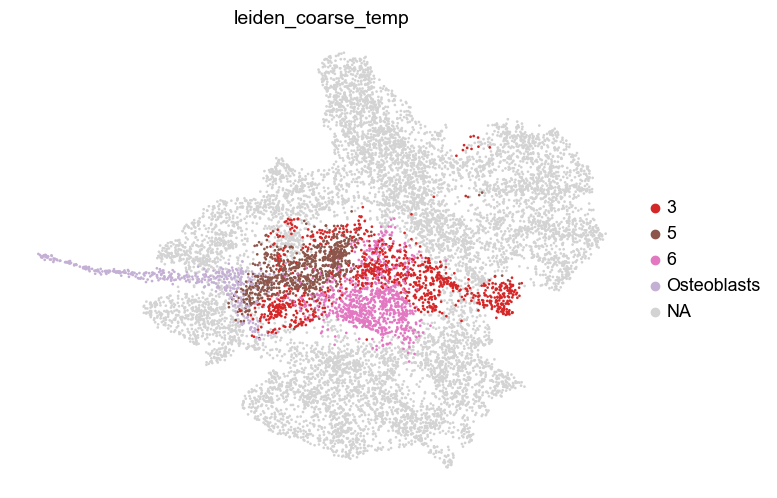

In [322]:
adata_E13_mesen_filt.obs['leiden_coarse_temp'] = list(adata_E13_mesen_filt.obs['leiden_coarse'])
adata_E13_mesen_filt.obs.loc[adata_E13_mesen_filt[adata_E13_mesen_filt.obs['E13_mesen_annotation_coarse'] == 'Osteoblasts'].obs.index,'leiden_coarse_temp'] = 'Osteoblasts' #
sc.pl.embedding(
    adata_E13_mesen_filt,
    size=15,
    basis='X_umap',
    color=['leiden_coarse_temp'],
    groups=['3','6','5','Osteoblasts'],
   # groups=['14','18'],
    #legend_loc = 'on data',
    frameon=False,
    ncols=3,
    cmap = reds,
    vmin=0.1,
    #vmax=10,
    #layer='original_counts',
)

1718135411.2854762: Regressing cell cycle
1718135444.2822182: Highly Variable Genes
1718135444.5846045: PCA
1718135444.6106758: Neighbors
1718135444.7419422: MDE and UMAP
1718135448.256643: Leiden clustering


/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


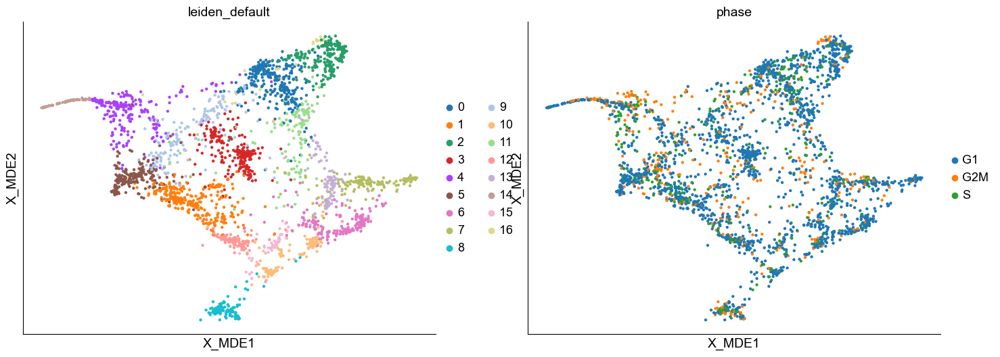

/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


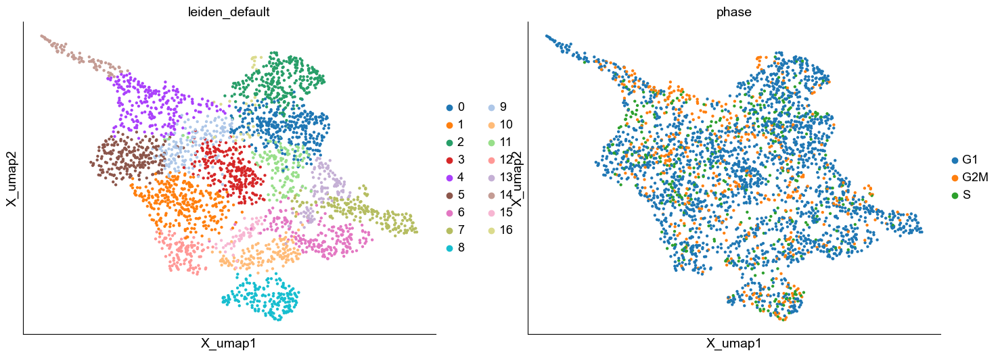

In [323]:
#osteogenic stuff
#time to subset stuff
adata_E13_osteogenic = adata_E13_mesen_filt[adata_E13_mesen_filt.obs['leiden_coarse_temp'].isin(['3','6','5','Osteoblasts'])].copy()
default_regress_cycle_to_mde(adata_E13_osteogenic, n_neighbors = 10,n_comps=20, skip_preprocess = False, resolution = 1,n_top_genes = 1000)

In [324]:
adata_E13_osteogenic.X = adata_E13_osteogenic.layers['original_counts'].copy()
sc.pp.normalize_total(adata_E13_osteogenic, target_sum=1e4)
sc.pp.log1p(adata_E13_osteogenic)

In [370]:
sc.tl.leiden(adata_E13_osteogenic, #name of anndata object
              resolution = 1.4, key_added = 'leiden_fine') #.8
sc.tl.leiden(adata_E13_osteogenic, #name of anndata object
              resolution = 1.8, key_added = 'leiden_fine2')

/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


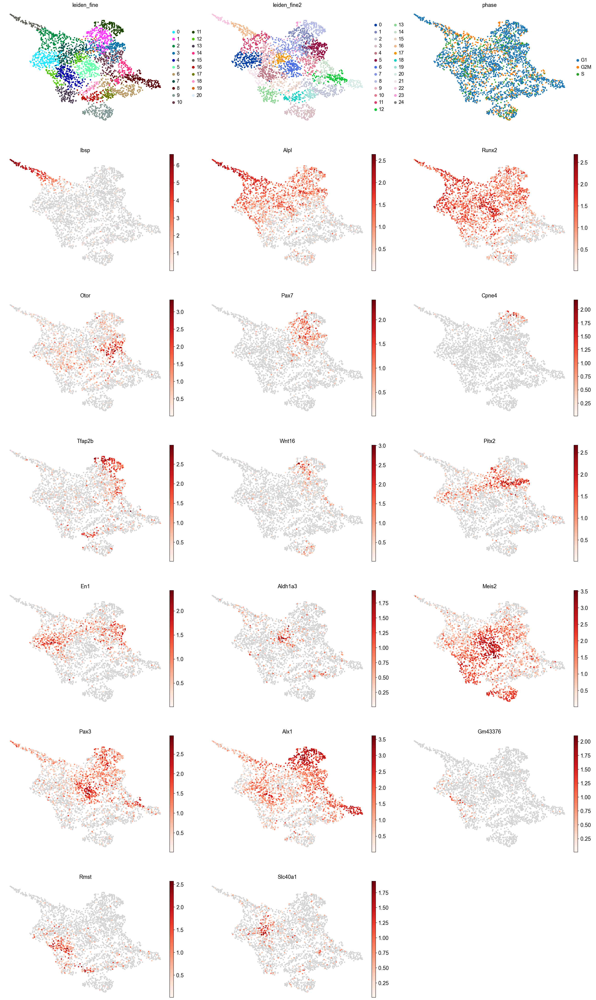

In [382]:
sc.set_figure_params(dpi=60,figsize=[8,6])

sc.pl.embedding(
    adata_E13_osteogenic,
    basis='X_umap',
    color=['leiden_fine','leiden_fine2','phase','Ibsp','Alpl','Runx2','Otor','Pax7','Cpne4','Tfap2b','Wnt16',
           'Pitx2','En1','Aldh1a3','Meis2','Pax3','Alx1','Gm43376','Rmst','Slc40a1',],
    #groups=['20'],
    frameon=False,
    ncols=3,
    size = 50,
    cmap = reds,
    vmin=0.01,
)


/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


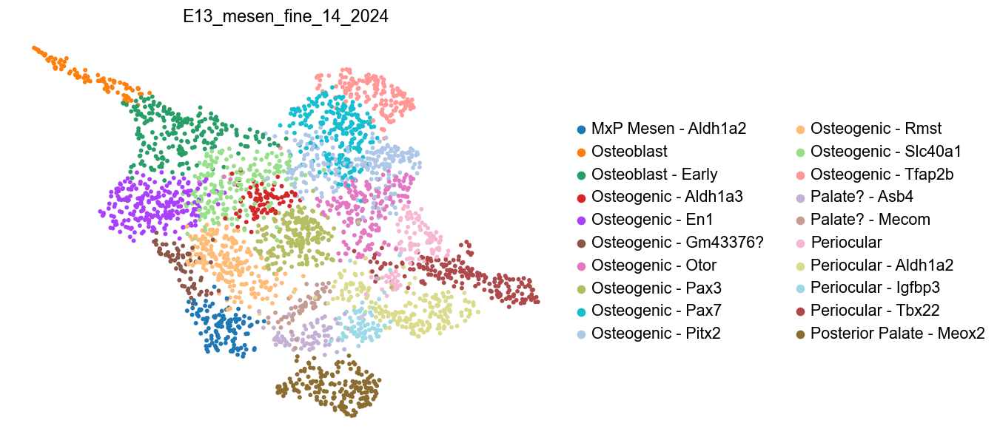

In [383]:
adata_E13_osteogenic.obs['E13_mesen_fine_14_2024'] = 'test'

adata_E13_osteogenic.obs.loc[adata_E13_osteogenic[adata_E13_osteogenic.obs['leiden_fine'] == '8'].obs.index,'E13_mesen_fine_14_2024'] = 'Periocular - Tbx22' #Foxl2, Tbx22, Cdh6
adata_E13_osteogenic.obs.loc[adata_E13_osteogenic[adata_E13_osteogenic.obs['leiden_fine'] == '9'].obs.index,'E13_mesen_fine_14_2024'] = 'Posterior Palate - Meox2' #Meox2, Foxf2, Barx1
adata_E13_osteogenic.obs.loc[adata_E13_osteogenic[adata_E13_osteogenic.obs['leiden_fine'] == '14'].obs.index,'E13_mesen_fine_14_2024'] = 'Periocular' #No real unique stuff, but lacks Tbx22 and Cdh6
adata_E13_osteogenic.obs.loc[adata_E13_osteogenic[adata_E13_osteogenic.obs['leiden_fine'] == '17'].obs.index,'E13_mesen_fine_14_2024'] = 'Periocular - Igfbp3' #
adata_E13_osteogenic.obs.loc[adata_E13_osteogenic[adata_E13_osteogenic.obs['leiden_fine'] == '6'].obs.index,'E13_mesen_fine_14_2024'] = 'Periocular - Aldh1a2' #Aldh1a2, Foxl2
adata_E13_osteogenic.obs.loc[adata_E13_osteogenic[adata_E13_osteogenic.obs['leiden_fine'] == '13'].obs.index,'E13_mesen_fine_14_2024'] = 'MxP Mesen - Aldh1a2' #Aldh1a2, Barx1, Meis2, Fas (no foxl2)
adata_E13_osteogenic.obs.loc[adata_E13_osteogenic[adata_E13_osteogenic.obs['leiden_fine'] == '16'].obs.index,'E13_mesen_fine_14_2024'] = 'Palate? - Asb4' #Asb4, Barx1, Sim2,Dlx1/2, probably needs to be together with the rest of the palate?
adata_E13_osteogenic.obs.loc[adata_E13_osteogenic[adata_E13_osteogenic.obs['leiden_fine'] == '18'].obs.index,'E13_mesen_fine_14_2024'] = 'Palate? - Mecom' #Mecom, Barx1, Sim2, (no asb4) I think this and 16 are part of the posterior palate, they have sim2, but lack meox2
adata_E13_osteogenic.obs.loc[adata_E13_osteogenic[adata_E13_osteogenic.obs['leiden_fine'] == '2'].obs.index,'E13_mesen_fine_14_2024'] = 'Osteoblast - Early' #Lacks some of the more differentiated genes. Low in Ibsp
adata_E13_osteogenic.obs.loc[adata_E13_osteogenic[adata_E13_osteogenic.obs['leiden_fine'] == '15'].obs.index,'E13_mesen_fine_14_2024'] = 'Osteoblast' #Ibsp_high, Col24a1, Col11a2, Col22a1
adata_E13_osteogenic.obs.loc[adata_E13_osteogenic[adata_E13_osteogenic.obs['leiden_fine'] == '10'].obs.index,'E13_mesen_fine_14_2024'] = 'Osteogenic - Otor' #Runx2, Otor, While otor is something ear related, there is some otor expression above the nose on genepaint, that is bone related it seems
adata_E13_osteogenic.obs.loc[adata_E13_osteogenic[adata_E13_osteogenic.obs['leiden_fine'] == '1'].obs.index,'E13_mesen_fine_14_2024'] = 'Osteogenic - Pax7' #Pax7, Wnt16, Runx2, Alpl
adata_E13_osteogenic.obs.loc[adata_E13_osteogenic[adata_E13_osteogenic.obs['leiden_fine'] == '11'].obs.index,'E13_mesen_fine_14_2024'] = 'Osteogenic - Tfap2b' #Tfap2b, Pou3f3, Cpne4, Runx2, Alpl
adata_E13_osteogenic.obs.loc[adata_E13_osteogenic[adata_E13_osteogenic.obs['leiden_fine'] == '3'].obs.index,'E13_mesen_fine_14_2024'] = 'Osteogenic - Pitx2' #Pitx2, En1, Runx2, Alpl
adata_E13_osteogenic.obs.loc[adata_E13_osteogenic[adata_E13_osteogenic.obs['leiden_fine'] == '19'].obs.index,'E13_mesen_fine_14_2024'] = 'Osteogenic - Pitx2' #same but cell cycle
adata_E13_osteogenic.obs.loc[adata_E13_osteogenic[adata_E13_osteogenic.obs['leiden_fine'] == '5'].obs.index,'E13_mesen_fine_14_2024'] = 'Osteogenic - Pax3' #
adata_E13_osteogenic.obs.loc[adata_E13_osteogenic[adata_E13_osteogenic.obs['leiden_fine'] == '12'].obs.index,'E13_mesen_fine_14_2024'] = 'Osteogenic - Gm43376?' #Was conbined with the aldh1a3 cluster, couldn't find a god marker, maybe it doesn't have any
adata_E13_osteogenic.obs.loc[adata_E13_osteogenic[adata_E13_osteogenic.obs['leiden_fine'] == '4'].obs.index,'E13_mesen_fine_14_2024'] = 'Osteogenic - Rmst' #Similar to the leftover bit of 12. But that part of 12 lacks some important factors like Alx1. Strange
adata_E13_osteogenic.obs.loc[adata_E13_osteogenic[adata_E13_osteogenic.obs['leiden_fine'] == '7'].obs.index,'E13_mesen_fine_14_2024'] = 'Osteogenic - Slc40a1' #Slc40a1
adata_E13_osteogenic.obs.loc[adata_E13_osteogenic[adata_E13_osteogenic.obs['leiden_fine'] == '20'].obs.index,'E13_mesen_fine_14_2024'] = 'Osteogenic - Slc40a1' #
adata_E13_osteogenic.obs.loc[adata_E13_osteogenic[adata_E13_osteogenic.obs['leiden_fine'] == '0'].obs.index,'E13_mesen_fine_14_2024'] = 'Osteogenic - En1' #En1, Frzb, Lhx8, Cntn4, Lhx6, 
adata_E13_osteogenic.obs.loc[adata_E13_osteogenic[adata_E13_osteogenic.obs['leiden_fine'] == ''].obs.index,'E13_mesen_fine_14_2024'] = '' #


adata_E13_osteogenic.obs.loc[adata_E13_osteogenic[adata_E13_osteogenic.obs['leiden_fine2'] == '17'].obs.index,'E13_mesen_fine_14_2024'] = 'Osteogenic - Aldh1a3' #
adata_E13_osteogenic.obs.loc[adata_E13_osteogenic[adata_E13_osteogenic.obs['leiden_fine2'] == ''].obs.index,'E13_mesen_fine_14_2024'] = '' #
adata_E13_osteogenic.obs.loc[adata_E13_osteogenic[adata_E13_osteogenic.obs['leiden_fine2'] == ''].obs.index,'E13_mesen_fine_14_2024'] = '' #
adata_E13_osteogenic.obs.loc[adata_E13_osteogenic[adata_E13_osteogenic.obs['leiden_fine2'] == ''].obs.index,'E13_mesen_fine_14_2024'] = '' #
adata_E13_osteogenic.obs.loc[adata_E13_osteogenic[adata_E13_osteogenic.obs['leiden_fine2'] == ''].obs.index,'E13_mesen_fine_14_2024'] = '' #
adata_E13_osteogenic.obs.loc[adata_E13_osteogenic[adata_E13_osteogenic.obs['leiden_fine2'] == ''].obs.index,'E13_mesen_fine_14_2024'] = '' #


sc.pl.embedding(
    adata_E13_osteogenic,
    basis='X_umap',
    color=['E13_mesen_fine_14_2024',],
    #groups=['20'],
    frameon=False,
    ncols=3,
    size = 50,
    cmap = reds,
    vmin=0.01,
)

In [89]:
#adata_E13_osteogenic.write('anndata_objects/adata_E13_osteogenic.h5ad')
adata_E13_osteogenic = sc.read('anndata_objects/adata_E13_osteogenic.h5ad')

In [10]:
#adata_E13_nasal_cavity.write('anndata_objects/adata_E13_nasal_cavity.h5ad')
adata_E13_nasal_cavity = sc.read('anndata_objects/adata_E13_nasal_cavity.h5ad')

1718198884.5984497: Regressing cell cycle
1718198907.6604078: Highly Variable Genes
1718198907.8053043: PCA
1718198907.8259108: Neighbors
1718198907.881858: MDE and UMAP
1718198909.951051: Leiden clustering


/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


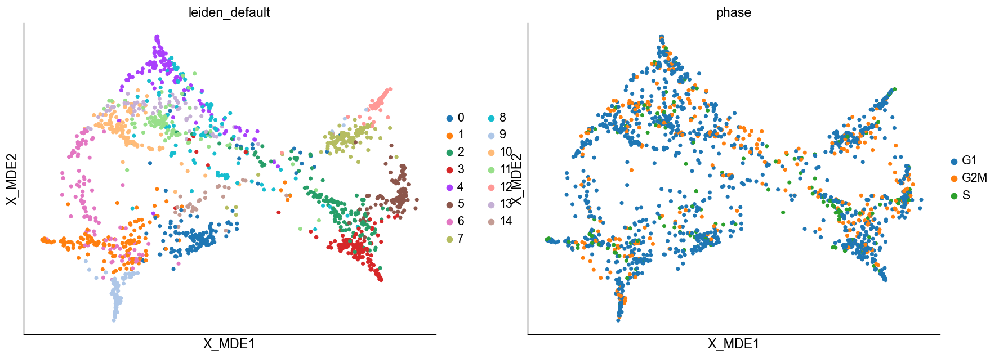

/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


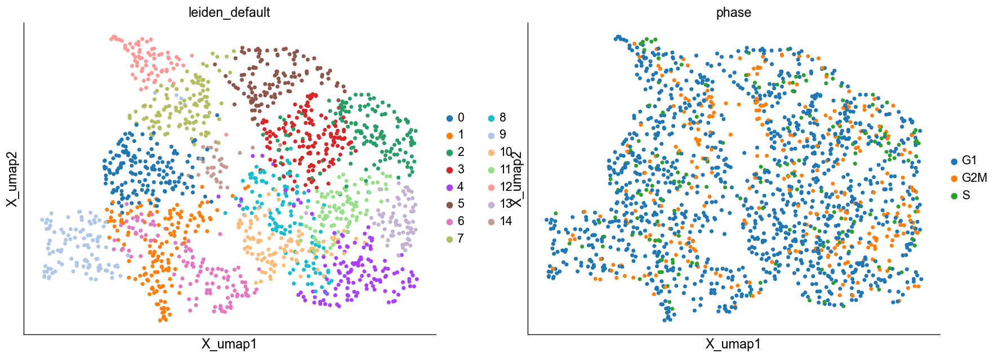

In [415]:
#chondro stuff
#time to subset stuff
adata_E13_nasal_cavity = adata_E13_mesen_filt[adata_E13_mesen_filt.obs['leiden_coarse'].isin(['4','10'])].copy()
default_regress_cycle_to_mde(adata_E13_nasal_cavity, n_neighbors = 8,n_comps=20, skip_preprocess = False, resolution = 1,n_top_genes = 1000)

In [416]:
adata_E13_nasal_cavity.X = adata_E13_nasal_cavity.layers['original_counts'].copy()
sc.pp.normalize_total(adata_E13_nasal_cavity, target_sum=1e4)
sc.pp.log1p(adata_E13_nasal_cavity)

/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


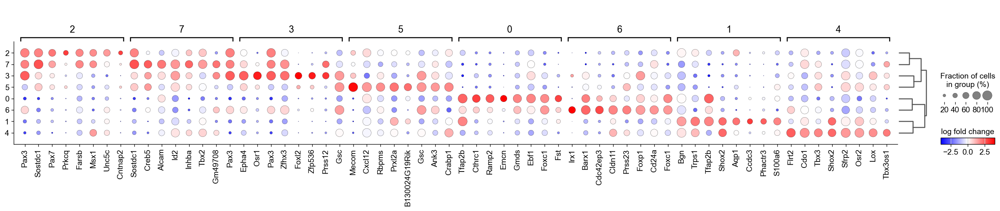

In [522]:
sc.tl.rank_genes_groups(adata_E13_nasal_cavity,groupby = 'leiden_fine3',
                        method = 't-test_overestim_var',
                        #method = 'wilcoxon',
                       )

sc.tl.dendrogram(adata_E13_nasal_cavity, groupby = 'leiden_fine3',)
sc.pl.rank_genes_groups_dotplot(adata_E13_nasal_cavity,
                                n_genes=8,
                                values_to_plot="logfoldchanges", cmap='bwr',
    vmin=-4,
    vmax=4,
    min_logfoldchange=1.5,
                                #dendrogram = False,
                                #mean_only_expressed=True,
                               #dot_max = 0.5, 
                                #save = 'automatic.pdf'
                               )

/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


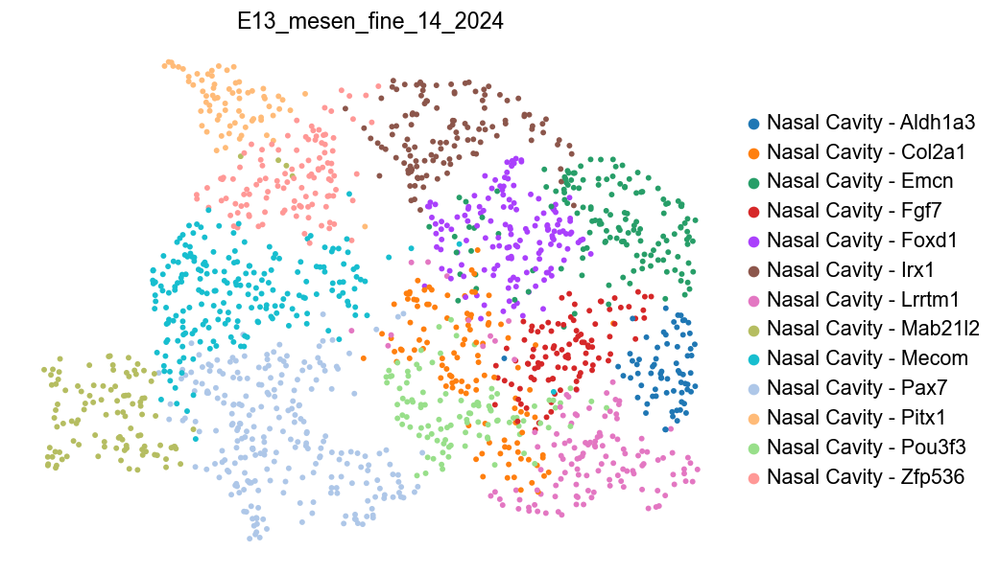

In [525]:
adata_E13_nasal_cavity.obs['E13_mesen_fine_14_2024'] = 'test'

adata_E13_nasal_cavity.obs.loc[adata_E13_nasal_cavity[adata_E13_nasal_cavity.obs['leiden_fine'] == '12'].obs.index,'E13_mesen_fine_14_2024'] = 'Nasal Cavity - Pitx1' #Pitx1 Marchf11, Mab21l2, Osr1, Lgr5
adata_E13_nasal_cavity.obs.loc[adata_E13_nasal_cavity[adata_E13_nasal_cavity.obs['leiden_fine'] == '7'].obs.index,'E13_mesen_fine_14_2024'] = 'Nasal Cavity - Zfp536' #Zfp536, Osr1, , Foxl2, Wnt16, Arg1, Lgr5
adata_E13_nasal_cavity.obs.loc[adata_E13_nasal_cavity[adata_E13_nasal_cavity.obs['leiden_fine'] == '0'].obs.index,'E13_mesen_fine_14_2024'] = 'Nasal Cavity - Mecom' #Mecom, Dio3, Apela, 
adata_E13_nasal_cavity.obs.loc[adata_E13_nasal_cavity[adata_E13_nasal_cavity.obs['leiden_fine'] == '14'].obs.index,'E13_mesen_fine_14_2024'] = 'Nasal Cavity - Mecom' #
adata_E13_nasal_cavity.obs.loc[adata_E13_nasal_cavity[adata_E13_nasal_cavity.obs['leiden_fine'] == '8'].obs.index,'E13_mesen_fine_14_2024'] = 'Nasal Cavity - Col2a1' #Maybe needs to be merged with a chondro cluster?
adata_E13_nasal_cavity.obs.loc[adata_E13_nasal_cavity[adata_E13_nasal_cavity.obs['leiden_fine'] == '5'].obs.index,'E13_mesen_fine_14_2024'] = 'Nasal Cavity - Irx1' #Irx1
adata_E13_nasal_cavity.obs.loc[adata_E13_nasal_cavity[adata_E13_nasal_cavity.obs['leiden_fine'] == '3'].obs.index,'E13_mesen_fine_14_2024'] = 'Nasal Cavity - Foxd1' #Foxd1 Emcn Calca
adata_E13_nasal_cavity.obs.loc[adata_E13_nasal_cavity[adata_E13_nasal_cavity.obs['leiden_fine'] == '2'].obs.index,'E13_mesen_fine_14_2024'] = 'Nasal Cavity - Emcn' #Emcn
adata_E13_nasal_cavity.obs.loc[adata_E13_nasal_cavity[adata_E13_nasal_cavity.obs['leiden_fine'] == '10'].obs.index,'E13_mesen_fine_14_2024'] = 'Nasal Cavity - Pou3f3' #Pou3f3
adata_E13_nasal_cavity.obs.loc[adata_E13_nasal_cavity[adata_E13_nasal_cavity.obs['leiden_fine'] == '4'].obs.index,'E13_mesen_fine_14_2024'] = 'Nasal Cavity - Lrrtm1' #Lrrtm1
adata_E13_nasal_cavity.obs.loc[adata_E13_nasal_cavity[adata_E13_nasal_cavity.obs['leiden_fine'] == '13'].obs.index,'E13_mesen_fine_14_2024'] = 'Nasal Cavity - Aldh1a3' #Aldh1a3, Nxph4
adata_E13_nasal_cavity.obs.loc[adata_E13_nasal_cavity[adata_E13_nasal_cavity.obs['leiden_fine'] == '9'].obs.index,'E13_mesen_fine_14_2024'] = 'Nasal Cavity - Mab21l2' #Mab21l2, Gata3, Satb2
adata_E13_nasal_cavity.obs.loc[adata_E13_nasal_cavity[adata_E13_nasal_cavity.obs['leiden_fine'] == '11'].obs.index,'E13_mesen_fine_14_2024'] = 'Nasal Cavity - Fgf7' #Fgf7, Iigp1
adata_E13_nasal_cavity.obs.loc[adata_E13_nasal_cavity[adata_E13_nasal_cavity.obs['leiden_fine'] == '1'].obs.index,'E13_mesen_fine_14_2024'] = 'Nasal Cavity - Pax7' #
adata_E13_nasal_cavity.obs.loc[adata_E13_nasal_cavity[adata_E13_nasal_cavity.obs['leiden_fine'] == '6'].obs.index,'E13_mesen_fine_14_2024'] = 'Nasal Cavity - Pax7' #
adata_E13_nasal_cavity.obs.loc[adata_E13_nasal_cavity[adata_E13_nasal_cavity.obs['leiden_fine'] == ''].obs.index,'E13_mesen_fine_14_2024'] = '' #
adata_E13_nasal_cavity.obs.loc[adata_E13_nasal_cavity[adata_E13_nasal_cavity.obs['leiden_fine'] == ''].obs.index,'E13_mesen_fine_14_2024'] = '' #

adata_E13_nasal_cavity.obs.loc[adata_E13_nasal_cavity[adata_E13_nasal_cavity.obs['leiden_fine3'] == '5'].obs.index,'E13_mesen_fine_14_2024'] = 'Nasal Cavity - Mecom' #



sc.set_figure_params(dpi=60,figsize=[8,6])

sc.pl.embedding(
    adata_E13_nasal_cavity,
    basis='X_umap',
    color=['E13_mesen_fine_14_2024'],
    #groups=['4','8'],
    frameon=False,
    ncols=3,
    size = 50,
    cmap = reds,
    vmin=0.01,
)

/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


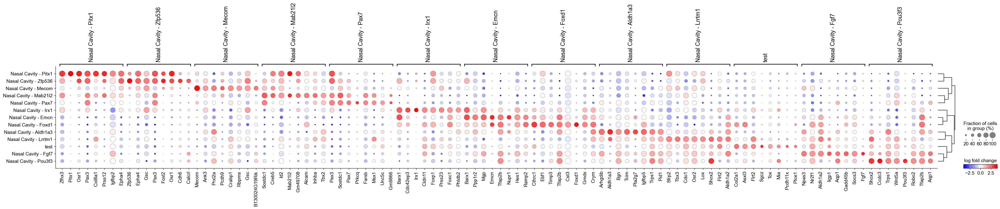

In [523]:
sc.tl.rank_genes_groups(adata_E13_nasal_cavity,groupby = 'E13_mesen_fine_14_2024',
                        method = 't-test_overestim_var',
                        #method = 'wilcoxon',
                       )

sc.tl.dendrogram(adata_E13_nasal_cavity, groupby = 'E13_mesen_fine_14_2024',)
sc.pl.rank_genes_groups_dotplot(adata_E13_nasal_cavity,
                                n_genes=8,
                                values_to_plot="logfoldchanges", cmap='bwr',
    vmin=-4,
    vmax=4,
    min_logfoldchange=1.5,
                                #dendrogram = False,
                                #mean_only_expressed=True,
                               #dot_max = 0.5, 
                                #save = 'automatic.pdf'
                               )

1719226385.287136: Regressing cell cycle
1719226402.01775: Highly Variable Genes
1719226402.147795: PCA
1719226402.16803: Neighbors
1719226406.0560234: MDE and UMAP
1719226408.4307668: Leiden clustering


/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


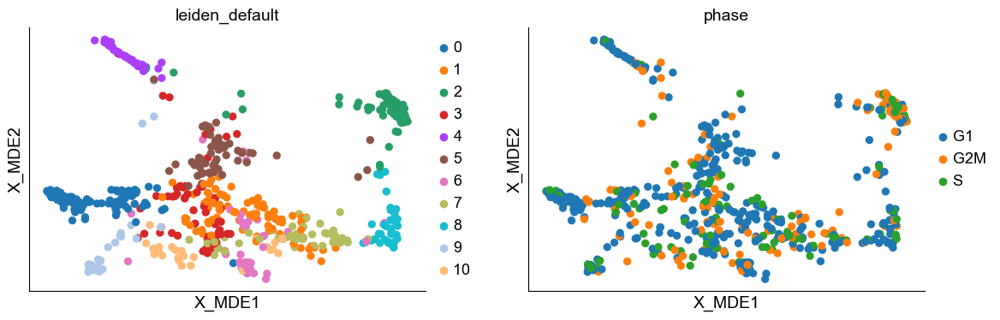

/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


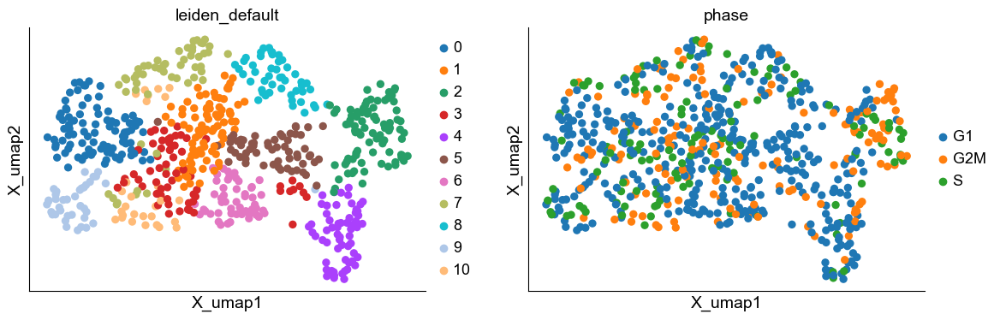

In [12]:
#palate stuff
#time to subset stuff
adata_E13_mesen_filt = adata_E13_mesen_filt_annotated
adata_E13_palate = adata_E13_mesen_filt[adata_E13_mesen_filt.obs['leiden_coarse'].isin(['12'])].copy()
default_regress_cycle_to_mde(adata_E13_palate, n_neighbors = 8,n_comps=20, skip_preprocess = False, resolution = 1,n_top_genes = 1000)

In [13]:
adata_E13_palate.X = adata_E13_palate.layers['original_counts'].copy()
sc.pp.normalize_total(adata_E13_palate, target_sum=1e4)
sc.pp.log1p(adata_E13_palate)

In [14]:
sc.tl.leiden(adata_E13_palate, #name of anndata object
              resolution = .2, key_added = 'leiden_fine') #1
sc.tl.leiden(adata_E13_palate, #name of anndata object
              resolution = 1.1, key_added = 'leiden_fine2')

/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


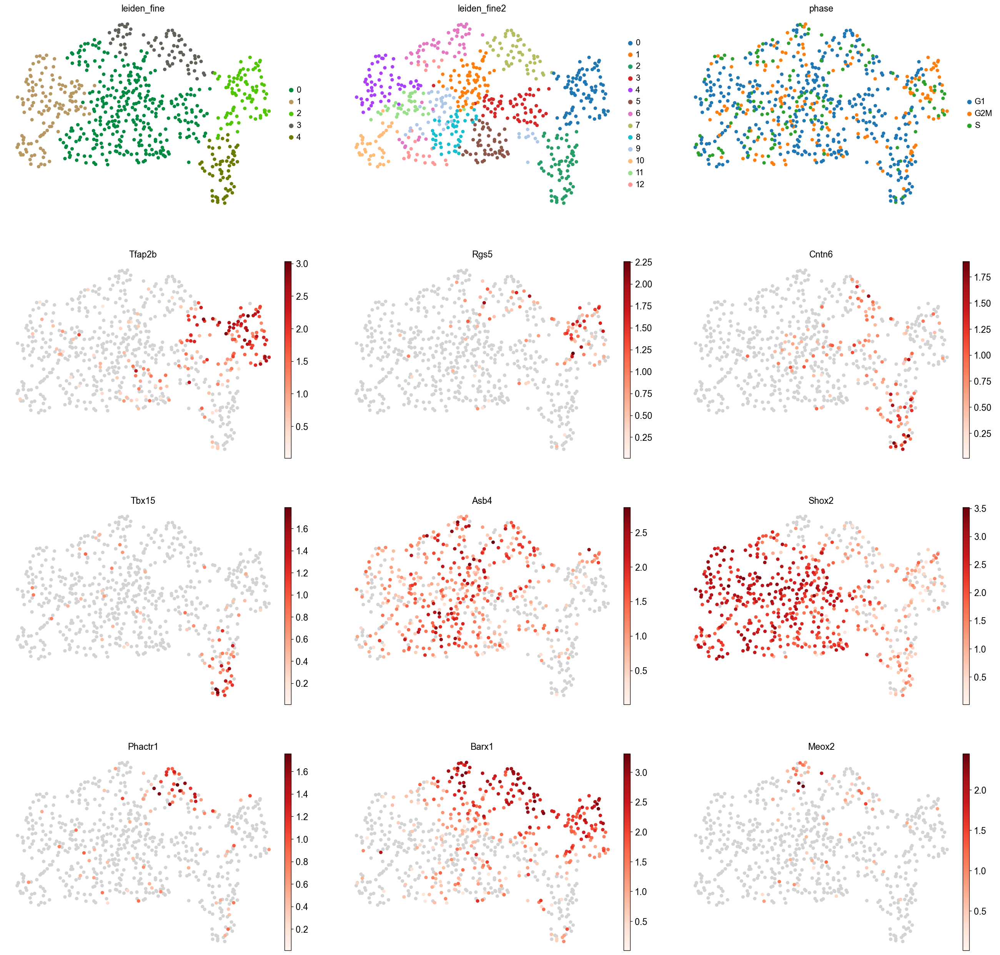

In [15]:
sc.set_figure_params(dpi=60,figsize=[8,6])

sc.pl.embedding(
    adata_E13_palate,
    basis='X_umap',
    color=['leiden_fine','leiden_fine2','phase','Tfap2b','Rgs5','Cntn6','Tbx15','Asb4','Shox2','Phactr1','Barx1','Meox2'],
    #groups=['0'],
    frameon=False,
    ncols=3,
    size = 120,
    cmap = reds,
    vmin=0.01,
)


In [16]:
sc.tl.rank_genes_groups(adata_E13_palate,groupby = 'leiden_fine',
                        method = 't-test_overestim_var',
                        #method = 'wilcoxon',
                       )


/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


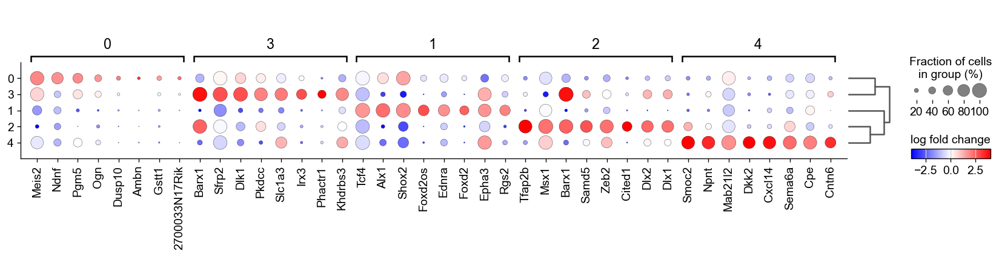

In [17]:
sc.tl.dendrogram(adata_E13_palate, groupby = 'leiden_fine',)
sc.pl.rank_genes_groups_dotplot(adata_E13_palate,
                                n_genes=8,
                                values_to_plot="logfoldchanges", cmap='bwr',
    vmin=-4,
    vmax=4,
    min_logfoldchange=1.5,
                                #dendrogram = False,
                                #mean_only_expressed=True,
                               #dot_max = 0.5, 
                                #save = 'automatic.pdf'
                               )

/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


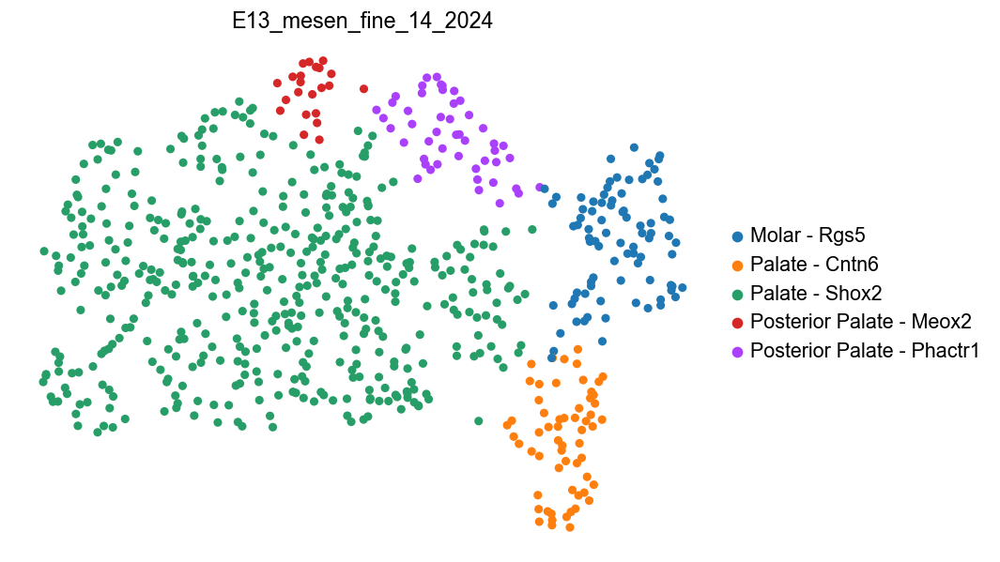

In [19]:
adata_E13_palate.obs['E13_mesen_fine_14_2024'] = 'test'

adata_E13_palate.obs.loc[adata_E13_palate[adata_E13_palate.obs['leiden_fine'] == '0'].obs.index,'E13_mesen_fine_14_2024'] = 'Palate - Shox2' #
adata_E13_palate.obs.loc[adata_E13_palate[adata_E13_palate.obs['leiden_fine'] == '1'].obs.index,'E13_mesen_fine_14_2024'] = 'Palate - Shox2' #
adata_E13_palate.obs.loc[adata_E13_palate[adata_E13_palate.obs['leiden_fine'] == '2'].obs.index,'E13_mesen_fine_14_2024'] = 'Molar - Rgs5' #
adata_E13_palate.obs.loc[adata_E13_palate[adata_E13_palate.obs['leiden_fine'] == '4'].obs.index,'E13_mesen_fine_14_2024'] = 'Palate - Cntn6' #
adata_E13_palate.obs.loc[adata_E13_palate[adata_E13_palate.obs['leiden_fine'] == '3'].obs.index,'E13_mesen_fine_14_2024'] = 'Posterior Palate - Meox2' #

adata_E13_palate.obs.loc[adata_E13_palate[adata_E13_palate.obs['leiden_fine2'] == '7'].obs.index,'E13_mesen_fine_14_2024'] = 'Posterior Palate - Phactr1' #
sc.pl.embedding(
    adata_E13_palate,
    basis='X_umap',
    color=['E13_mesen_fine_14_2024'],
    #groups=['0'],
    frameon=False,
    ncols=3,
    size = 120,
    cmap = reds,
    vmin=0.01,
)


In [20]:
#adata_E13_palate.write('anndata_objects/adata_E13_palate.h5ad')
adata_E13_palate = sc.read('anndata_objects/adata_E13_palate.h5ad')

In [ ]:
plot_deg_embedding(
    #adata = adata_E12_mesen_no_filt[adata_E12_mesen_no_filt.obs['leiden']!='19'], 
    adata = adata_E13_mesen_filt,
                   groupby = 'leiden_mesen2.5', 
                   cluster_name = '37', 
                   n_genes = 100, 
                   method = 'wilcoxon',
                   basis = 'X_umap')

1710153076.5976338: Highly Variable Genes
1710153076.9101675: PCA
1710153076.9759: Neighbors
1710153080.758118: MDE and UMAP
1710153083.9569972: Leiden clustering


/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


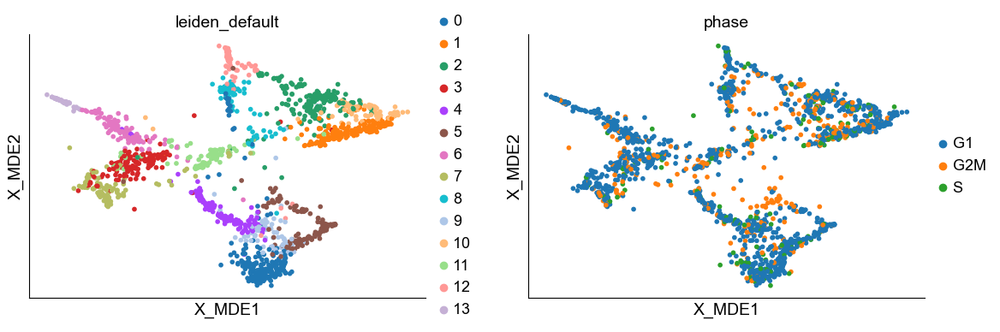

/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


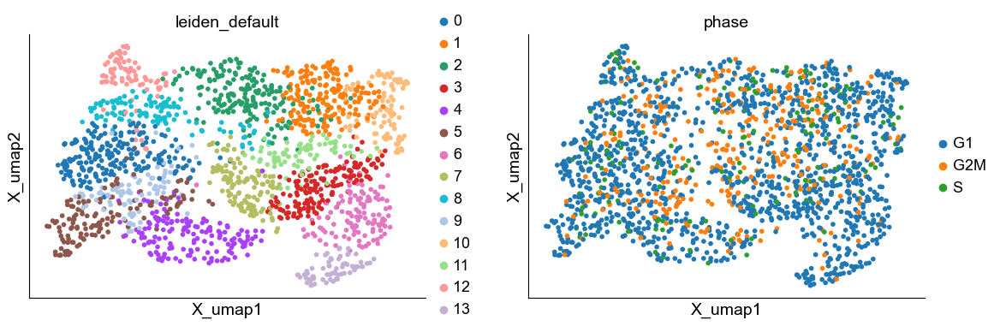

In [12]:
adata_nasal_cavity = adata_E13_mesen_filt[adata_E13_mesen_filt.obs['leiden_default'].isin(['4','11','16','22','23',])].copy()
default_regress_cycle_to_mde(adata_nasal_cavity, n_neighbors = 10,n_comps=40, skip_preprocess = True, resolution = 1,n_top_genes = 2000)

/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


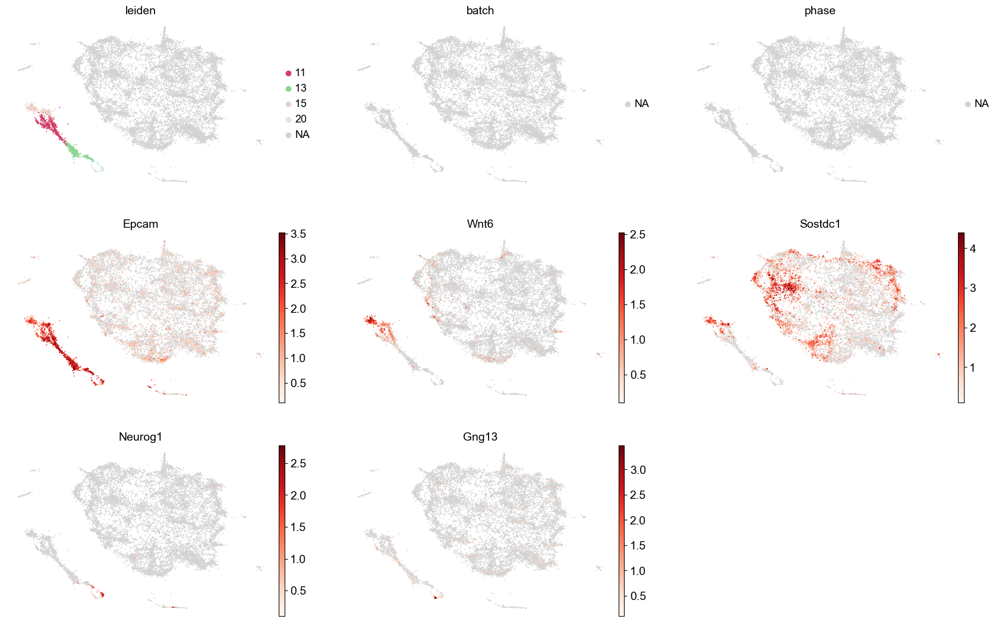

In [9]:
sc.pl.embedding(
    adata_E13,
    basis='X_scvi_MDE',
    color=['leiden','batch','phase','Epcam','Wnt6','Sostdc1','Neurog1','Gng13',],
    groups=['11','13','15','20',],
    frameon=False,
    ncols=3,
    cmap = reds,
    vmin=0.1,
)

1709812849.4465547: Regressing cell cycle
1709812875.3990233: Highly Variable Genes
1709812875.6178799: PCA
1709812875.6626918: Neighbors
1709812876.409875: MDE and UMAP
1709812879.1622252: Leiden clustering


/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


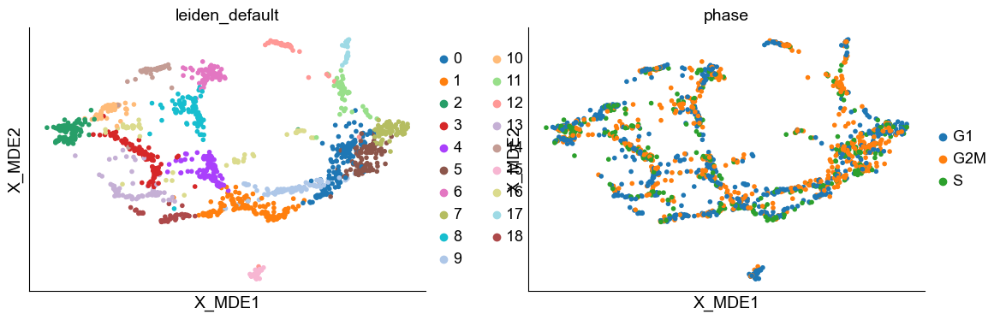

/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


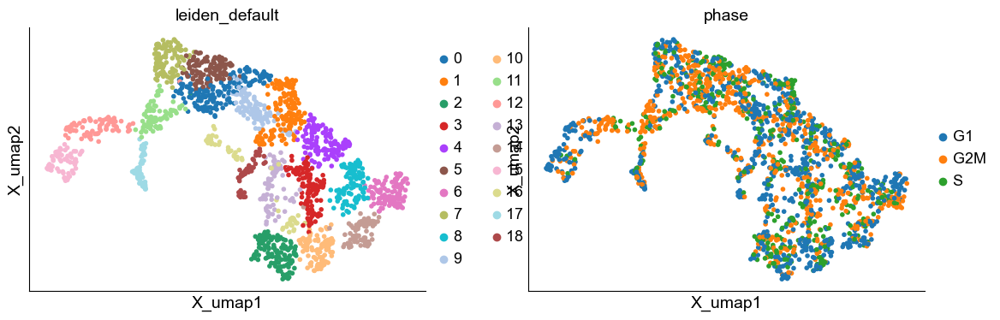

In [44]:
adata_E13_ecto = adata_E13[adata_E13.obs['leiden'].isin(['11','13','15','20'])].copy()
default_regress_cycle_to_mde(adata_E13_ecto, n_neighbors = 15,n_comps=30, skip_preprocess = True, resolution = 1.1,n_top_genes = 3000)



/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


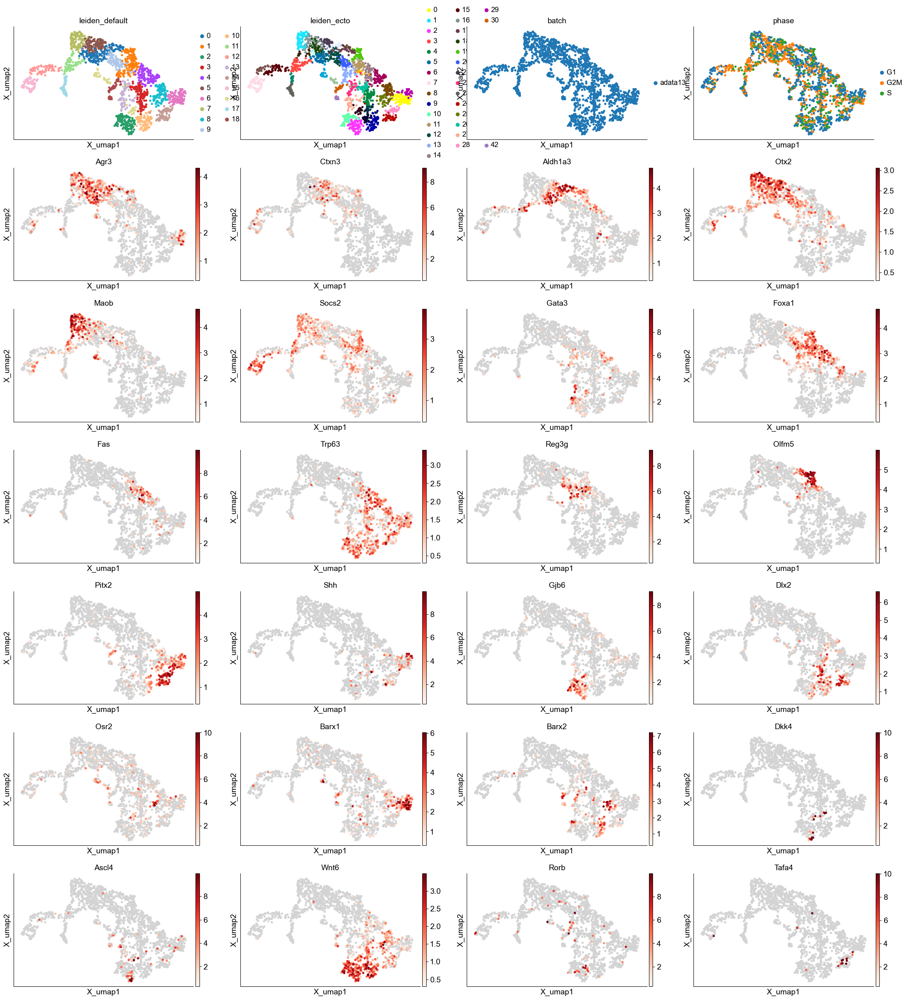

In [66]:
sc.tl.leiden(adata_E13_ecto, resolution = 4, key_added = 'leiden_ecto')
sc.pl.embedding(adata_E13_ecto,
               # basis='X_harmony_MDE',
                basis='X_umap',
                color = ['leiden_default','leiden_ecto','batch','phase',
                         'Agr3','Ctxn3','Aldh1a3','Otx2','Maob','Socs2','Gata3','Foxa1','Fas','Trp63','Reg3g','Olfm5','Pitx2','Shh','Gjb6','Dlx2','Osr2','Barx1','Barx2','Dkk4','Ascl4','Wnt6','Rorb',
                         'Tafa4',],
           ncols=4, cmap=reds, vmin=0.3)

#Fezf2 Vomer
#Ascl4+ whisker, make sure to subcluster from Gjb6+
#Gjb6+ Pou3f1+ doesn't overlap with whisker, subcluster this from Gjb6+
#Dlx2+ cluster 
#Fgf8+ Dlx2+ Wnt5a  olfactory pit rim 
#Barx1 + Shh = Palate; also add foxe1+ barx1- Wnt6+ to palate (Foxe1 Foxa1 meeting point?)
#Dlx2 + Pitx2 = Oral 

#Reg3g + Foxa1 together is respiratory epithelium (
#Olfm5+ Aldh1a3+
#other big Aldh1a3+ Ventral Olf?

#Fas Trp63 Foxa1 Cldn11 Cluster

#2 Krt6a clusters are Periderm
#Maob Pcp4 Cyp2g1 Non neuronal precursor
#Aldh1a3 Maob Ctxn3 Agr3 transition between pcp4 and respiratory?

#'Ascl1','Kit','Insm1' Neuronal progenitors

#Neurog1 Committed neuronal progenitors
#'Fstl5'+,'Gfy'+, 'Gng13- Immature neurons
#'Gng13','Prph','Omp' More mature Neurons

# 'Krt5','Krt14','Krt15','Krt17','Krt19','Krt6a','Krt7','Irx2',
#                          'Dlx1','Dlx2','Rorb','Gjb6','Irx4','Barx1','Pitx2','Fgf8',
#                          'Wnt3','Wnt5a','Wnt7b','Wnt9a','Wnt10a','Wnt10b',
#                          'Pax7','Fgf8','Foxa1','Aldh1a3','Reg3g','Olfm5','Sult1e1','Maob','Pcp4','Krt23',
#                          'Ascl1','Kit','Neurog1','Fstl5','Gfy','Omp','Prph','Gng8','Gng13','Rgs5',
#                          'Agr3','Otx2','Ermn','Pax6','Pou3f1','Gata3','Msx2',


In [102]:
#renaming clusters coarse
adata_E13_ecto.obs['E13_ecto_annotation_coarse'] = 'tmp' #create new column

adata_E13_ecto.obs.loc[adata_E13_ecto[adata_E13_ecto.obs['leiden_default'] == '0'].obs.index,'E13_ecto_annotation_coarse'] = 'Ventral Olfactory Epithelium' #Aldh1a3
adata_E13_ecto.obs.loc[adata_E13_ecto[adata_E13_ecto.obs['leiden_default'] == '1'].obs.index,'E13_ecto_annotation_coarse'] = 'Olfm5' #Olfm5 Serpinb11
adata_E13_ecto.obs.loc[adata_E13_ecto[adata_E13_ecto.obs['leiden_default'] == '2'].obs.index,'E13_ecto_annotation_coarse'] = 'Surface Ectoderm - Gjb6' #Gjb6
adata_E13_ecto.obs.loc[adata_E13_ecto[adata_E13_ecto.obs['leiden_default'] == '3'].obs.index,'E13_ecto_annotation_coarse'] = 'Olfactory Pit Rim' #
adata_E13_ecto.obs.loc[adata_E13_ecto[adata_E13_ecto.obs['leiden_default'] == '4'].obs.index,'E13_ecto_annotation_coarse'] = 'Fas+ Epithelium' #Fas Cldn11 Trp63
adata_E13_ecto.obs.loc[adata_E13_ecto[adata_E13_ecto.obs['leiden_default'] == '5'].obs.index,'E13_ecto_annotation_coarse'] = 'Non-neuronal Progenitors' #Maob/Pcp4low Ctxn3 Pitx1 Cpm ->look at genepaint for cpm
adata_E13_ecto.obs.loc[adata_E13_ecto[adata_E13_ecto.obs['leiden_default'] == '6'].obs.index,'E13_ecto_annotation_coarse'] = 'Palate Epithelium' #Barx1 Shh
adata_E13_ecto.obs.loc[adata_E13_ecto[adata_E13_ecto.obs['leiden_default'] == '7'].obs.index,'E13_ecto_annotation_coarse'] = 'Non-neuronal Progenitors' #Pcp4 Maob
adata_E13_ecto.obs.loc[adata_E13_ecto[adata_E13_ecto.obs['leiden_default'] == '8'].obs.index,'E13_ecto_annotation_coarse'] = 'Palate Epithelium' #
adata_E13_ecto.obs.loc[adata_E13_ecto[adata_E13_ecto.obs['leiden_default'] == '9'].obs.index,'E13_ecto_annotation_coarse'] = 'Respiratory Epithelium' #Reg3g
adata_E13_ecto.obs.loc[adata_E13_ecto[adata_E13_ecto.obs['leiden_default'] == '10'].obs.index,'E13_ecto_annotation_coarse'] = 'Surface Ectoderm - Dlx2' #Dlx2
adata_E13_ecto.obs.loc[adata_E13_ecto[adata_E13_ecto.obs['leiden_default'] == '11'].obs.index,'E13_ecto_annotation_coarse'] = 'Neuronal Progenitors' #Ascl1 Kit
adata_E13_ecto.obs.loc[adata_E13_ecto[adata_E13_ecto.obs['leiden_default'] == '12'].obs.index,'E13_ecto_annotation_coarse'] = 'Committed Neuronal Progenitors' #Neurog1 Neurod1 Fstl5/Gfy-
adata_E13_ecto.obs.loc[adata_E13_ecto[adata_E13_ecto.obs['leiden_default'] == '13'].obs.index,'E13_ecto_annotation_coarse'] = 'Periderm' #Krt6a Rhov Gsta2 Krtdap
adata_E13_ecto.obs.loc[adata_E13_ecto[adata_E13_ecto.obs['leiden_default'] == '14'].obs.index,'E13_ecto_annotation_coarse'] = 'Oral Epithelium' #Pitx2 Shh
adata_E13_ecto.obs.loc[adata_E13_ecto[adata_E13_ecto.obs['leiden_default'] == '15'].obs.index,'E13_ecto_annotation_coarse'] = 'Mature Neurons' #Prph Gng13
adata_E13_ecto.obs.loc[adata_E13_ecto[adata_E13_ecto.obs['leiden_default'] == '16'].obs.index,'E13_ecto_annotation_coarse'] = 'Mesenchyme signature - Remove' #twist and prrx, probably doublets
adata_E13_ecto.obs.loc[adata_E13_ecto[adata_E13_ecto.obs['leiden_default'] == '17'].obs.index,'E13_ecto_annotation_coarse'] = 'Vomeronasal Organ' #Fezf2
adata_E13_ecto.obs.loc[adata_E13_ecto[adata_E13_ecto.obs['leiden_default'] == '18'].obs.index,'E13_ecto_annotation_coarse'] = 'Periderm' #Rhov Krt6a Vgll1

adata_E13_ecto.obs.loc[adata_E13_ecto[adata_E13_ecto.obs['leiden_ecto'] == '33'].obs.index,'E13_ecto_annotation_coarse'] = 'Immature Neurons' #Fstl5/Gfy
adata_E13_ecto.obs.loc[adata_E13_ecto[adata_E13_ecto.obs['leiden_ecto'] == '25'].obs.index,'E13_ecto_annotation_coarse'] = 'Conjunctival Epithelium' #Barx2 Osr2 



adata_E13_ecto.obs['E13_ecto_annotation_coarse'] = adata_E13_ecto.obs['E13_ecto_annotation_coarse'].astype('category')

adata_E13_ecto.obs['E13_ecto_annotation_coarse'] = adata_E13_ecto.obs['E13_ecto_annotation_coarse'].cat.remove_unused_categories() #remove unused categories

In [103]:
adata_E13_ecto.obs['E13_ecto_annotation_fine'] = 'tmp' #create new column

adata_E13_ecto.obs.loc[adata_E13_ecto[adata_E13_ecto.obs['leiden_default'] == '0'].obs.index,'E13_ecto_annotation_fine'] = 'Ventral Olfactory Epithelium' #Aldh1a3
adata_E13_ecto.obs.loc[adata_E13_ecto[adata_E13_ecto.obs['leiden_default'] == '1'].obs.index,'E13_ecto_annotation_fine'] = 'Olfm5' #Olfm5 Serpinb11
adata_E13_ecto.obs.loc[adata_E13_ecto[adata_E13_ecto.obs['leiden_default'] == '2'].obs.index,'E13_ecto_annotation_fine'] = 'Surface Ectoderm - Gjb6' #Gjb6
adata_E13_ecto.obs.loc[adata_E13_ecto[adata_E13_ecto.obs['leiden_default'] == '3'].obs.index,'E13_ecto_annotation_fine'] = 'Olfactory Pit Rim' #
adata_E13_ecto.obs.loc[adata_E13_ecto[adata_E13_ecto.obs['leiden_default'] == '4'].obs.index,'E13_ecto_annotation_fine'] = 'Fas+ Epithelium' #Fas Cldn11 Trp63
adata_E13_ecto.obs.loc[adata_E13_ecto[adata_E13_ecto.obs['leiden_default'] == '5'].obs.index,'E13_ecto_annotation_fine'] = 'Non-neuronal Progenitors - Ctxn3' #Maob/Pcp4low Ctxn3 Pitx1 Cpm ->look at genepaint for cpm
adata_E13_ecto.obs.loc[adata_E13_ecto[adata_E13_ecto.obs['leiden_default'] == '6'].obs.index,'E13_ecto_annotation_fine'] = 'Palate Epithelium' #Barx1 Shh
adata_E13_ecto.obs.loc[adata_E13_ecto[adata_E13_ecto.obs['leiden_default'] == '7'].obs.index,'E13_ecto_annotation_fine'] = 'Non-neuronal Progenitors' #Pcp4 Maob
adata_E13_ecto.obs.loc[adata_E13_ecto[adata_E13_ecto.obs['leiden_default'] == '8'].obs.index,'E13_ecto_annotation_fine'] = 'Palate Epithelium? - Pax1' #Pax1
adata_E13_ecto.obs.loc[adata_E13_ecto[adata_E13_ecto.obs['leiden_default'] == '9'].obs.index,'E13_ecto_annotation_fine'] = 'Respiratory Epithelium' #Reg3g
adata_E13_ecto.obs.loc[adata_E13_ecto[adata_E13_ecto.obs['leiden_default'] == '10'].obs.index,'E13_ecto_annotation_fine'] = 'Surface Ectoderm - Dlx2' #Dlx2
adata_E13_ecto.obs.loc[adata_E13_ecto[adata_E13_ecto.obs['leiden_default'] == '11'].obs.index,'E13_ecto_annotation_fine'] = 'Neuronal Progenitors' #Ascl1 Kit
adata_E13_ecto.obs.loc[adata_E13_ecto[adata_E13_ecto.obs['leiden_default'] == '12'].obs.index,'E13_ecto_annotation_fine'] = 'Committed Neuronal Progenitors' #Neurog1 Neurod1 Fstl5/Gfy-
adata_E13_ecto.obs.loc[adata_E13_ecto[adata_E13_ecto.obs['leiden_default'] == '13'].obs.index,'E13_ecto_annotation_fine'] = 'Periderm' #Krt6a Rhov Gsta2 Krtdap
adata_E13_ecto.obs.loc[adata_E13_ecto[adata_E13_ecto.obs['leiden_default'] == '14'].obs.index,'E13_ecto_annotation_fine'] = 'Oral Epithelium' #Pitx2 Shh
adata_E13_ecto.obs.loc[adata_E13_ecto[adata_E13_ecto.obs['leiden_default'] == '15'].obs.index,'E13_ecto_annotation_fine'] = 'Mature Neurons' #Prph Gng13
adata_E13_ecto.obs.loc[adata_E13_ecto[adata_E13_ecto.obs['leiden_default'] == '16'].obs.index,'E13_ecto_annotation_fine'] = 'Mesenchyme signature - Remove' #twist and prrx, probably doublets
adata_E13_ecto.obs.loc[adata_E13_ecto[adata_E13_ecto.obs['leiden_default'] == '17'].obs.index,'E13_ecto_annotation_fine'] = 'Vomeronasal Organ' #Fezf2
adata_E13_ecto.obs.loc[adata_E13_ecto[adata_E13_ecto.obs['leiden_default'] == '18'].obs.index,'E13_ecto_annotation_fine'] = 'Periderm' #Rhov Krt6a Vgll1

adata_E13_ecto.obs.loc[adata_E13_ecto[adata_E13_ecto.obs['leiden_ecto'] == '33'].obs.index,'E13_ecto_annotation_fine'] = 'Immature Neurons' #Fstl5/Gfy
adata_E13_ecto.obs.loc[adata_E13_ecto[adata_E13_ecto.obs['leiden_ecto'] == '25'].obs.index,'E13_ecto_annotation_fine'] = 'Conjunctival Epithelium' #Barx2 Osr2 



adata_E13_ecto.obs['E13_ecto_annotation_fine'] = adata_E13_ecto.obs['E13_ecto_annotation_fine'].astype('category')

adata_E13_ecto.obs['E13_ecto_annotation_fine'] = adata_E13_ecto.obs['E13_ecto_annotation_fine'].cat.remove_unused_categories() #remove unused categories

In [105]:
adata_E13_ecto.write('anndata_objects/adata_E13_ecto_annotated.h5ad')